#### Load packages

In [7]:
library(Biobase)
library(GEOquery)
library(limma)
library(repr)
library(edgeR)
library(preprocessCore)
library(MetaIntegrator)
library(org.Hs.eg.db)
library(Jmisc)
library(biomaRt)

#### Paramter setting

In [11]:
#Specify the place to store normalized gene expression data
norm_exp_data <- "../working-folder/normalized-data/"
dir.create(norm_exp_data, showWarnings = FALSE)
#Specify directory for where to store differential expression data
diff_exp_data <- "../working-folder/diff-gene-expression/"
dir.create(diff_exp_data, showWarnings = FALSE)
#rnaseq raw data
rnaseq_data <- "../../../sra/bulk-rnaseq-datasets/"
#Load the self-defined functions
sourceAll('fun/R')
#Assign Vroom connection buffer size allowing getGEO to process large data 
Sys.setenv("VROOM_CONNECTION_SIZE" = 524288 * 2)
#Record dataset and its groups
dsets <- data.frame()

Loading...
  fun/R/aliasMapping.R 
  fun/R/array_normalize.r 
  fun/R/array_process_qc_alt.R 
  fun/R/array_process_qc.R 
  fun/R/dataset_info.R 
  fun/R/diff_exp_array_analysis.R 
  fun/R/diff_exp_seq_analysis.R 
  fun/R/draw_boxplot.R 
  fun/R/ensembl2genesymbol.R 
  fun/R/geneLength.r 
  fun/R/geo_process.R 
  fun/R/idsmap.r 
  fun/R/probe2genesymbol.R 
  fun/R/seq_process_qc.R 
  fun/R/UniqueGene_probe.r 
Done


In [12]:
sessionInfo()

R version 4.0.3 (2020-10-10)
Platform: x86_64-conda-linux-gnu (64-bit)
Running under: Amazon Linux 2

Matrix products: default
BLAS/LAPACK: /shared/software/anaconda3/envs/tb-gene-signature-update/lib/libopenblasp-r0.3.18.so

locale:
 [1] LC_CTYPE=en_US.UTF-8       LC_NUMERIC=C              
 [3] LC_TIME=en_US.UTF-8        LC_COLLATE=en_US.UTF-8    
 [5] LC_MONETARY=en_US.UTF-8    LC_MESSAGES=en_US.UTF-8   
 [7] LC_PAPER=en_US.UTF-8       LC_NAME=C                 
 [9] LC_ADDRESS=C               LC_TELEPHONE=C            
[11] LC_MEASUREMENT=en_US.UTF-8 LC_IDENTIFICATION=C       

attached base packages:
[1] stats4    parallel  stats     graphics  grDevices utils     datasets 
[8] methods   base     

other attached packages:
 [1] viridis_0.6.2         viridisLite_0.4.0     biomaRt_2.46.3       
 [4] Jmisc_0.3.1           org.Hs.eg.db_3.12.0   AnnotationDbi_1.52.0 
 [7] IRanges_2.24.1        S4Vectors_0.28.1      MetaIntegrator_2.1.3 
[10] preprocessCore_1.55.2 edgeR_3.32.1          r

## [1] **Microarray Data**

##### Dataset 1 -- GSE19439: Blood Transcriptional Profiles in Active and Latent Tuberculosis UK (microarray, GPL6947)
- Subjects: 42 
- Disease status: PTB (Active Pulmonary TB) (n=13), Latent (n=17), Control (BCG+)(n=6), Control (BCG-)(n=6)
- Disease status definition: PTB-isolation of Mycobacterium Tuberculosis on culture of sputum or bronchoalvelolar lavage fluid. Latent-positive by tuberculin skin test (>14mm if BCG vaccinated, >5mm if not vaccinated) and were also positive by Interferon-Gamma Release assay(IGRA). Control :negative for both assays.

Found 1 file(s)

GSE19439_series_matrix.txt.gz

Using locally cached version: /tmp/Rtmph8pCbI/GSE19439_series_matrix.txt.gz

Rows: 48791 Columns: 43

── Column specification ────────────────────────────────────────────────────────
Delimiter: "\t"
chr  (1): ID_REF
dbl (42): GSM484448, GSM484449, GSM484450, GSM484451, GSM484452, GSM484453, ...


ℹ Use `spec()` to retrieve the full column specification for this data.
ℹ Specify the column types or set `show_col_types = FALSE` to quiet this message.

Using locally cached version of GPL6947 found here:
/tmp/Rtmph8pCbI/GPL6947.soft 

Warning message:
“One or more parsing issues, see `problems()` for details”


         Length Class  Mode
GSE19439 1      -none- list
[1] "GSE19439_series_matrix.txt.gz"


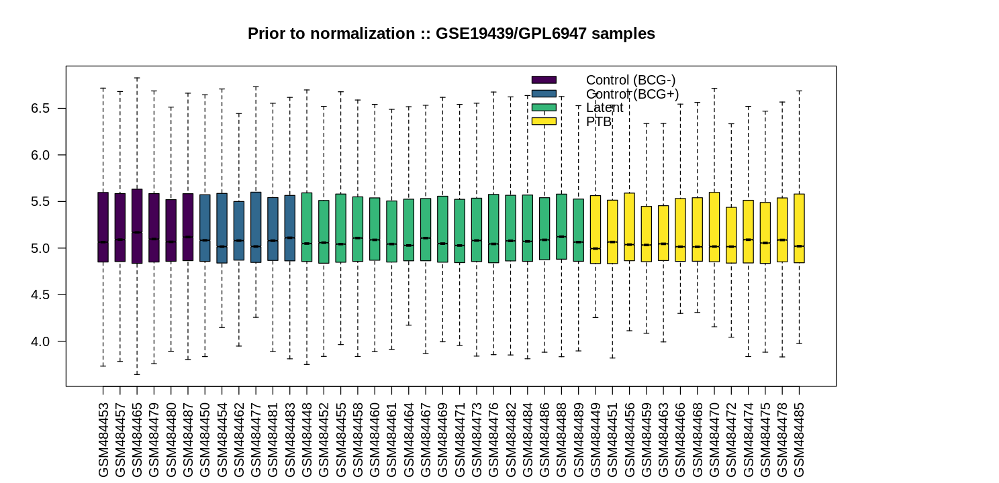

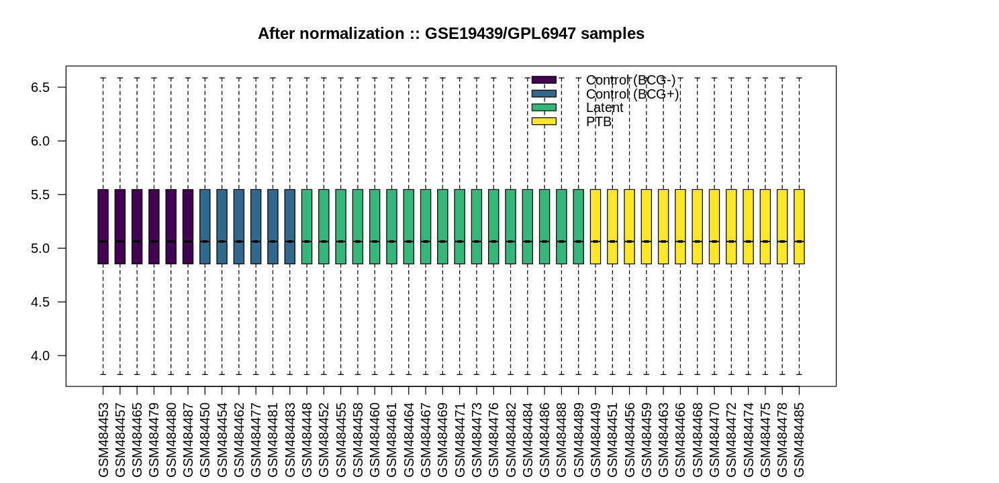

In [140]:
GSE_ID <- "GSE19439"
def <- dataset_info(GSE_ID)
#Fetch and process data
data <- array_process_qc(GSE_ID, def$stage, norm_exp_data, TRUE)

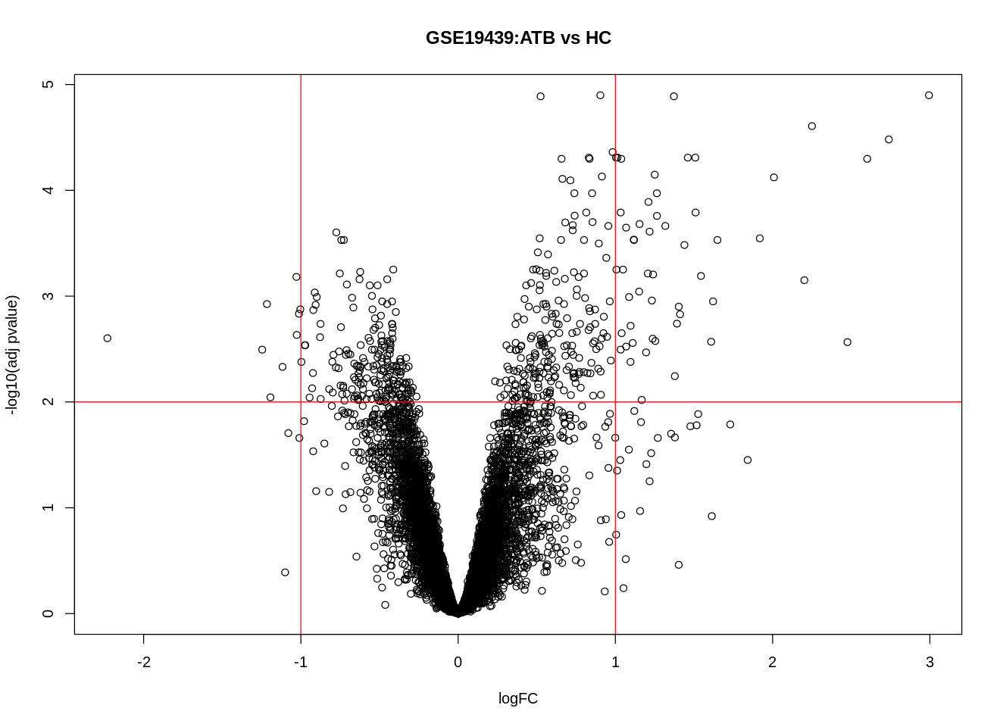

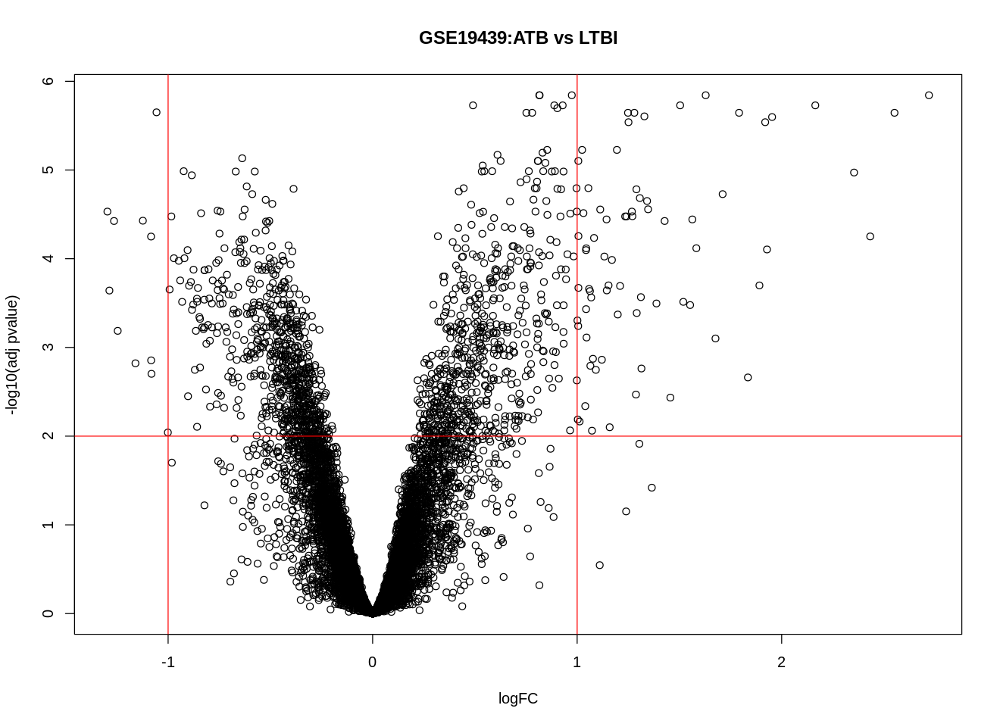

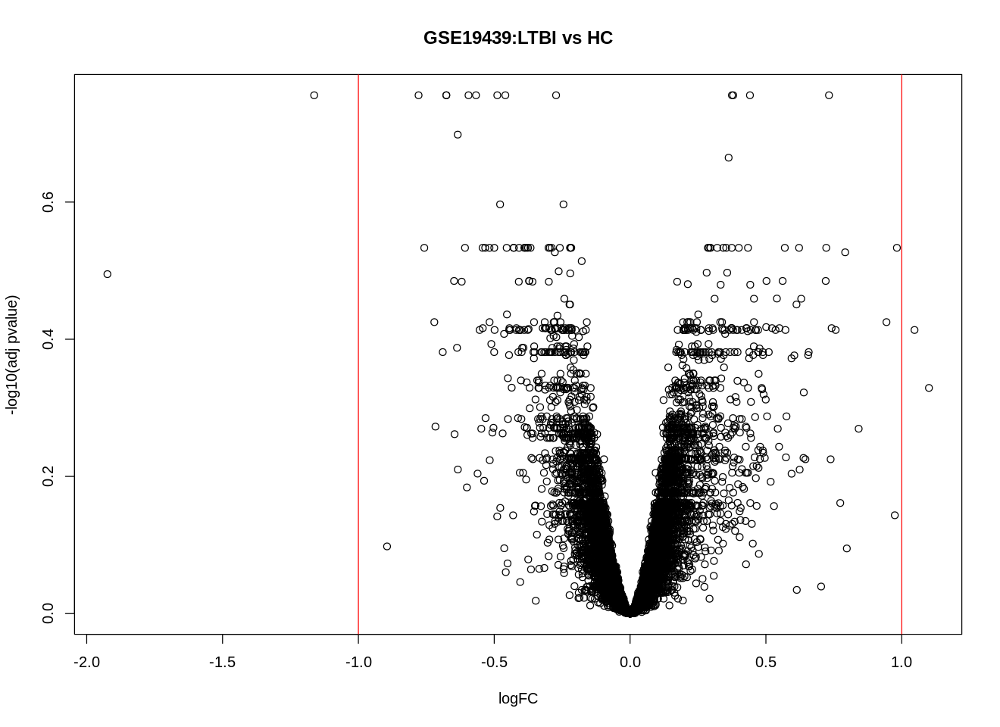

In [141]:
# Perform differential gene expression analysis
df <- diff_exp_array_analysis(GSE_ID, data, def, diff_exp_data, norm_exp_data)
dsets <- rbind(dsets,df$dsets)

##### Dataset 2 -- GSE19442:	Blood Transcriptional Profiles of TB in South Africa (microarray, GPL6947)
- Subjects: 51 
- Disease status: PTB (n=20), LATENT TB (n=31)
- Disease status definition: same as GSE19439

Found 1 file(s)

GSE19442_series_matrix.txt.gz

Using locally cached version: /tmp/Rtmph8pCbI/GSE19442_series_matrix.txt.gz

Rows: 48803 Columns: 52

── Column specification ────────────────────────────────────────────────────────
Delimiter: "\t"
chr  (1): ID_REF
dbl (51): GSM484500, GSM484501, GSM484502, GSM484503, GSM484504, GSM484505, ...


ℹ Use `spec()` to retrieve the full column specification for this data.
ℹ Specify the column types or set `show_col_types = FALSE` to quiet this message.

Using locally cached version of GPL6947 found here:
/tmp/Rtmph8pCbI/GPL6947.soft 

Warning message:
“One or more parsing issues, see `problems()` for details”


         Length Class  Mode
GSE19442 1      -none- list
[1] "GSE19442_series_matrix.txt.gz"


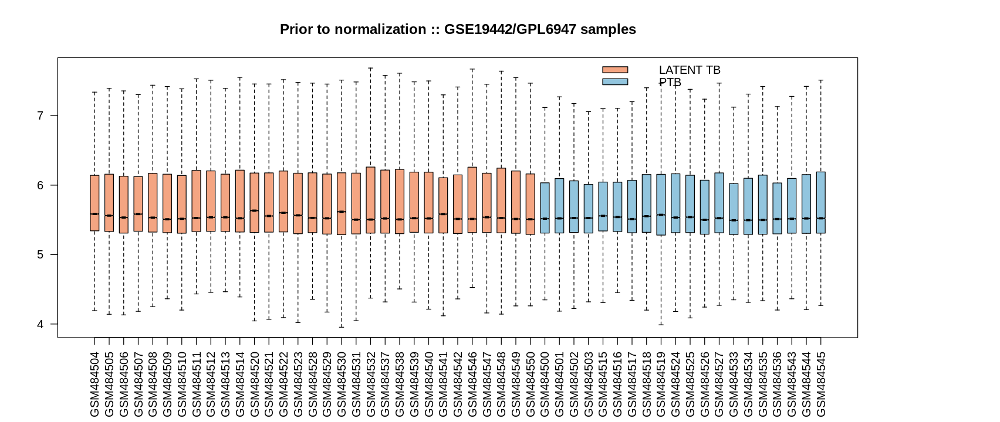

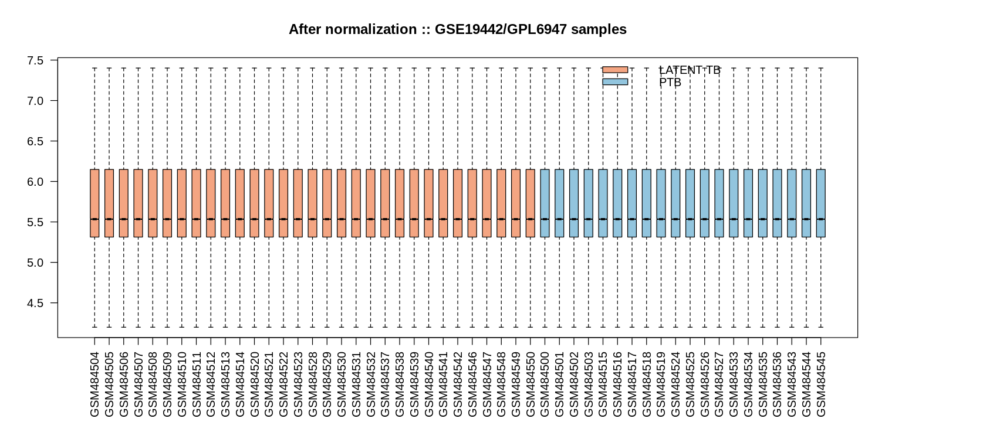

In [142]:
GSE_ID <- "GSE19442"
def <- dataset_info(GSE_ID)
#Fetch and process data
data <- array_process_qc(GSE_ID, def$stage, norm_exp_data, TRUE)

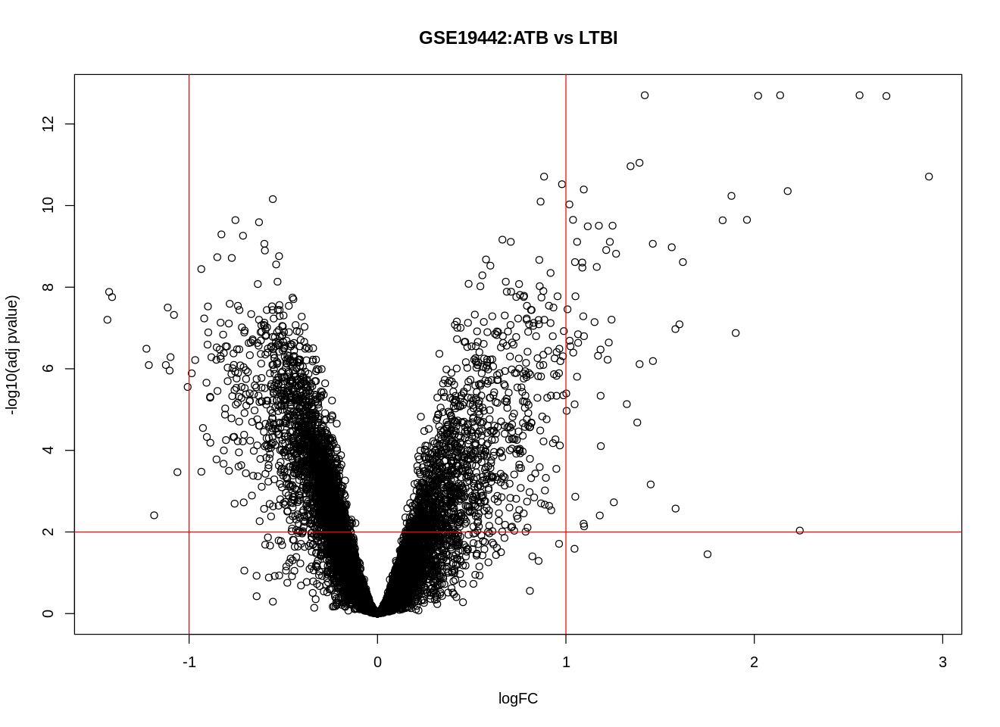

In [143]:
# Perform differential gene expression analysis
df <- diff_exp_array_analysis(GSE_ID, data, def, diff_exp_data, norm_exp_data)
dsets <- rbind(dsets,df$dsets)

##### Dataset 3 -- GSE19444: Blood Transcriptional Profiles of Active and Latent TB UK (microarray, GPL6947)
- Subjects: 54
- Disease status: PTB (n=21), Latent (n=21), Control (BCG+) (n=12)
- Disease status definition: same as GSE19439

Found 1 file(s)

GSE19444_series_matrix.txt.gz

Using locally cached version: /tmp/Rtmph8pCbI/GSE19444_series_matrix.txt.gz

Rows: 48803 Columns: 55

── Column specification ────────────────────────────────────────────────────────
Delimiter: "\t"
chr  (1): ID_REF
dbl (54): GSM484595, GSM484596, GSM484597, GSM484598, GSM484599, GSM484600, ...


ℹ Use `spec()` to retrieve the full column specification for this data.
ℹ Specify the column types or set `show_col_types = FALSE` to quiet this message.

Using locally cached version of GPL6947 found here:
/tmp/Rtmph8pCbI/GPL6947.soft 

Warning message:
“One or more parsing issues, see `problems()` for details”


         Length Class  Mode
GSE19444 1      -none- list
[1] "GSE19444_series_matrix.txt.gz"


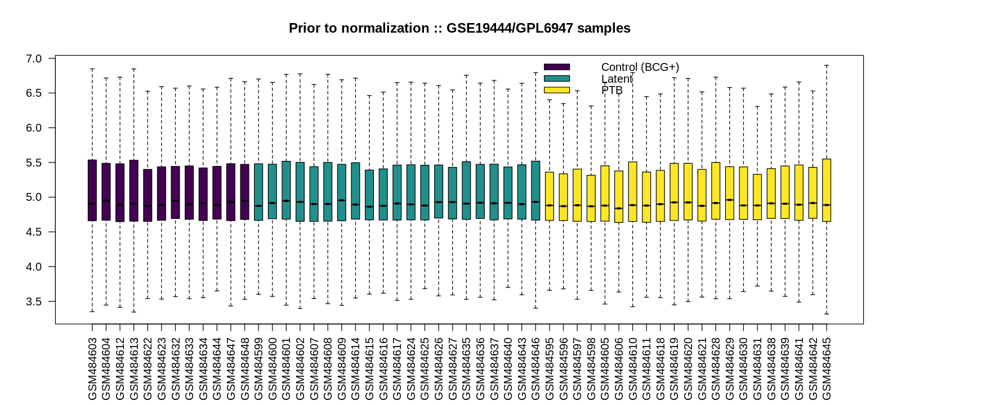

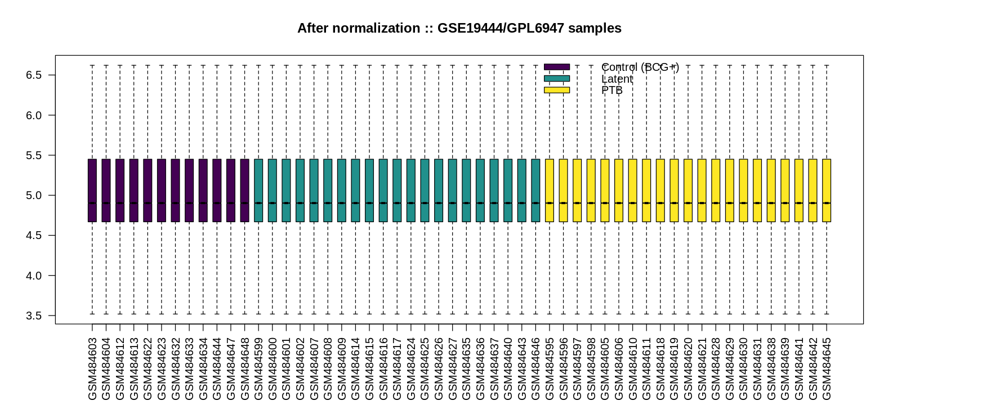

In [144]:
GSE_ID <- "GSE19444"
def <- dataset_info(GSE_ID)
#Fetch and process data
data <- array_process_qc(GSE_ID, def$stage, norm_exp_data, TRUE)

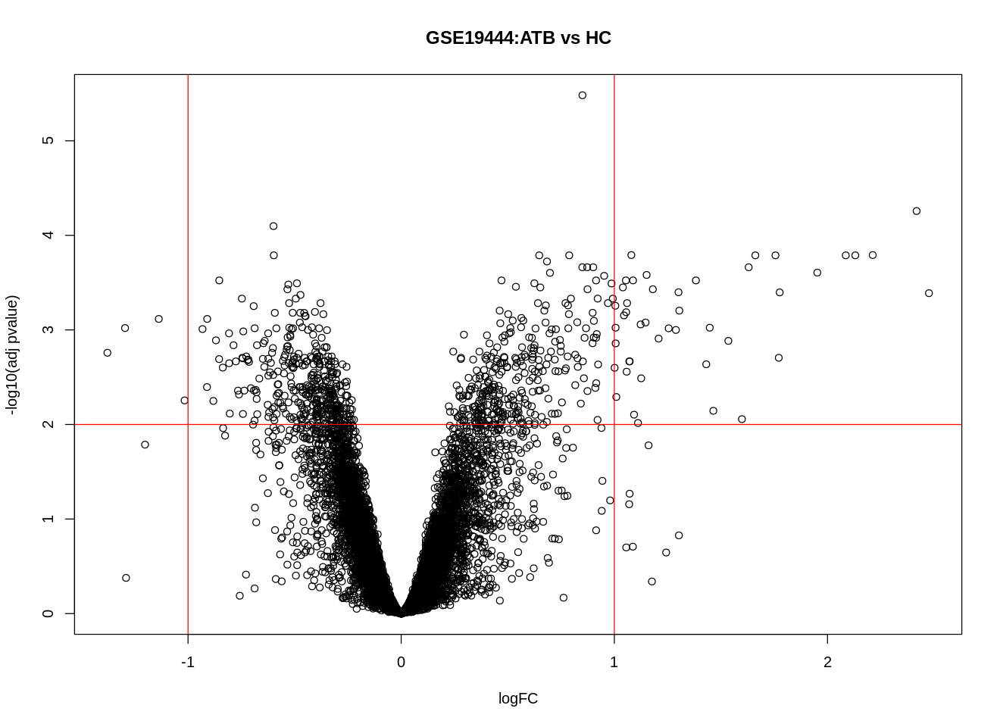

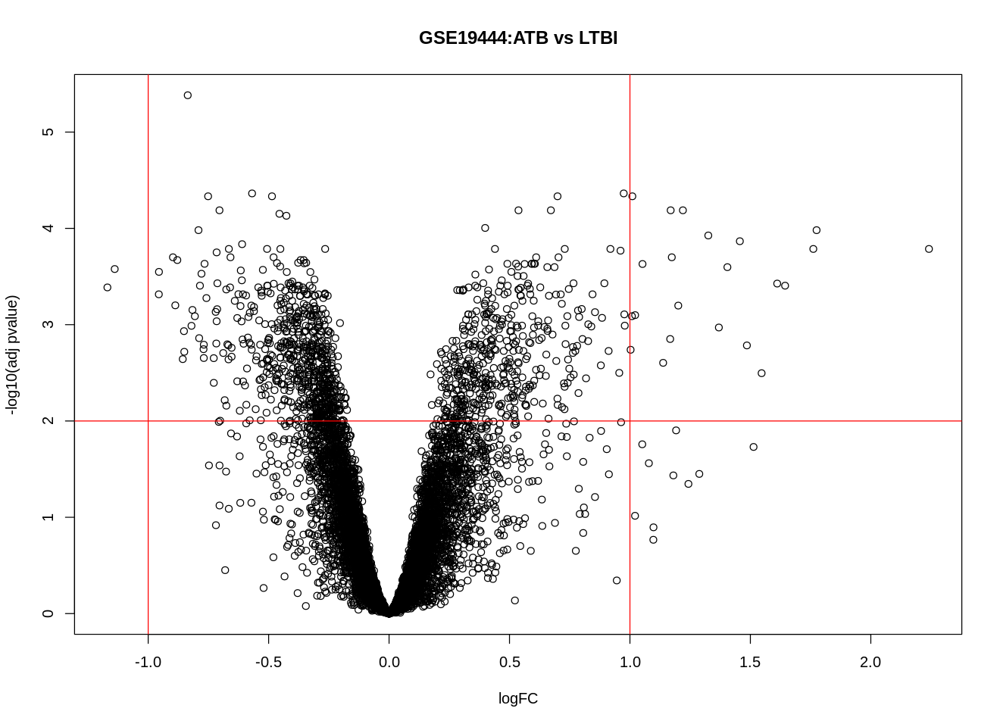

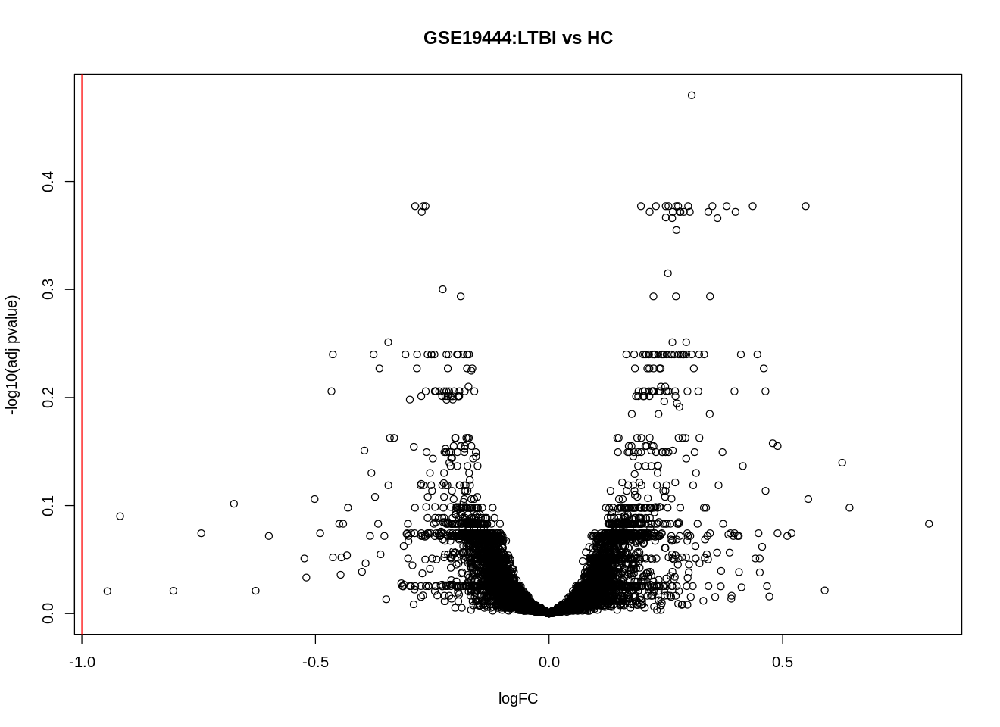

In [145]:
# Perform differential gene expression analysis
df <- diff_exp_array_analysis(GSE_ID, data, def, diff_exp_data, norm_exp_data)
dsets <- rbind(dsets,df$dsets)

##### Dataset 4 -- GSE22098:	Whole blood transcriptional profiles of patients with active tuberculosis (TB) and other inflammatory and infectious diseases (microarray, GPL6947)
- Subjects: 274
- Disease status: Still (still’s disease)(n=31), ASLE (adult systemic lupus erythematosus)(n=28), PSLE (pediatric systemic lupus erythematosus)(n=82), Staph (pediatric staphylococcus)(n=40), Strep (pediatric streptococcus)(n=12), NA (healthy control)(n=81)
- Disease status definition: same as GSE19439

Found 1 file(s)

GSE22098_series_matrix.txt.gz

Using locally cached version: /tmp/Rtmph8pCbI/GSE22098_series_matrix.txt.gz

Rows: 48803 Columns: 275

── Column specification ────────────────────────────────────────────────────────
Delimiter: "\t"
chr   (1): ID_REF
dbl (274): GSM549324, GSM549325, GSM549326, GSM549327, GSM549328, GSM549329,...


ℹ Use `spec()` to retrieve the full column specification for this data.
ℹ Specify the column types or set `show_col_types = FALSE` to quiet this message.

Using locally cached version of GPL6947 found here:
/tmp/Rtmph8pCbI/GPL6947.soft 

Warning message:
“One or more parsing issues, see `problems()` for details”


         Length Class  Mode
GSE22098 1      -none- list
[1] "GSE22098_series_matrix.txt.gz"


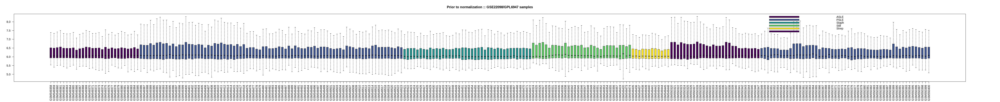

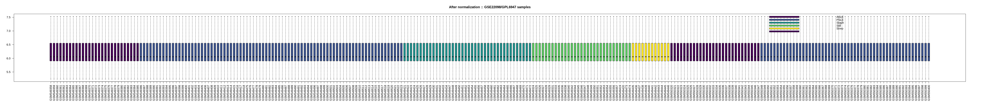

In [146]:
GSE_ID <- "GSE22098"
def <- dataset_info(GSE_ID)
#Fetch and process data
data <- array_process_qc(GSE_ID, def$stage, norm_exp_data, TRUE)

In [147]:
# Perform differential gene expression analysis
df <- diff_exp_array_analysis(GSE_ID, data, def, diff_exp_data, norm_exp_data)
dsets <- rbind(dsets,df$dsets)

##### Dataset 5 -- GSE28623: The Gambia, West Africa (microarray, GPL4133)
- Subjects: 108
- Disease status: TB (n=46), LTBI(skin test >= 10mm)(n=25), NID(skin test = 0mm)(n=37)
- Disease status definition: TB patients showed sputum smear and chest x-ray positive. LTBI with Mantoux test induration (skin test) >= 10mm. Control with Mantoux test induration (skin test) = 0mm

Found 1 file(s)

GSE28623_series_matrix.txt.gz

Using locally cached version: /tmp/Rtmph8pCbI/GSE28623_series_matrix.txt.gz

Rows: 45015 Columns: 109

── Column specification ────────────────────────────────────────────────────────
Delimiter: "\t"
dbl (109): ID_REF, GSM709413, GSM709414, GSM709415, GSM709416, GSM709417, GS...


ℹ Use `spec()` to retrieve the full column specification for this data.
ℹ Specify the column types or set `show_col_types = FALSE` to quiet this message.

Using locally cached version of GPL4133 found here:
/tmp/Rtmph8pCbI/GPL4133.soft 

Warning message:
“One or more parsing issues, see `problems()` for details”


         Length Class  Mode
GSE28623 1      -none- list
[1] "GSE28623_series_matrix.txt.gz"


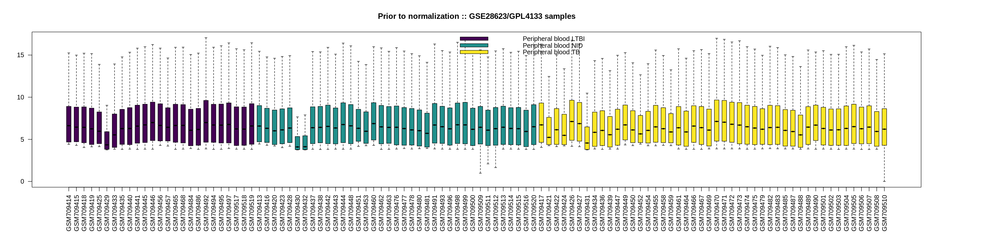

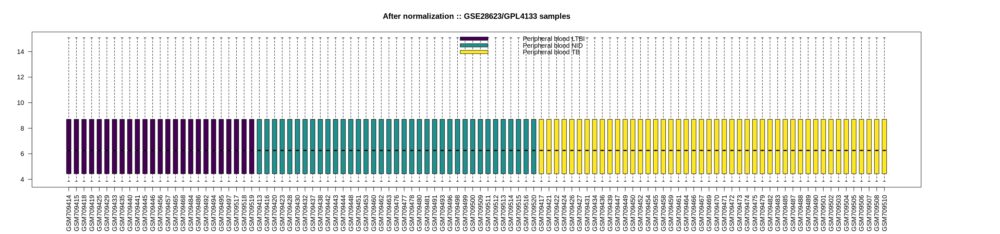

In [148]:
GSE_ID <- "GSE28623"
def <- dataset_info(GSE_ID)
#Fetch and process data
data <- array_process_qc(GSE_ID, def$stage, norm_exp_data, TRUE)

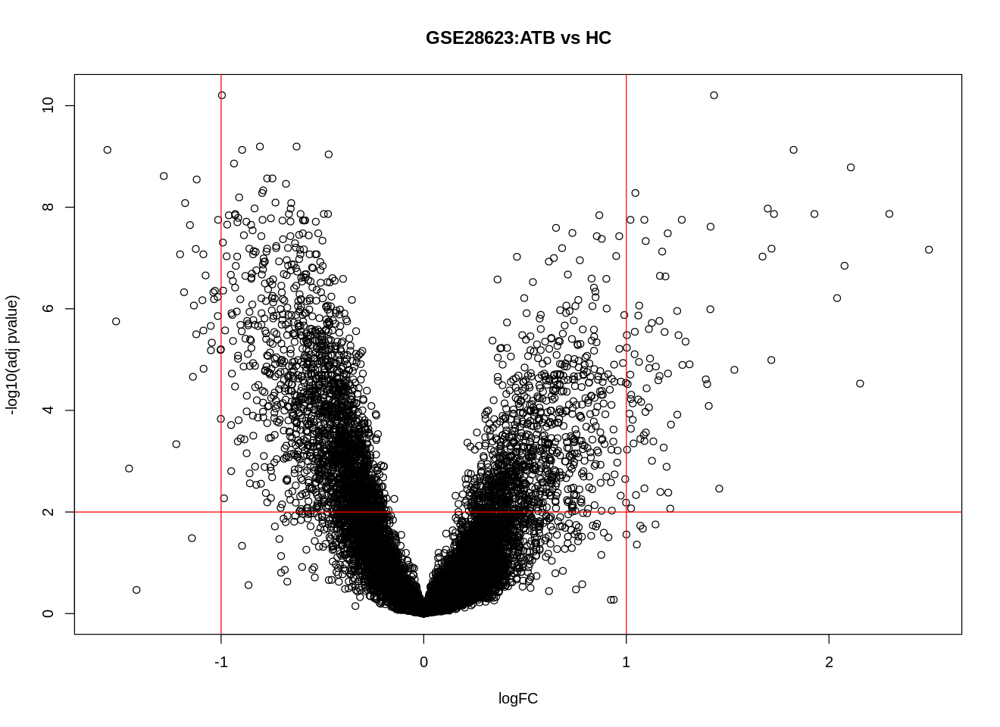

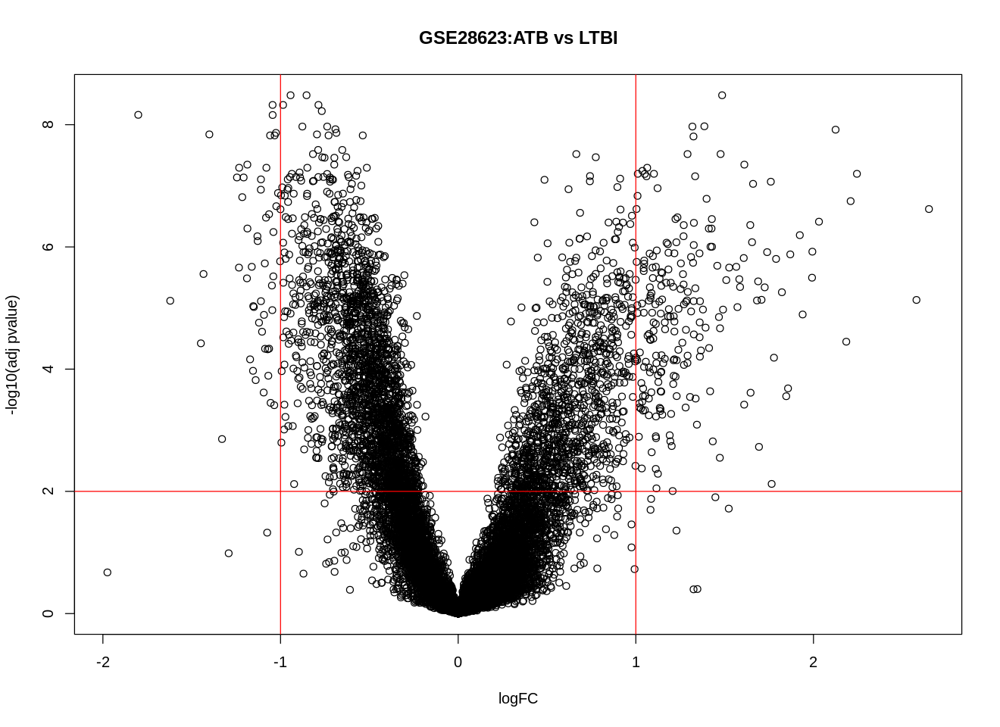

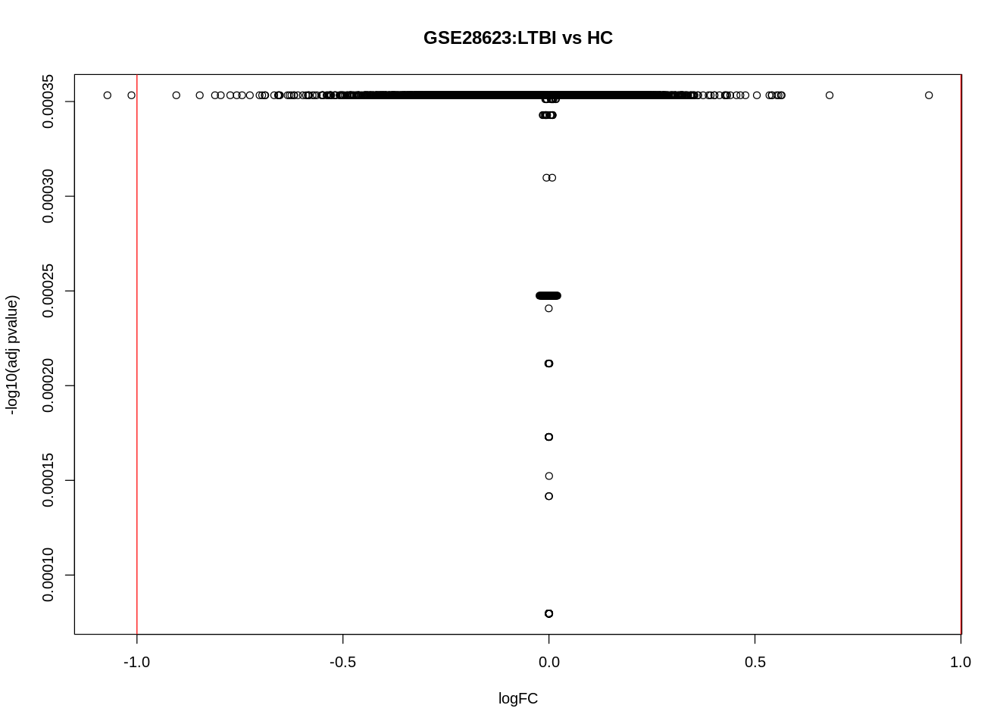

In [149]:
# Perform differential gene expression analysis
df <- diff_exp_array_analysis(GSE_ID, data, def, diff_exp_data, norm_exp_data)
dsets <- rbind(dsets,df$dsets)

##### Dataset 6 -- GSE29536: UK, different diseases (microarray, GPL6102)
- Subjects:260
- Disease status: PTB (Active Pulmonary TB) (n=9), SOJIA (Systemic onset Juvenile Idiopathic Arthritis) (n=67), SLE(systemic lupus erythematosus) (n=96), Transplant ACR (liver transplant) (n=8), Patient (B-cell deficiency) (n=10), melioidosis (n=22),  Other infection (n=8), AHI Enrollment (HIV) (n=9)
- Disease status definition: HIV, tuberculosis, sepsis, systemic lupus erythematosus, systemic arthritis, B-cell deficiency and liver transplant.

Found 1 file(s)

GSE29536_series_matrix.txt.gz

Using locally cached version: /tmp/Rtmph8pCbI/GSE29536_series_matrix.txt.gz

Rows: 48687 Columns: 411

── Column specification ────────────────────────────────────────────────────────
Delimiter: "\t"
chr   (1): ID_REF
dbl (410): GSM730831, GSM730832, GSM730833, GSM730834, GSM730835, GSM730836,...


ℹ Use `spec()` to retrieve the full column specification for this data.
ℹ Specify the column types or set `show_col_types = FALSE` to quiet this message.

Using locally cached version of GPL6102 found here:
/tmp/Rtmph8pCbI/GPL6102.soft 

Warning message:
“One or more parsing issues, see `problems()` for details”


         Length Class  Mode
GSE29536 1      -none- list
[1] "GSE29536_series_matrix.txt.gz"


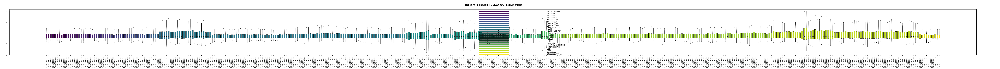

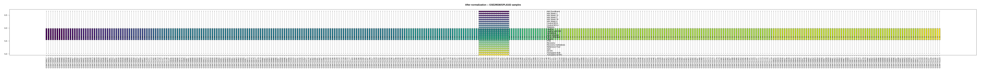

In [150]:
GSE_ID <- "GSE29536"
def <- dataset_info(GSE_ID)
#Fetch and process data
data <- array_process_qc(GSE_ID, def$stage, norm_exp_data, TRUE)

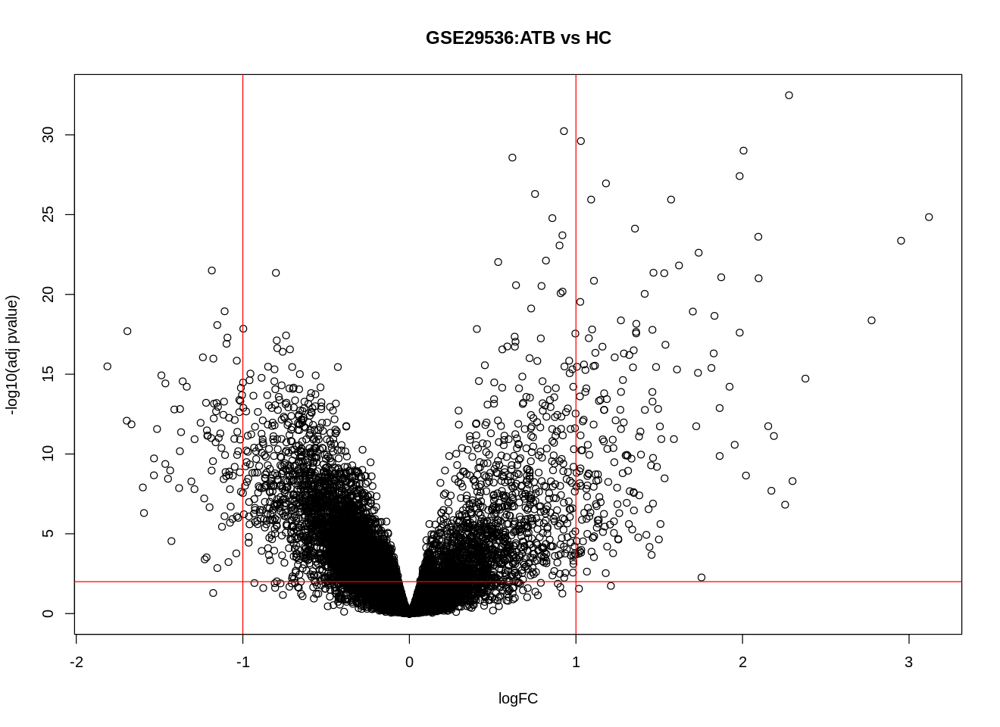

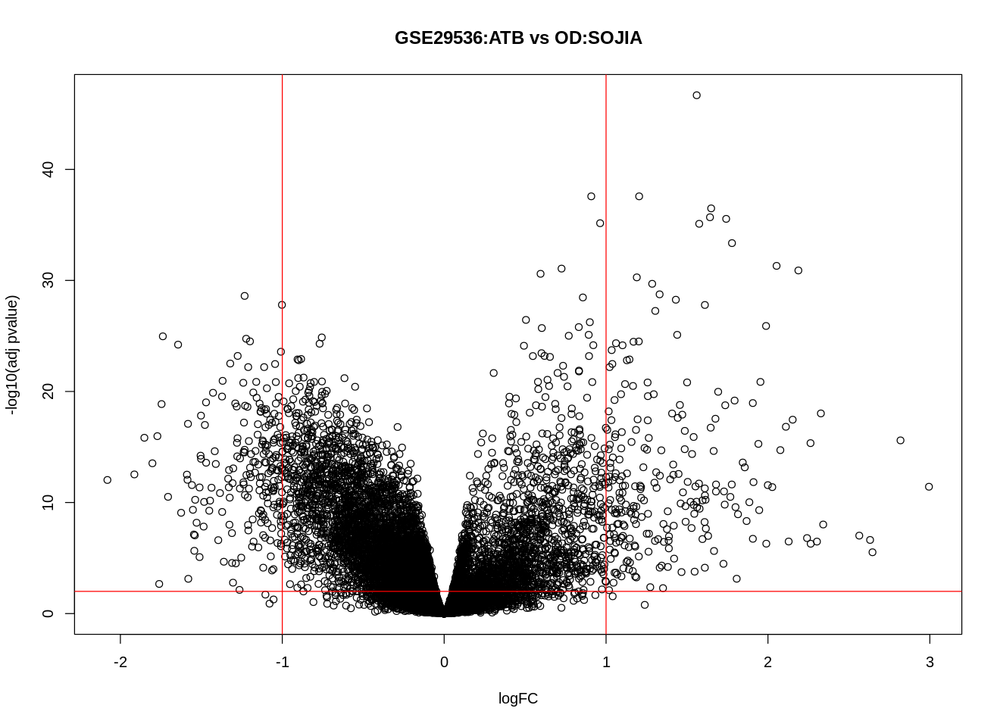

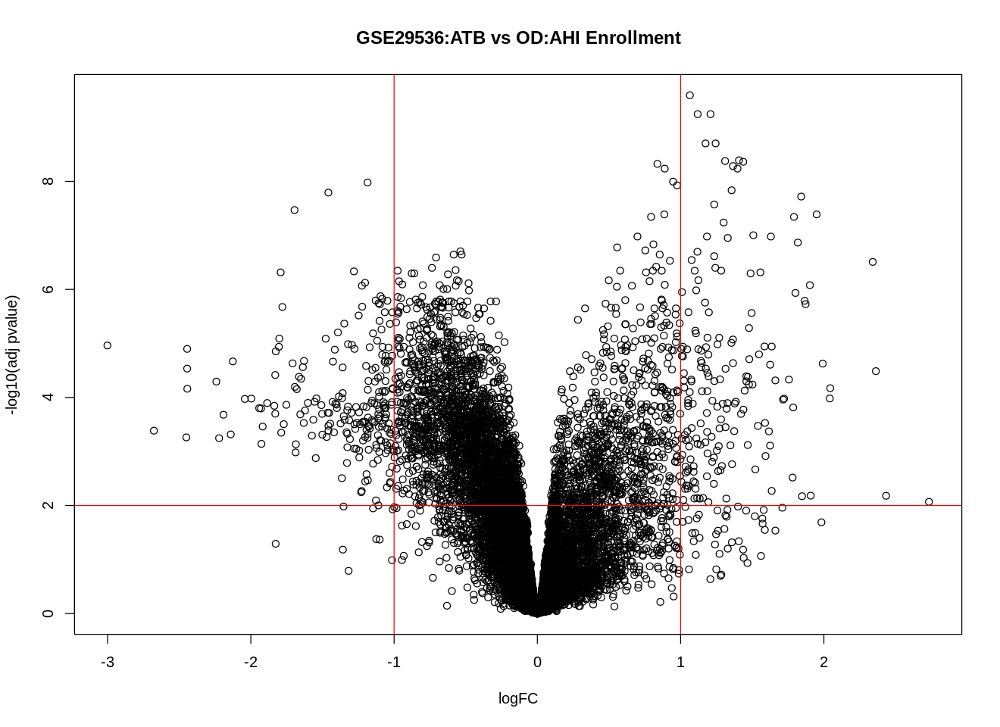

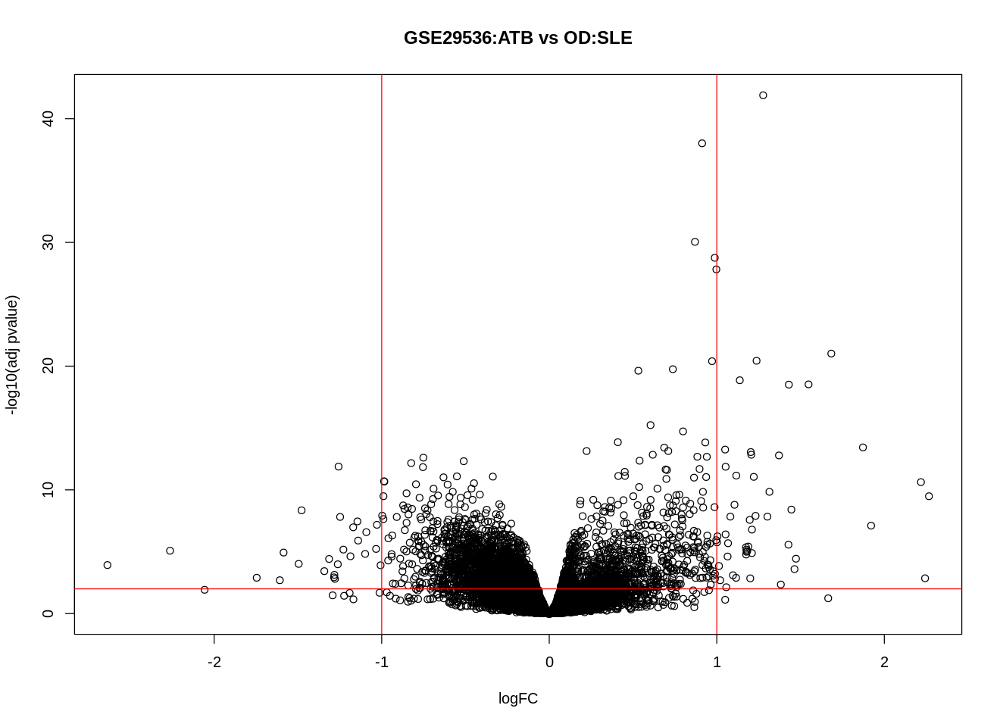

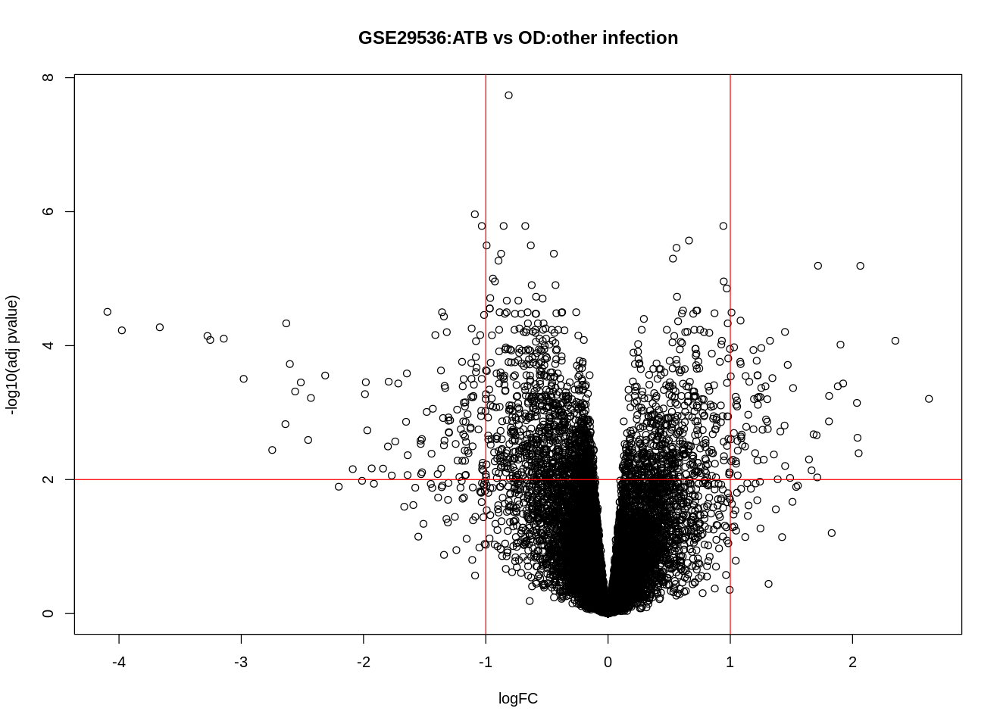

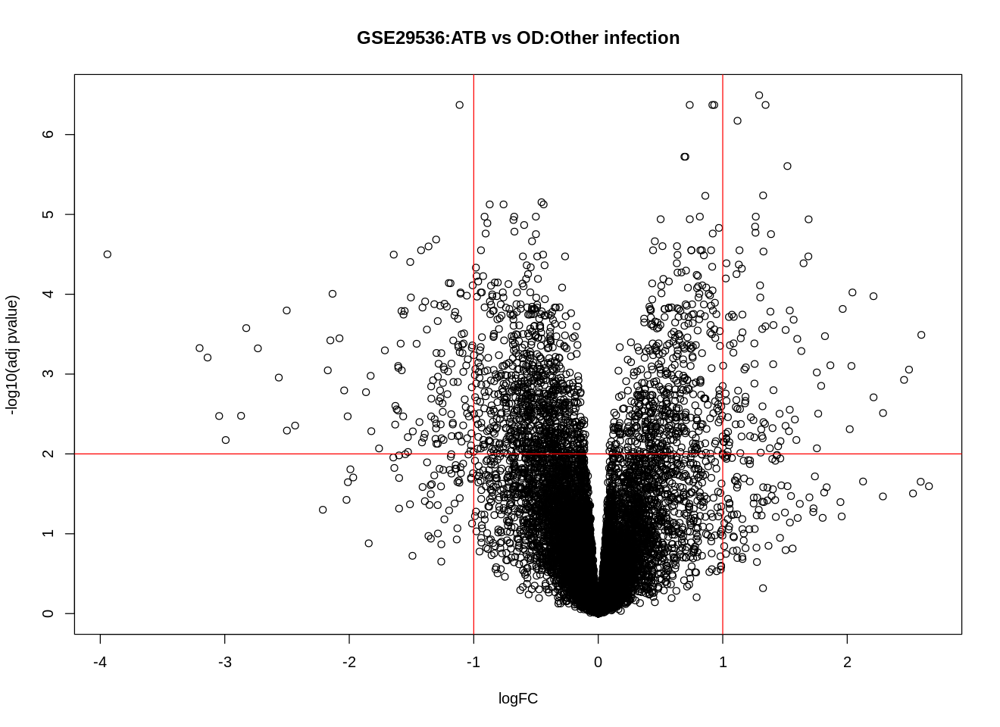

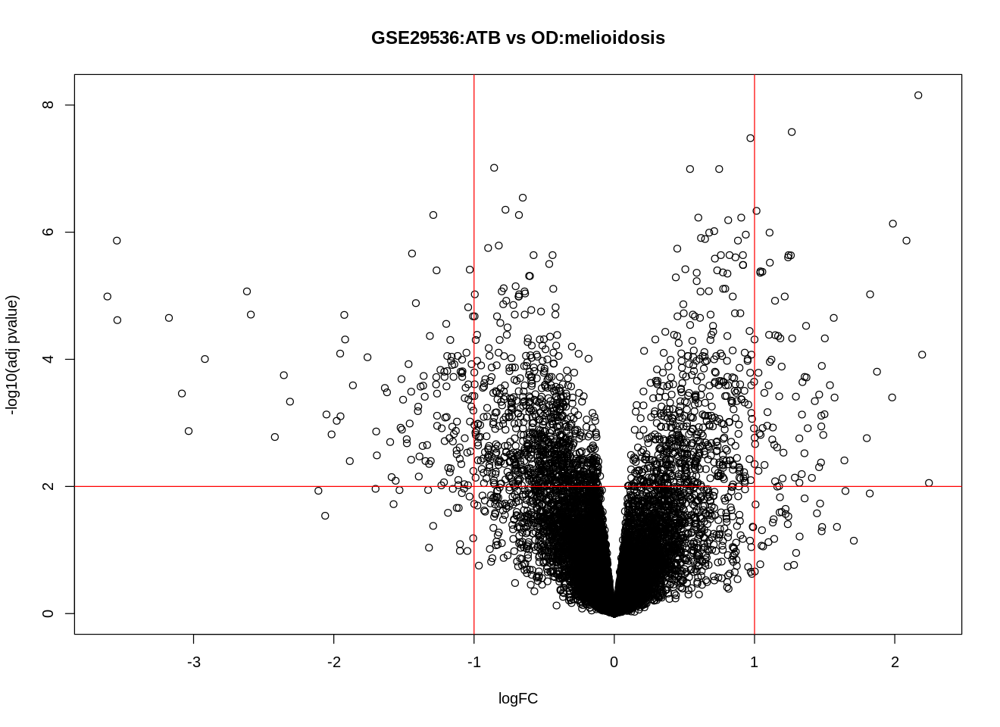

In [151]:
# Perform differential gene expression analysis
df <- diff_exp_array_analysis(GSE_ID, data, def, diff_exp_data, norm_exp_data)
dsets <- rbind(dsets,df$dsets)

##### Dataset 7 -- GSE34608: Germany, TB and sarcoidosis (microarray, GPL6480)
- Subjects: 44
- Disease status: sarcoidosis (n=18), tuberculosis (n=8), control (n=18)
- Disease status definition: sarcoidosis, tuberculosis, control.

Found 2 file(s)

GSE34608-GPL6480_series_matrix.txt.gz

Using locally cached version: /tmp/Rtmph8pCbI/GSE34608-GPL6480_series_matrix.txt.gz

Rows: 32839 Columns: 45

── Column specification ────────────────────────────────────────────────────────
Delimiter: "\t"
chr  (1): ID_REF
dbl (44): GSM851850, GSM851851, GSM851852, GSM851853, GSM851854, GSM851855, ...


ℹ Use `spec()` to retrieve the full column specification for this data.
ℹ Specify the column types or set `show_col_types = FALSE` to quiet this message.

Using locally cached version of GPL6480 found here:
/tmp/Rtmph8pCbI/GPL6480.soft 

Warning message:
“One or more parsing issues, see `problems()` for details”
GSE34608-GPL7731_series_matrix.txt.gz

Using locally cached version: /tmp/Rtmph8pCbI/GSE34608-GPL7731_series_matrix.txt.gz

Rows: 13737 Columns: 25

── Column specification ────────────────────────────────────────────────────────
Delimiter: "\t"
dbl (25): ID_REF, GSM851793, GSM851794, GSM851795, GSM851796, GSM851797, GSM..

         Length Class  Mode
GSE34608 2      -none- list
[1] "GSE34608-GPL6480_series_matrix.txt.gz"
[2] "GSE34608-GPL7731_series_matrix.txt.gz"
[1] "GSE34608-GPL6480_series_matrix.txt.gz"
[2] "GSE34608-GPL7731_series_matrix.txt.gz"


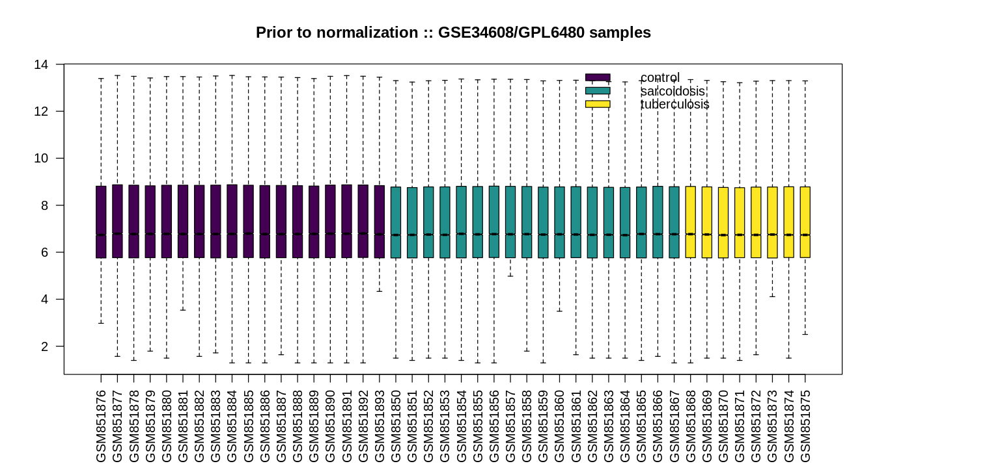

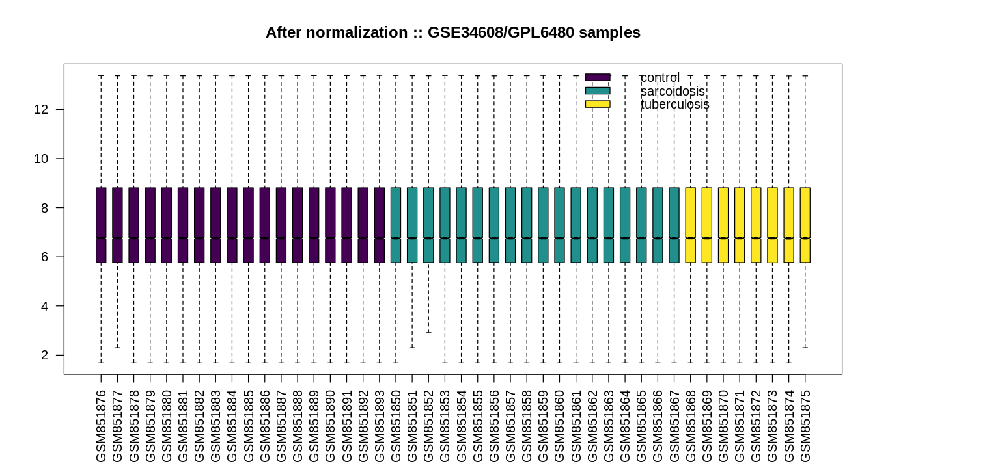

In [152]:
GSE_ID <- "GSE34608"
def <- dataset_info(GSE_ID)
#Fetch and process data
data <- array_process_qc(GSE_ID, def$stage, norm_exp_data, TRUE, platform='GPL6480')

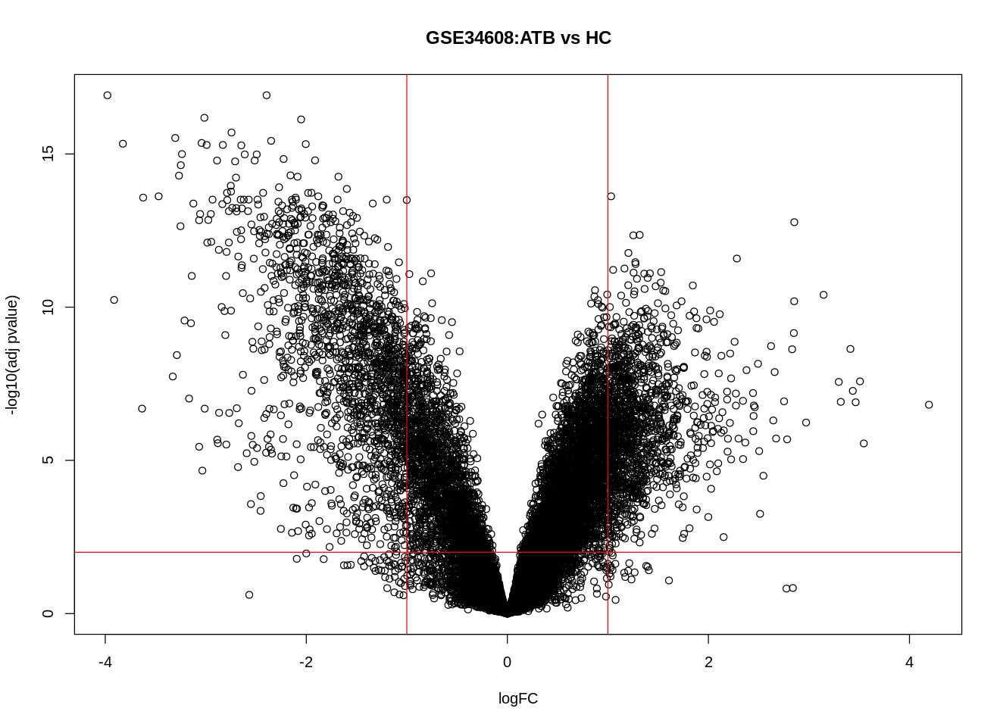

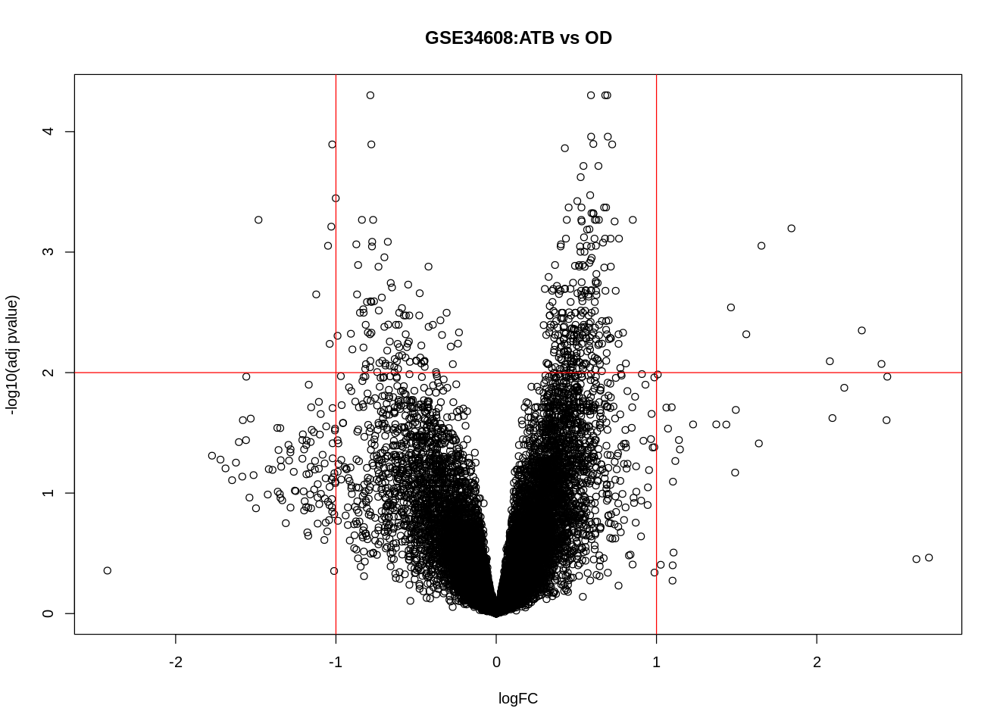

In [153]:
# Perform differential gene expression analysis
df <- diff_exp_array_analysis(GSE_ID, data, def, diff_exp_data, norm_exp_data)
dsets <- rbind(dsets,df$dsets)

##### Dataset 8 -- GSE37250: Cape Town, South Africa (n=300) and Karonga, Malawi (n=237) (microarray, 	GPL10558)
- Subjects: 537
- Disease status: active tuberculosis(n=195), latent TB infection(n=167), other disease(n=175)
- Disease stage (the second layer): HIV positive (n=274) and negative (n=263)
- Disease status definition: active TB (TB) compared to latent TB infection (LTBI) as well as to other diseases (OD)

Found 1 file(s)

GSE37250_series_matrix.txt.gz

Using locally cached version: /tmp/Rtmph8pCbI/GSE37250_series_matrix.txt.gz

Rows: 47323 Columns: 538

── Column specification ────────────────────────────────────────────────────────
Delimiter: "\t"
chr   (1): ID_REF
dbl (537): GSM914353, GSM914354, GSM914355, GSM914356, GSM914357, GSM914358,...


ℹ Use `spec()` to retrieve the full column specification for this data.
ℹ Specify the column types or set `show_col_types = FALSE` to quiet this message.

Using locally cached version of GPL10558 found here:
/tmp/Rtmph8pCbI/GPL10558.soft 

Warning message:
“One or more parsing issues, see `problems()` for details”


         Length Class  Mode
GSE37250 1      -none- list
[1] "GSE37250_series_matrix.txt.gz"


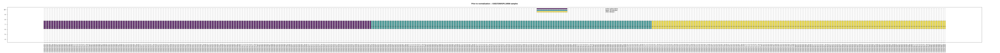

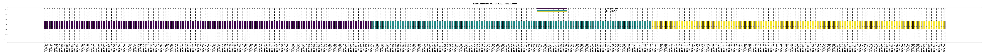

In [154]:
GSE_ID <- "GSE37250"
def <- dataset_info(GSE_ID)
#Fetch and process data
data <- array_process_qc(GSE_ID, def$stage, norm_exp_data, TRUE)

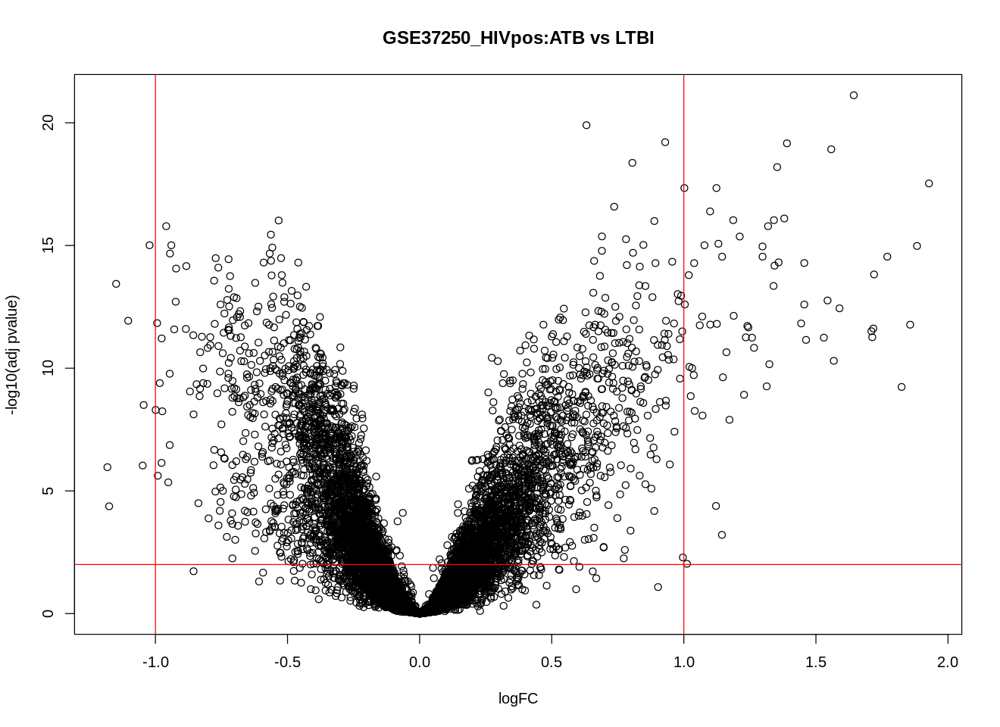

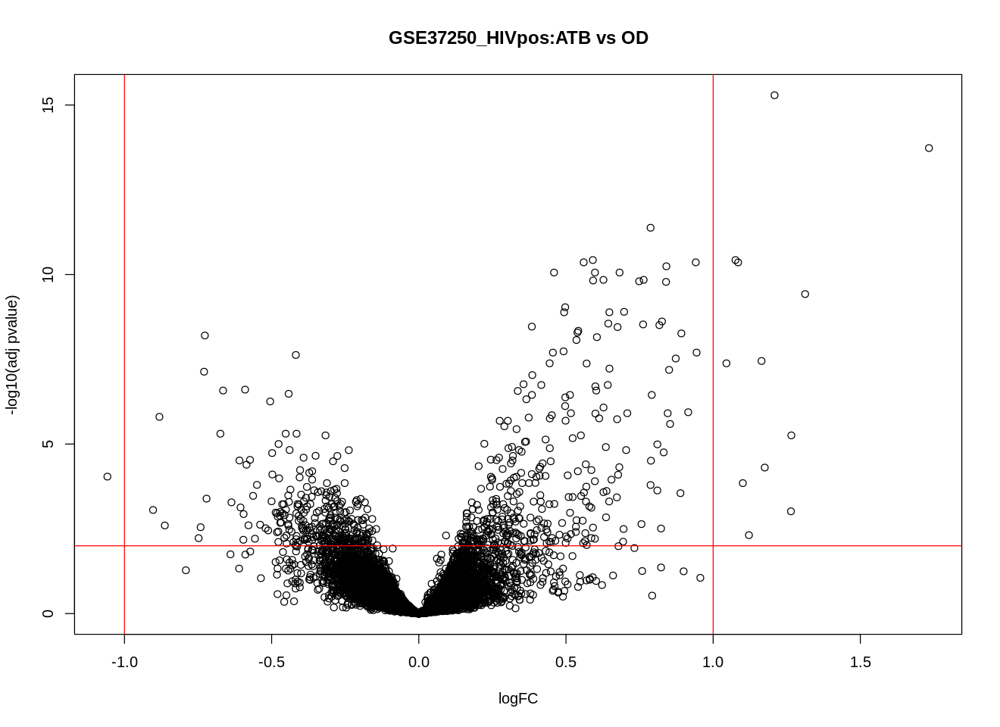

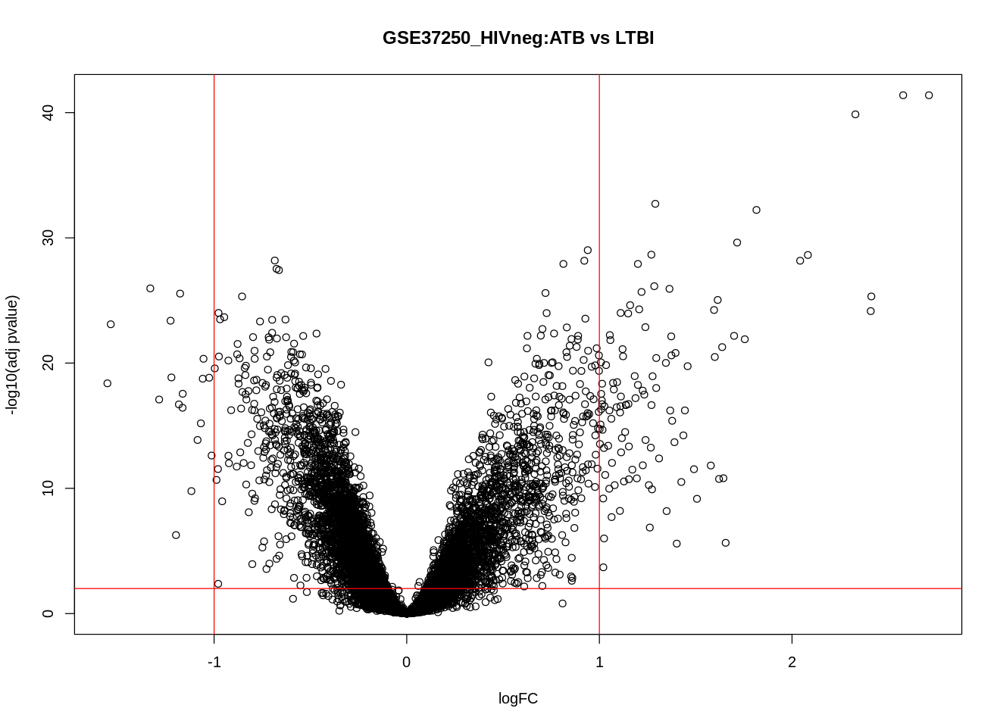

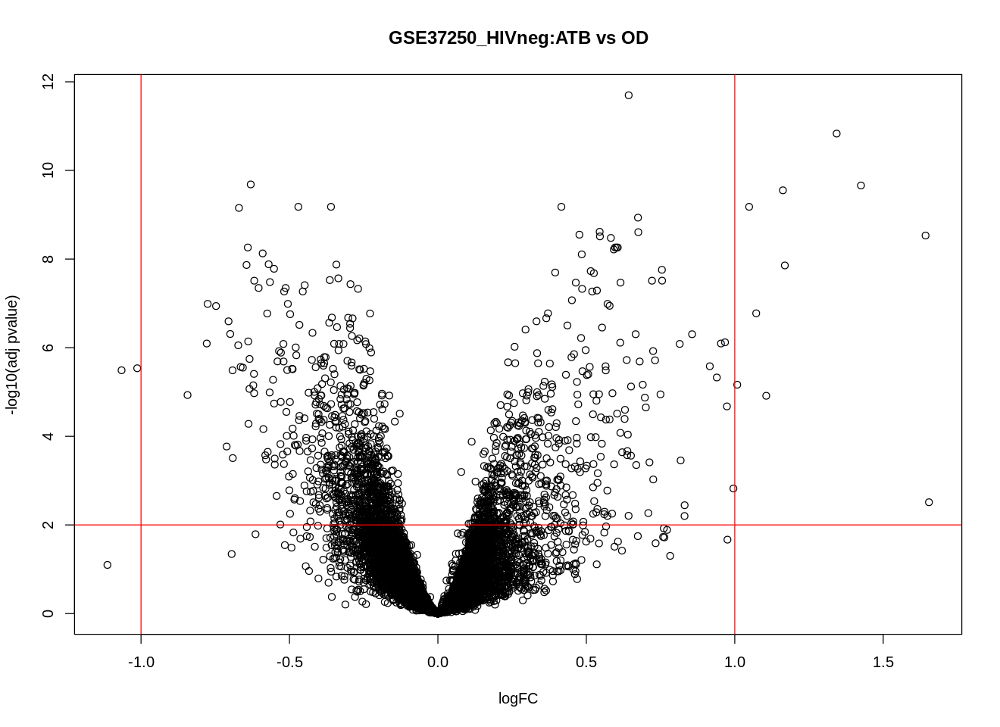

In [155]:
# Perform differential gene expression analysis
# Separate HIV + and -
ind=rownames(data$pheno[data$pheno[,'hiv status:ch1'] %in% 'HIV positive',])
data1=data
data1$gset=data$gset[,ind];data1$pheno=data$pheno[ind,]
df <- diff_exp_array_analysis(paste0(GSE_ID,'_HIVpos'), data1, def, diff_exp_data, norm_exp_data)
dsets <- rbind(dsets,df$dsets)
ind=rownames(data$pheno[data$pheno[,'hiv status:ch1'] %in% 'HIV negative',])
data2=data
data2$gset=data$gset[,ind];data2$pheno=data$pheno[ind,]
df <- diff_exp_array_analysis(paste0(GSE_ID,'_HIVneg'), data2, def, diff_exp_data, norm_exp_data)
dsets <- rbind(dsets,df$dsets)

##### Dataset 9 -- GSE39939 A paediatric cohort from Kenya with HIV+/- (microarray, GPL10558)
- Subjects: 157
- Disease status: active tuberculosis (culture confirmed)(n=35), other disease(n=55), latent TB infection(n=14), active tuberculosis (culture negative)(n=44), other disease (IGRA +)(n=9)
- Disease stage (the second layer): HIV positive (n=274) and negative (n=263)
- Disease status definition: active TB (culture confirmed), active TB (culture negative), LTBI or other disease

Found 1 file(s)

GSE39939_series_matrix.txt.gz

Using locally cached version: /tmp/Rtmph8pCbI/GSE39939_series_matrix.txt.gz

Rows: 47323 Columns: 158

── Column specification ────────────────────────────────────────────────────────
Delimiter: "\t"
chr   (1): ID_REF
dbl (157): GSM1249177, GSM1249178, GSM1249179, GSM1249180, GSM1249181, GSM12...


ℹ Use `spec()` to retrieve the full column specification for this data.
ℹ Specify the column types or set `show_col_types = FALSE` to quiet this message.

Using locally cached version of GPL10558 found here:
/tmp/Rtmph8pCbI/GPL10558.soft 

Warning message:
“One or more parsing issues, see `problems()` for details”


         Length Class  Mode
GSE39939 1      -none- list
[1] "GSE39939_series_matrix.txt.gz"


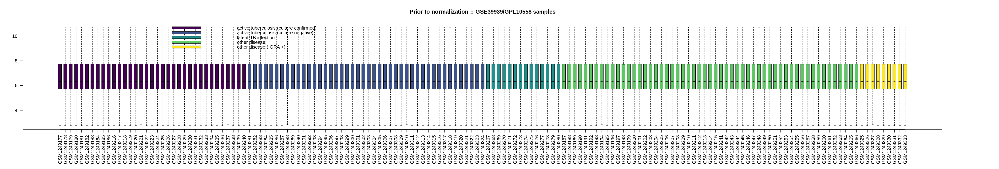

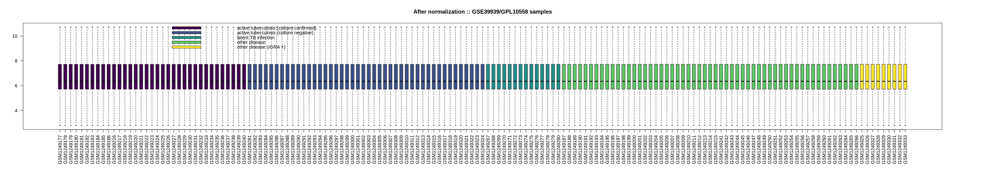

In [156]:
GSE_ID <- "GSE39939"
def <- dataset_info(GSE_ID)
#Fetch and process data
data <- array_process_qc(GSE_ID, def$stage, norm_exp_data, TRUE)

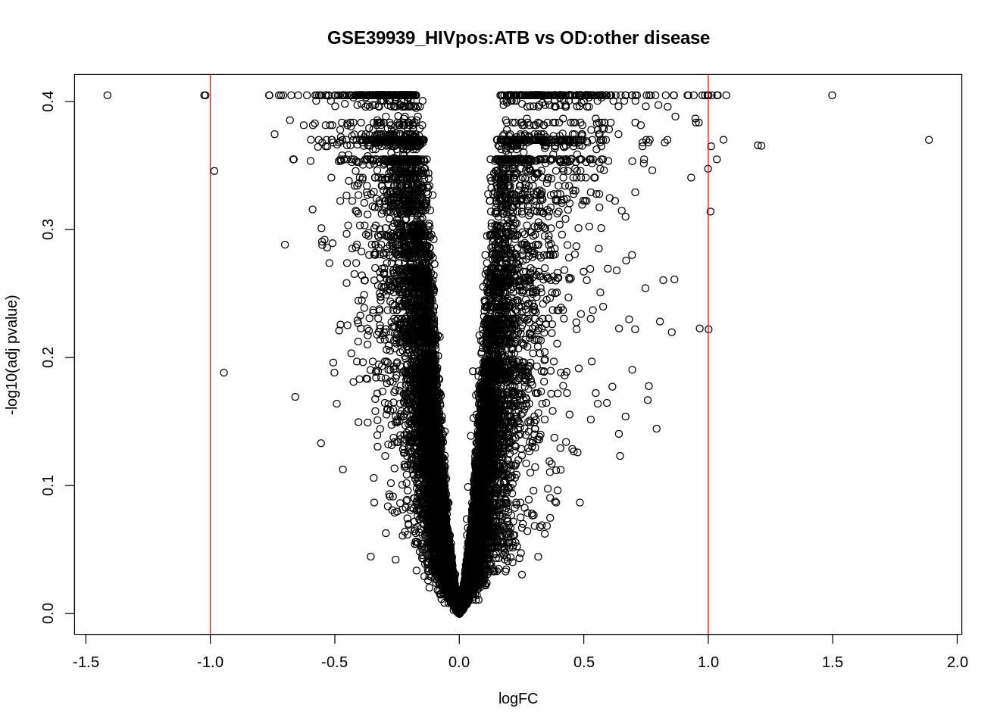

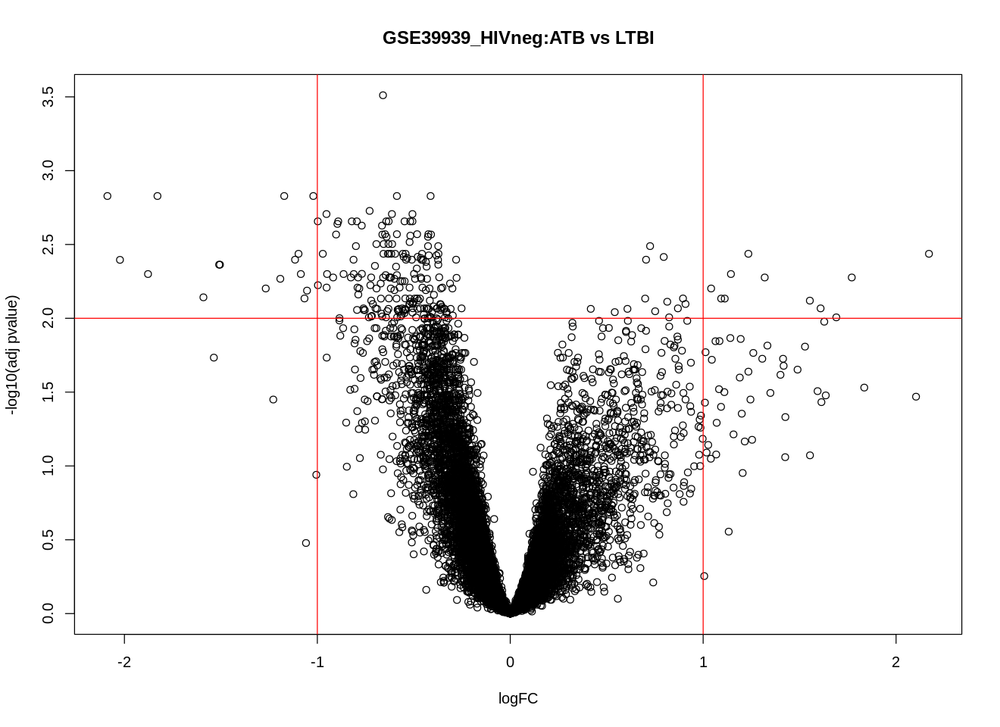

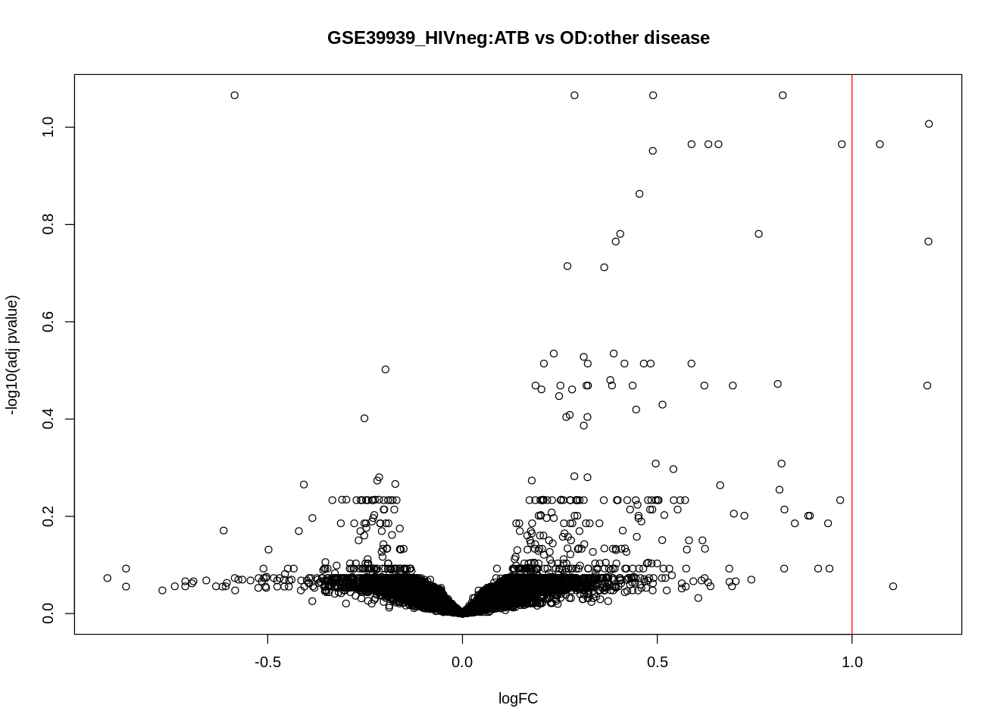

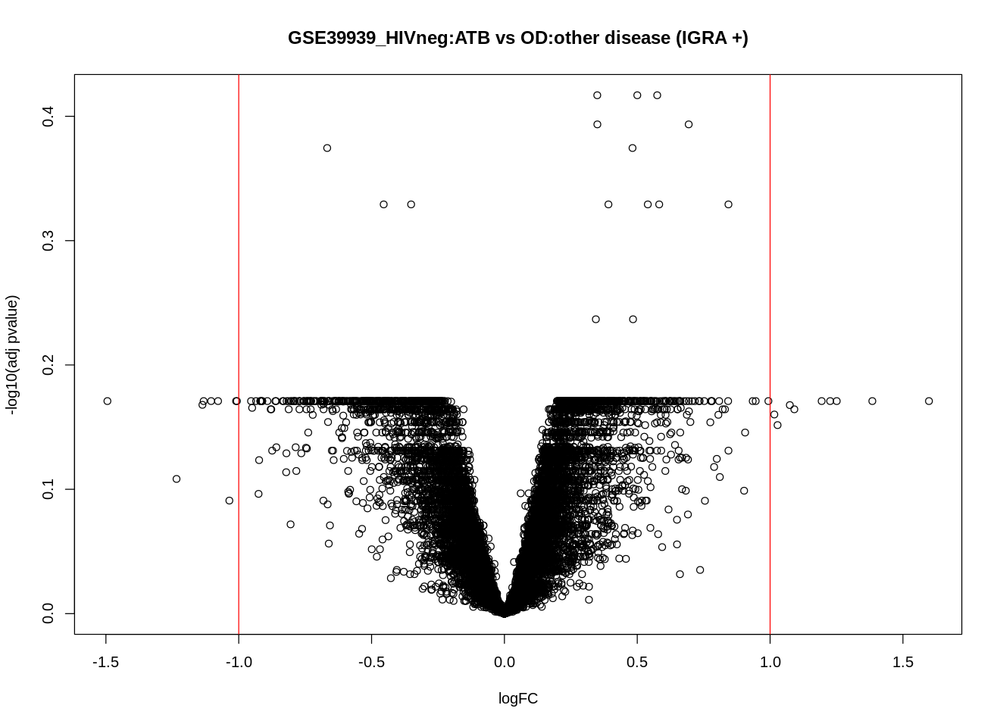

In [157]:
# Perform differential gene expression analysis
# Separate HIV + and -
ind=rownames(data$pheno[data$pheno[,'hiv status:ch1'] %in% 'HIV positive',])
data1=data
data1$gset=data$gset[,ind];data1$pheno=data$pheno[ind,]
df <- diff_exp_array_analysis(paste0(GSE_ID,'_HIVpos'), data1, def, diff_exp_data, norm_exp_data)
dsets <- rbind(dsets,df$dsets)
ind=rownames(data$pheno[data$pheno[,'hiv status:ch1'] %in% 'HIV negative',])
data2=data
data2$gset=data$gset[,ind];data2$pheno=data$pheno[ind,]
df <- diff_exp_array_analysis(paste0(GSE_ID,'_HIVneg'), data2, def, diff_exp_data, norm_exp_data)
dsets <- rbind(dsets,df$dsets)

##### Dataset 10 -- GSE39940 Cape Town, South Africa (n=157) and Blantyre, Malawi (n=177) (microarray, GPL10558)
- Subjects: 334
- Disease status: active tuberculosis(n=111), latent TB infection(n=54), other disease(n=169)
- Disease stage (the second layer): HIV positive (n=107) and negative (n=227)
- Disease status definition: active TB (TB) compared to latent TB infection (LTBI) as well as to other diseases (OD)

Found 1 file(s)

GSE39940_series_matrix.txt.gz

Using locally cached version: /tmp/Rtmph8pCbI/GSE39940_series_matrix.txt.gz

Rows: 47323 Columns: 335

── Column specification ────────────────────────────────────────────────────────
Delimiter: "\t"
chr   (1): ID_REF
dbl (334): GSM981627, GSM981628, GSM981629, GSM981630, GSM981631, GSM981632,...


ℹ Use `spec()` to retrieve the full column specification for this data.
ℹ Specify the column types or set `show_col_types = FALSE` to quiet this message.

Using locally cached version of GPL10558 found here:
/tmp/Rtmph8pCbI/GPL10558.soft 

Warning message:
“One or more parsing issues, see `problems()` for details”


         Length Class  Mode
GSE39940 1      -none- list
[1] "GSE39940_series_matrix.txt.gz"


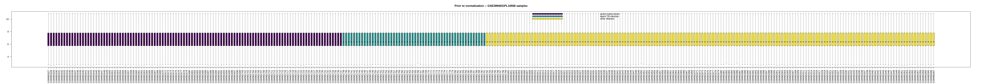

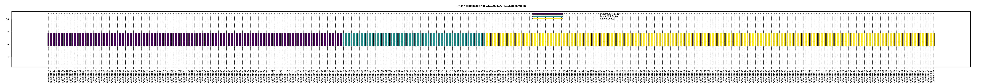

In [158]:
GSE_ID <- "GSE39940"
def <- dataset_info(GSE_ID)
#Fetch and process data
data <- array_process_qc(GSE_ID, def$stage, norm_exp_data, TRUE)

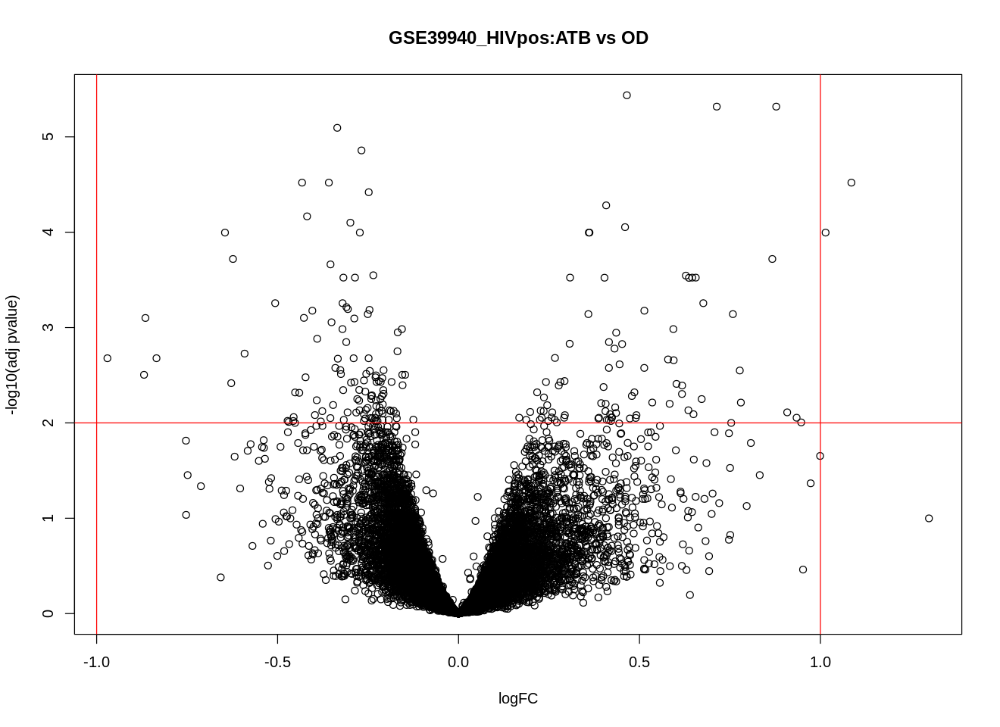

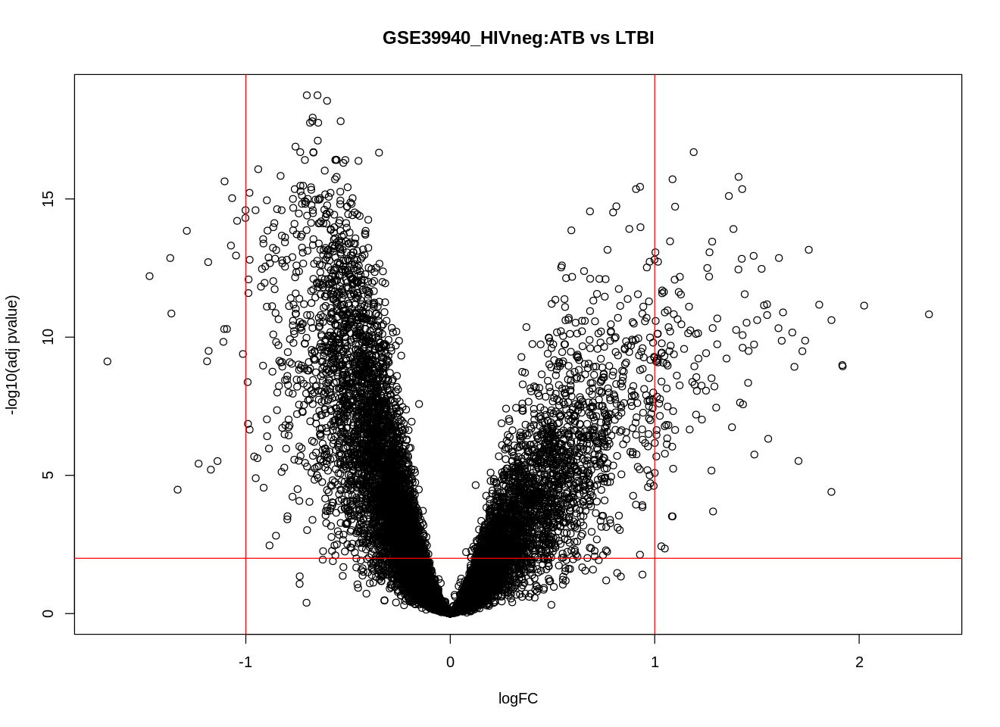

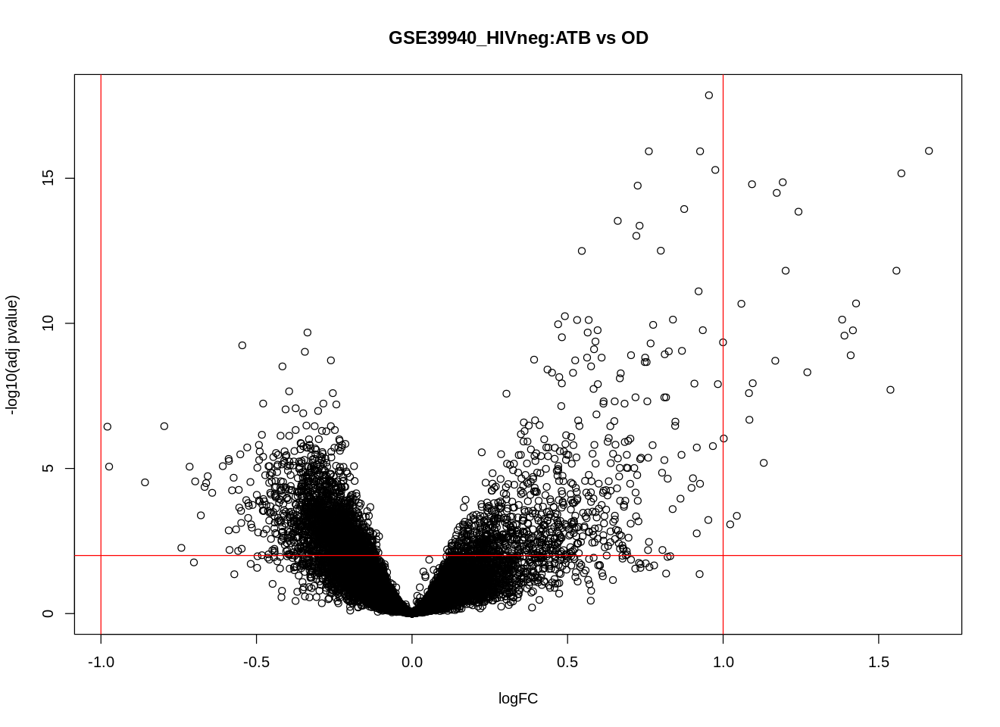

In [159]:
# Perform differential gene expression analysis
# Separate HIV + and -
ind=rownames(data$pheno[data$pheno[,'hiv status:ch1'] %in% 'HIV positive',])
data1=data
data1$gset=data$gset[,ind];data1$pheno=data$pheno[ind,]
df <- diff_exp_array_analysis(paste0(GSE_ID,'_HIVpos'), data1, def, diff_exp_data, norm_exp_data)
dsets <- rbind(dsets,df$dsets)
ind=rownames(data$pheno[data$pheno[,'hiv status:ch1'] %in% 'HIV negative',])
data2=data
data2$gset=data$gset[,ind];data2$pheno=data$pheno[ind,]
df <- diff_exp_array_analysis(paste0(GSE_ID,'_HIVneg'), data2, def, diff_exp_data, norm_exp_data)
dsets <- rbind(dsets,df$dsets)

##### Dataset 11 -- GSE41055: Venezuela, Warao Amerindian children (microarray, GPL5175)
- Subjects: 27
- Disease status: whole blood, active TB infection (n=9), whole blood, latent TB infection (n=9), whole blood, healthy control (n=9)
- Disease status definition: children 1 to 15 years of age, HIV-negative. LTBI was defined as a TST = 10mm and a positive QFT-GIT with a negative culture result on inclusion in the absence of radiological and clinical evidence of TB disease on inclusion as well as on t=6 and t=12 months. HC were children with a TST = 0 mm at inclusion and at t=6 and t=12 months and a negative QFT-GIT and a negative culture result at inclusion without radiological or clinical evidence of TB disease on inclusion nor on t=6 and t=12 months. 

Found 1 file(s)

GSE41055_series_matrix.txt.gz

Using locally cached version: /tmp/Rtmph8pCbI/GSE41055_series_matrix.txt.gz

Rows: 22011 Columns: 28

── Column specification ────────────────────────────────────────────────────────
Delimiter: "\t"
dbl (28): ID_REF, GSM1008060, GSM1008061, GSM1008062, GSM1008063, GSM1008064...


ℹ Use `spec()` to retrieve the full column specification for this data.
ℹ Specify the column types or set `show_col_types = FALSE` to quiet this message.

Using locally cached version of GPL5175 found here:
/tmp/Rtmph8pCbI/GPL5175.soft 



         Length Class  Mode
GSE41055 1      -none- list
[1] "GSE41055_series_matrix.txt.gz"


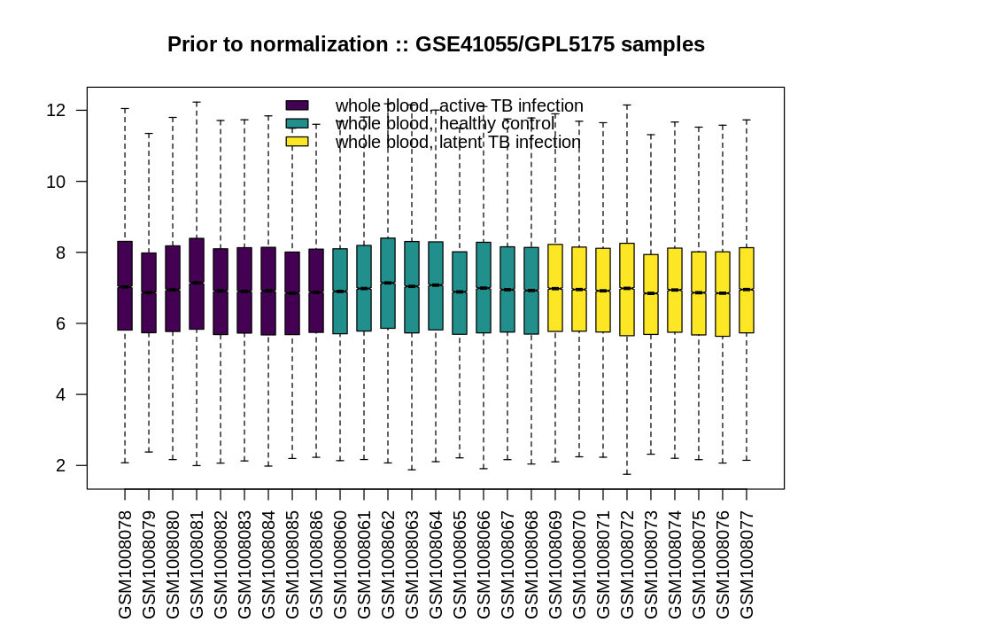

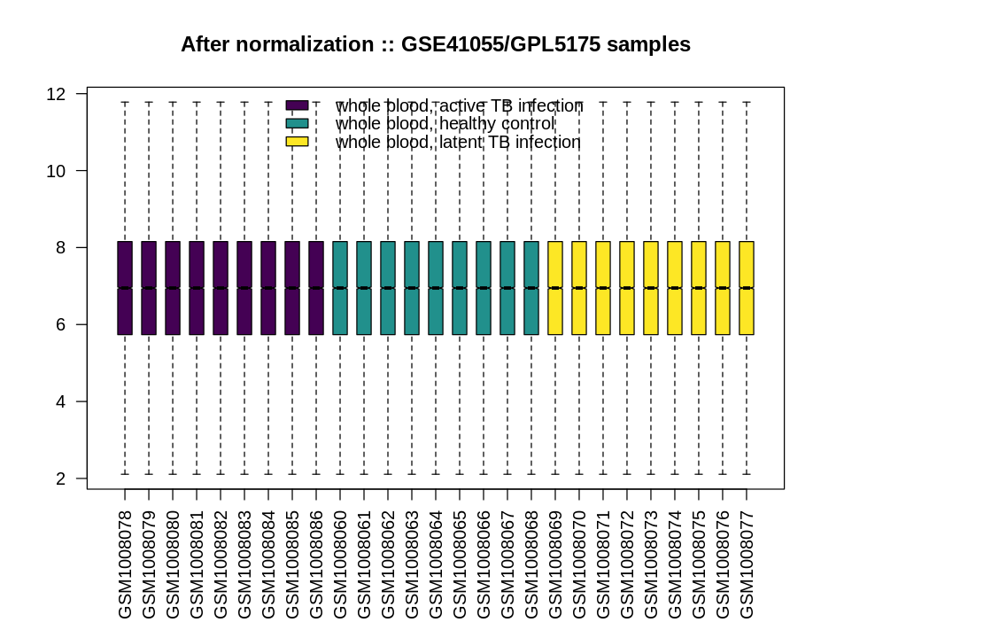

In [160]:
GSE_ID <- "GSE41055"
def <- dataset_info(GSE_ID)
#Fetch and process data
data <- array_process_qc(GSE_ID, def$stage, norm_exp_data, TRUE)

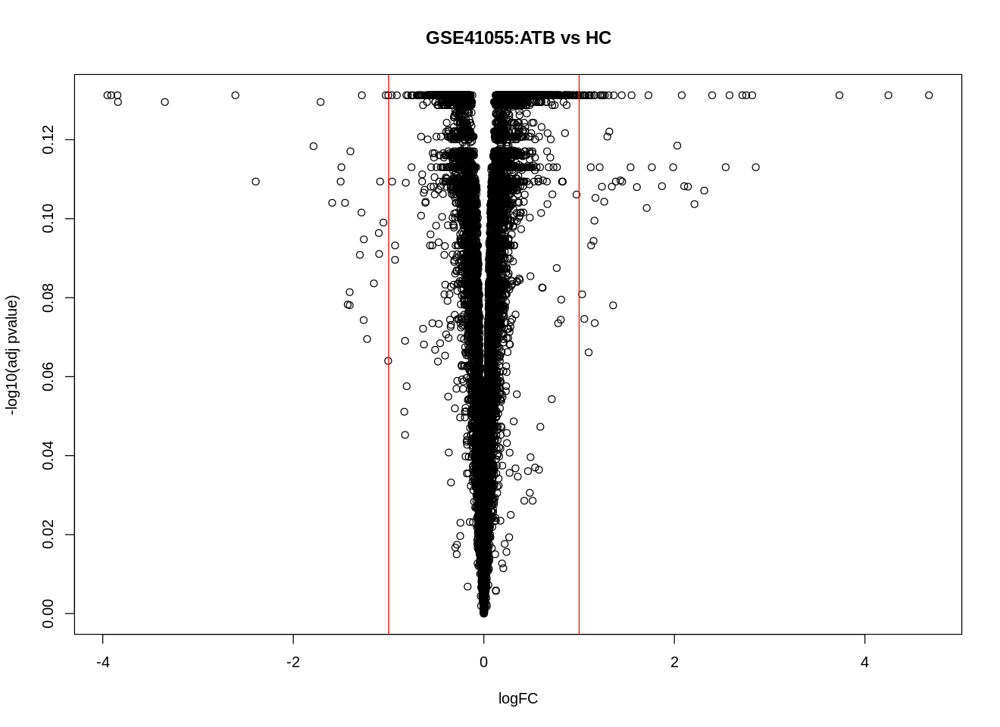

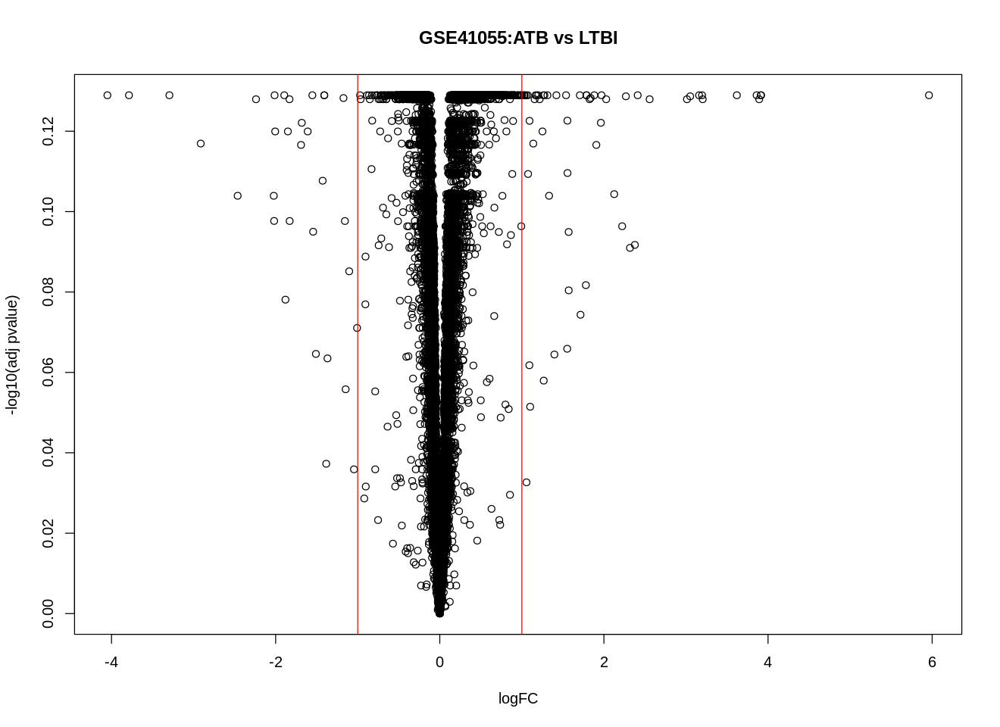

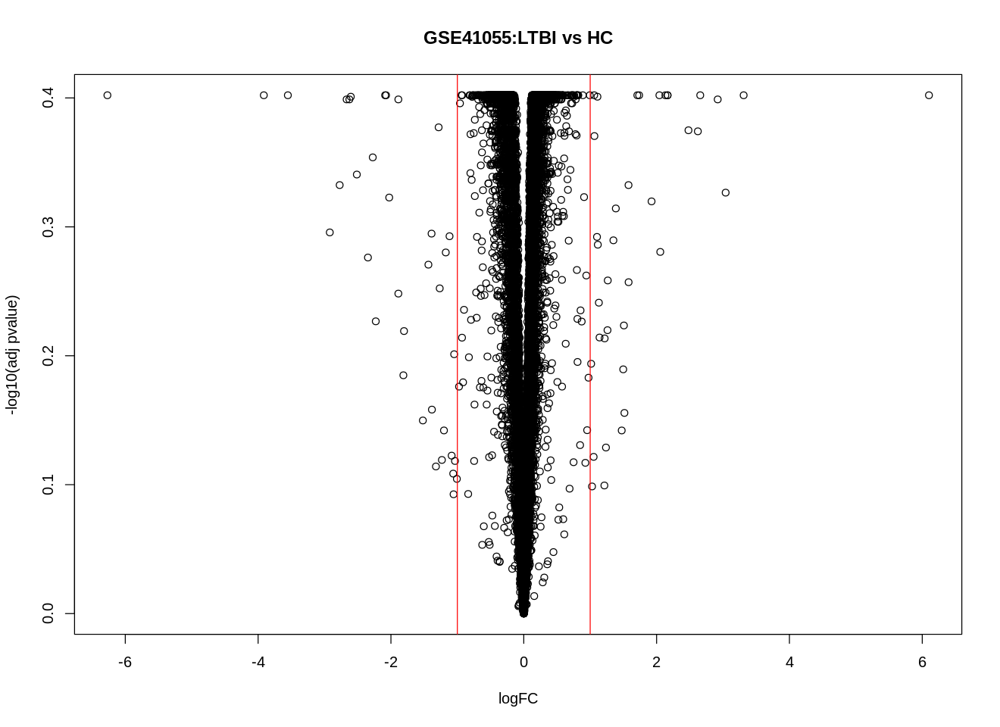

In [161]:
# Perform differential gene expression analysis
df <- diff_exp_array_analysis(GSE_ID, data, def, diff_exp_data, norm_exp_data)
dsets <- rbind(dsets,df$dsets)

##### Dataset 12 -- GSE42825: UK London (microarray, GPL10558)
- Subjects:42
- Disease status: TB (n=8), Non-active and Active sarcoidosis (n=11) and Controls (n=23)
- Disease status definition: TB, sarcoidosis, and healthy controls 

Found 1 file(s)

GSE42825_series_matrix.txt.gz

Using locally cached version: /tmp/Rtmph8pCbI/GSE42825_series_matrix.txt.gz

Rows: 47323 Columns: 43

── Column specification ────────────────────────────────────────────────────────
Delimiter: "\t"
chr  (1): ID_REF
dbl (42): GSM1050732, GSM1050733, GSM1050734, GSM1050735, GSM1050736, GSM105...


ℹ Use `spec()` to retrieve the full column specification for this data.
ℹ Specify the column types or set `show_col_types = FALSE` to quiet this message.

Using locally cached version of GPL10558 found here:
/tmp/Rtmph8pCbI/GPL10558.soft 

Warning message:
“One or more parsing issues, see `problems()` for details”


         Length Class  Mode
GSE42825 1      -none- list
[1] "GSE42825_series_matrix.txt.gz"


Warning message in bxp(list(stats = structure(c(-0.10121441, 0.149054285, 0.29154897, :
“some notches went outside hinges ('box'): maybe set notch=FALSE”
Warning message in bxp(list(stats = structure(c(-0.151579136238095, -0.0278816861666667, :
“some notches went outside hinges ('box'): maybe set notch=FALSE”


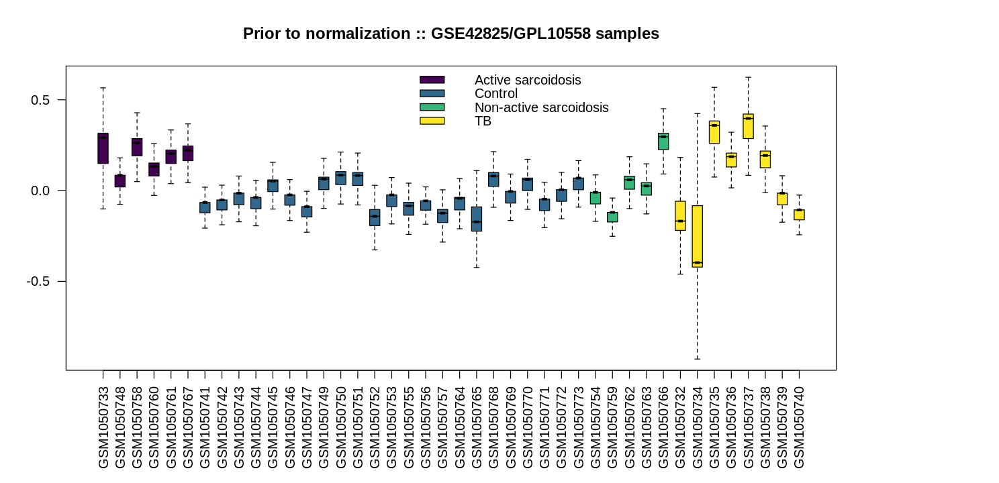

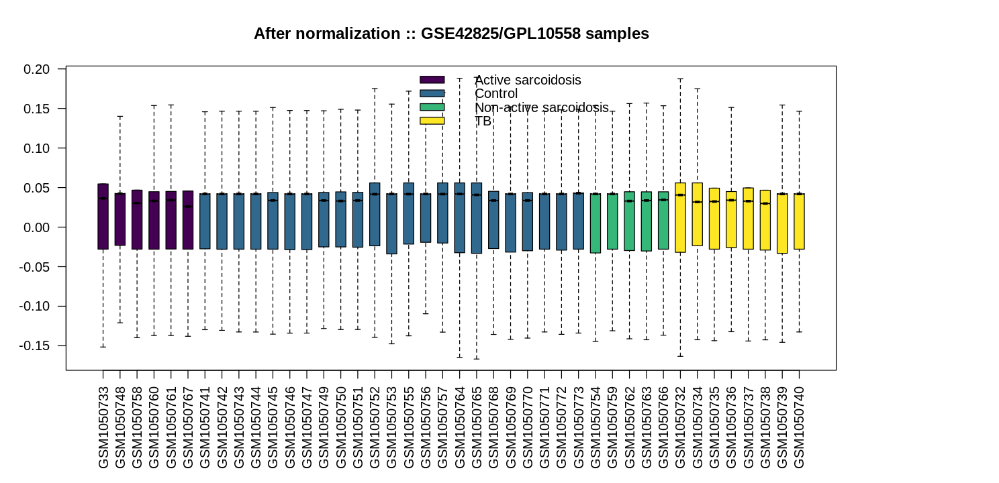

In [162]:
GSE_ID <- "GSE42825"
def <- dataset_info(GSE_ID)
#Fetch and process data
data <- array_process_qc(GSE_ID, def$stage, norm_exp_data, TRUE)

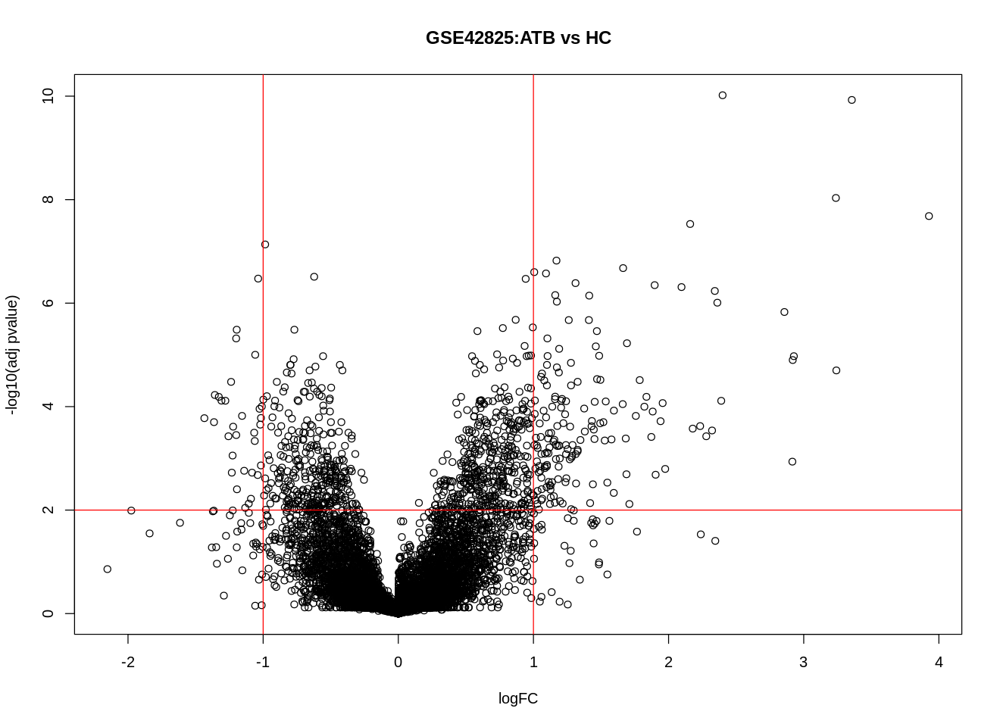

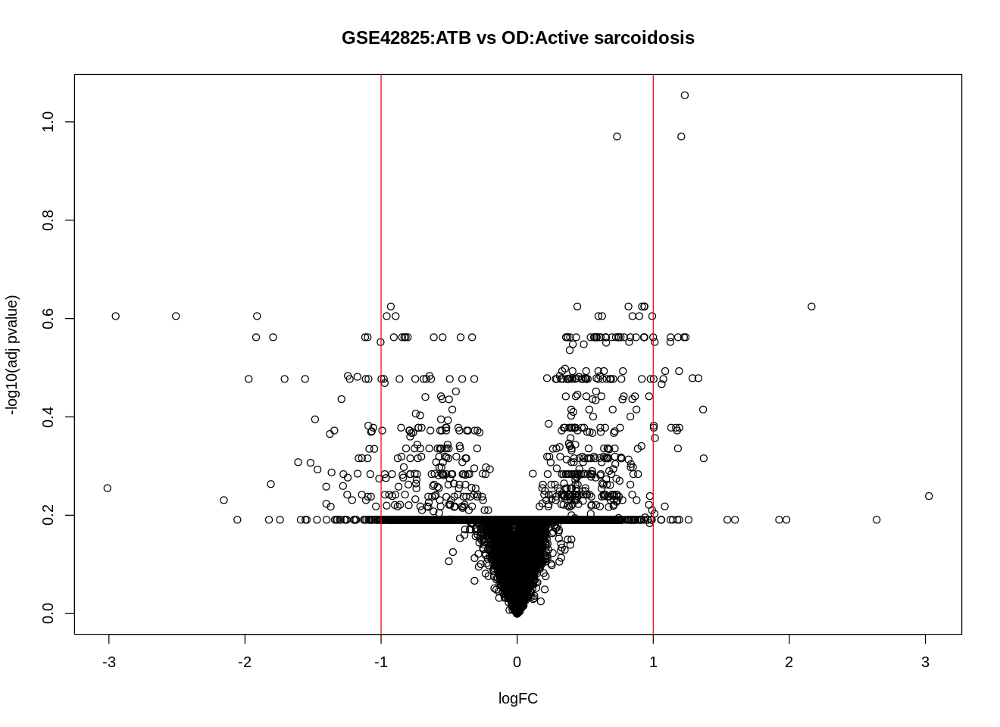

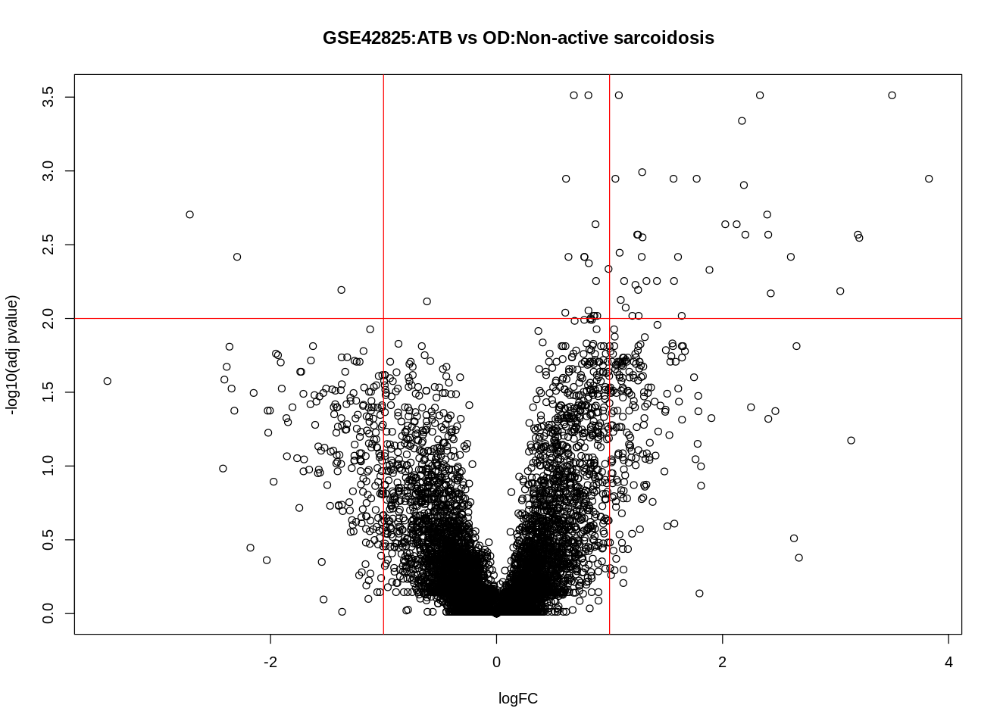

In [163]:
# Perform differential gene expression analysis
df <- diff_exp_array_analysis(GSE_ID, data, def, diff_exp_data, norm_exp_data)
dsets <- rbind(dsets,df$dsets)

##### Dataset 13 -- GSE42826: UK London (microarray, GPL10558)
- Subjects:102
- Disease status: TB (n=11), Non-active and Active sarcoidosis (n=25), Pneumonia (n=6),lung cancer (n=8) and Controls (n=52)
- Disease status definition: TB, sarcoidosis, pneumonia, lung cancer and healthy controls 

Found 1 file(s)

GSE42826_series_matrix.txt.gz

Using locally cached version: /tmp/Rtmph8pCbI/GSE42826_series_matrix.txt.gz

Rows: 47323 Columns: 103

── Column specification ────────────────────────────────────────────────────────
Delimiter: "\t"
chr   (1): ID_REF
dbl (102): GSM1050774, GSM1050775, GSM1050776, GSM1050777, GSM1050778, GSM10...


ℹ Use `spec()` to retrieve the full column specification for this data.
ℹ Specify the column types or set `show_col_types = FALSE` to quiet this message.

Using locally cached version of GPL10558 found here:
/tmp/Rtmph8pCbI/GPL10558.soft 

Warning message:
“One or more parsing issues, see `problems()` for details”


         Length Class  Mode
GSE42826 1      -none- list
[1] "GSE42826_series_matrix.txt.gz"


Warning message in bxp(list(stats = structure(c(-0.9299362, -0.43511224, -0.41011596, :
“some notches went outside hinges ('box'): maybe set notch=FALSE”
Warning message in bxp(list(stats = structure(c(-0.438649454803922, -0.106834456156863, :
“some notches went outside hinges ('box'): maybe set notch=FALSE”


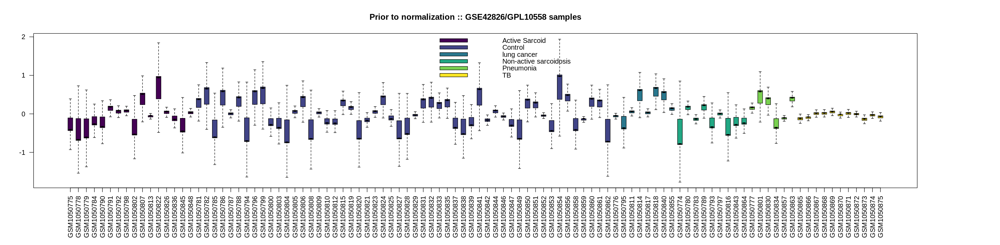

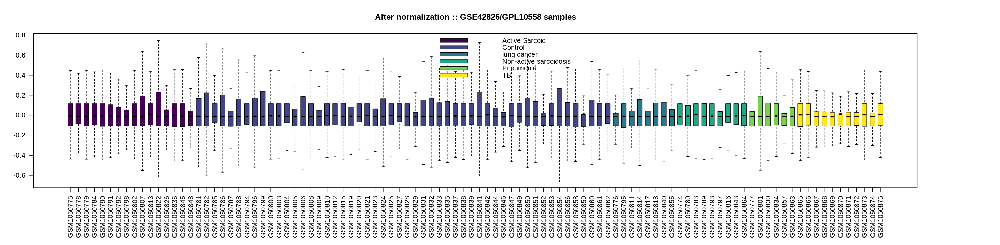

In [164]:
GSE_ID <- "GSE42826"
def <- dataset_info(GSE_ID)
#Fetch and process data
data <- array_process_qc(GSE_ID, def$stage, norm_exp_data, TRUE)

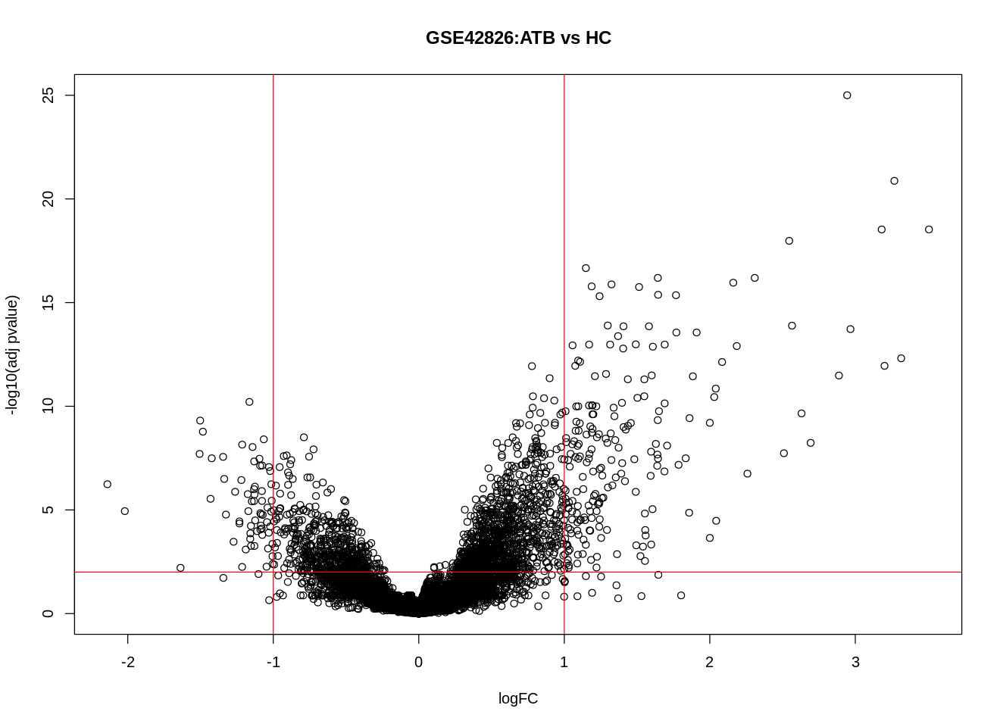

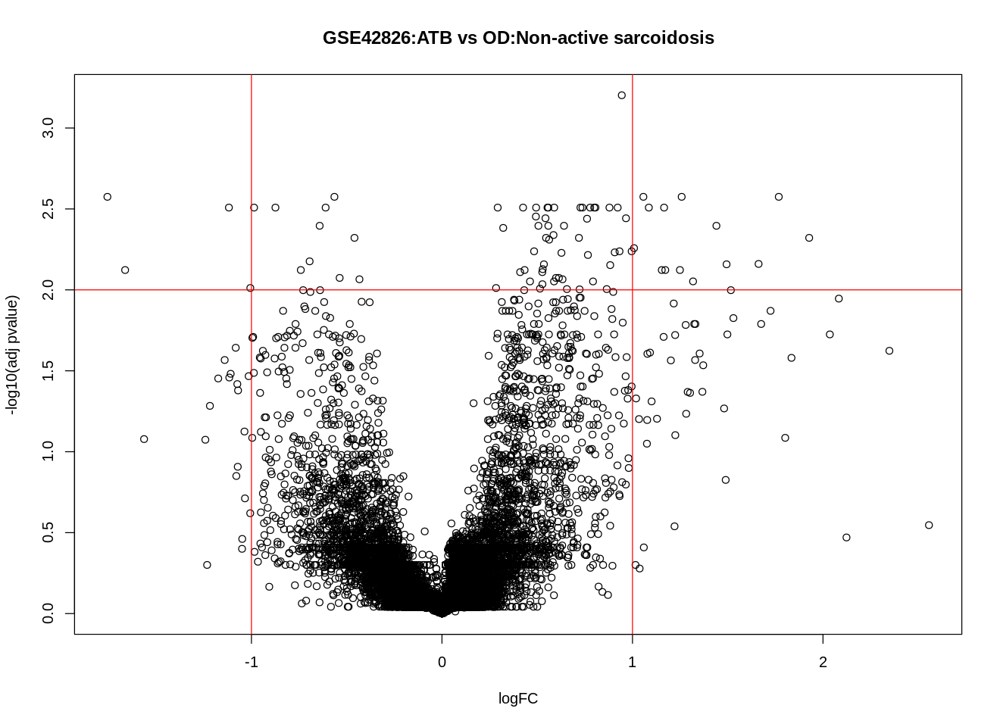

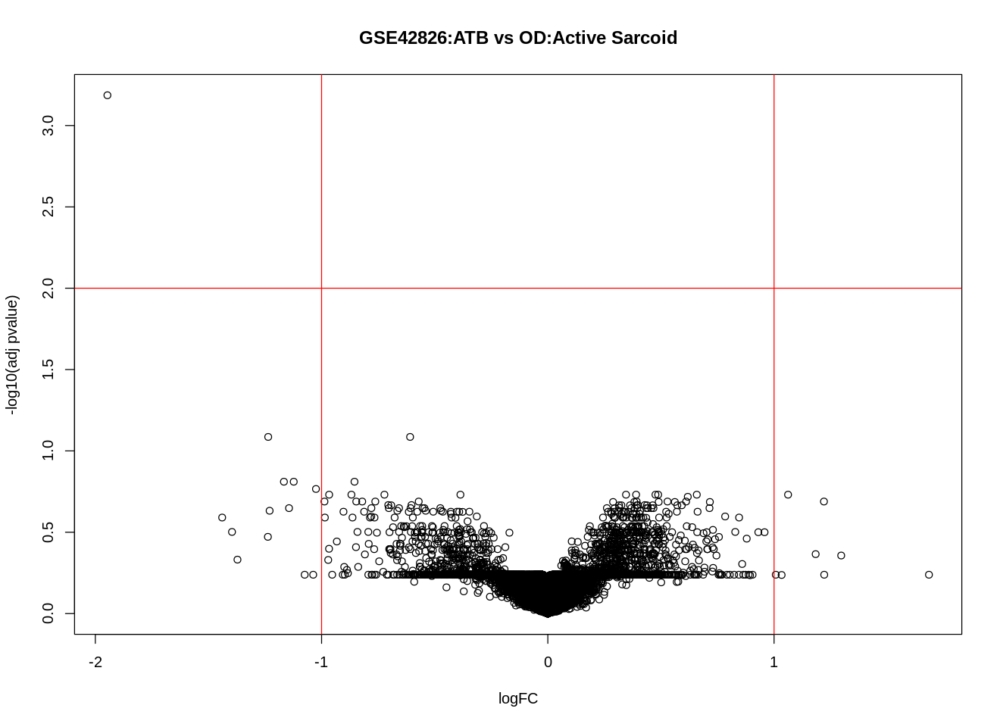

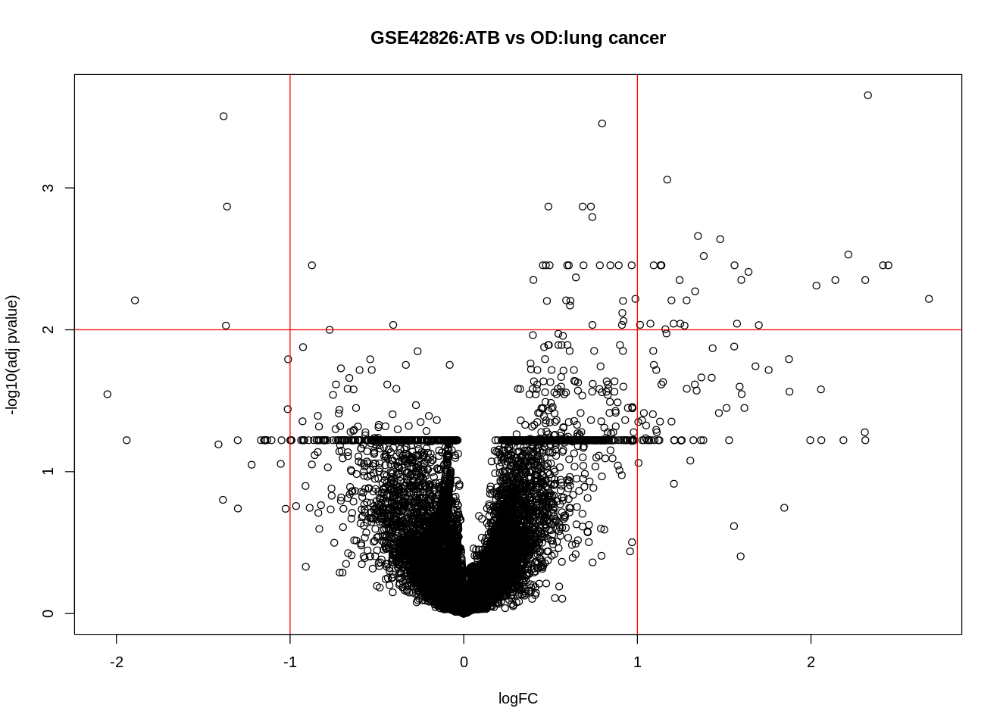

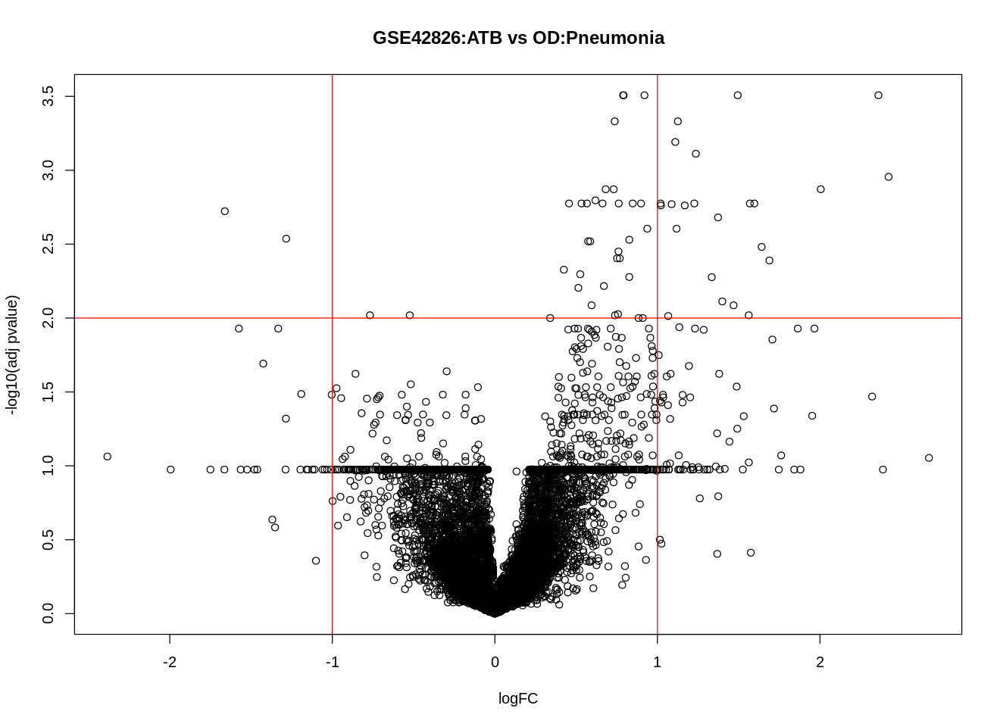

In [165]:
# Perform differential gene expression analysis
df <- diff_exp_array_analysis(GSE_ID, data, def, diff_exp_data, norm_exp_data)
dsets <- rbind(dsets,df$dsets)

##### Dataset 14 -- GSE42830: Germany (microarray, GPL10558)
- Subjects: 95
- Disease status: TB (n=16), Non-active sarcoidosis and Active Sarcoid (n=25), pneumonia (n=8),lung cancer (n=8) and healthy controls (n=38)
- Disease status definition: TB, sarcoidosis, pneumonia, lung cancer and healthy controls 

Found 1 file(s)

GSE42830_series_matrix.txt.gz

Using locally cached version: /tmp/Rtmph8pCbI/GSE42830_series_matrix.txt.gz

Rows: 47323 Columns: 96

── Column specification ────────────────────────────────────────────────────────
Delimiter: "\t"
chr  (1): ID_REF
dbl (95): GSM1050928, GSM1050929, GSM1050930, GSM1050931, GSM1050932, GSM105...


ℹ Use `spec()` to retrieve the full column specification for this data.
ℹ Specify the column types or set `show_col_types = FALSE` to quiet this message.

Using locally cached version of GPL10558 found here:
/tmp/Rtmph8pCbI/GPL10558.soft 

Warning message:
“One or more parsing issues, see `problems()` for details”


         Length Class  Mode
GSE42830 1      -none- list
[1] "GSE42830_series_matrix.txt.gz"


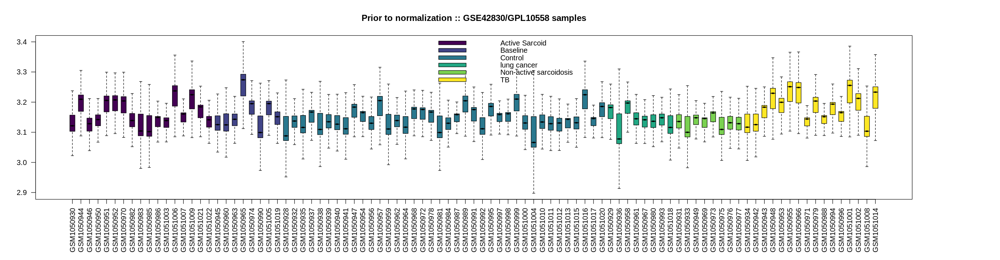

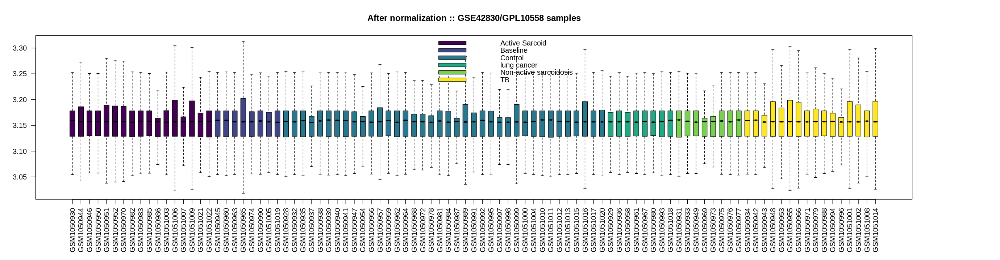

In [166]:
GSE_ID <- "GSE42830"
def <- dataset_info(GSE_ID)
#Fetch and process data
data <- array_process_qc(GSE_ID, def$stage, norm_exp_data, TRUE)

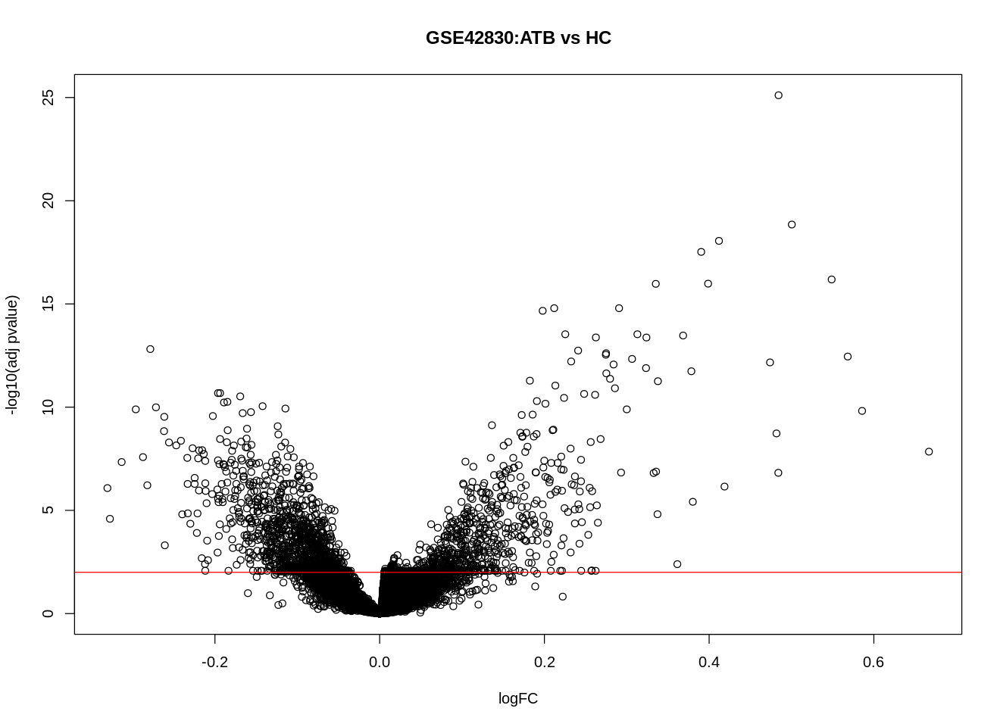

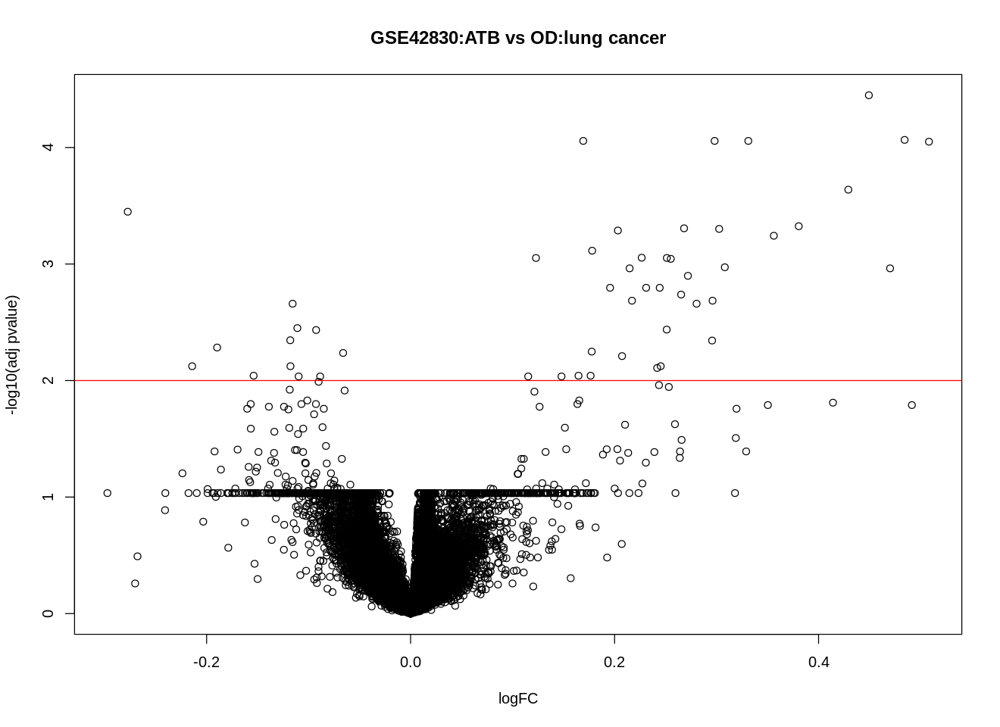

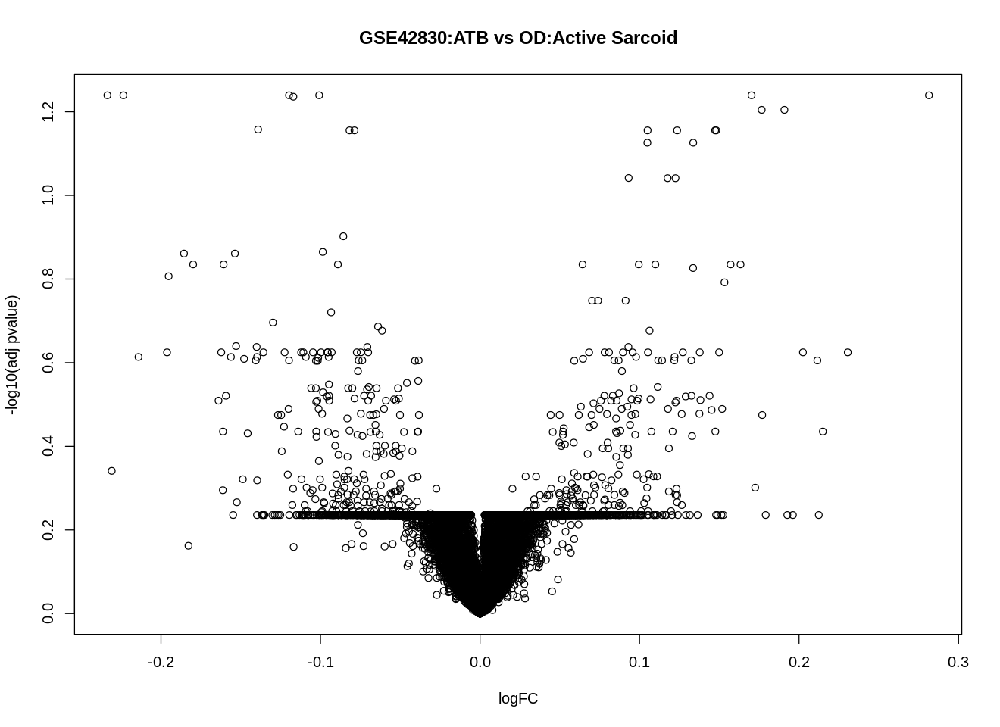

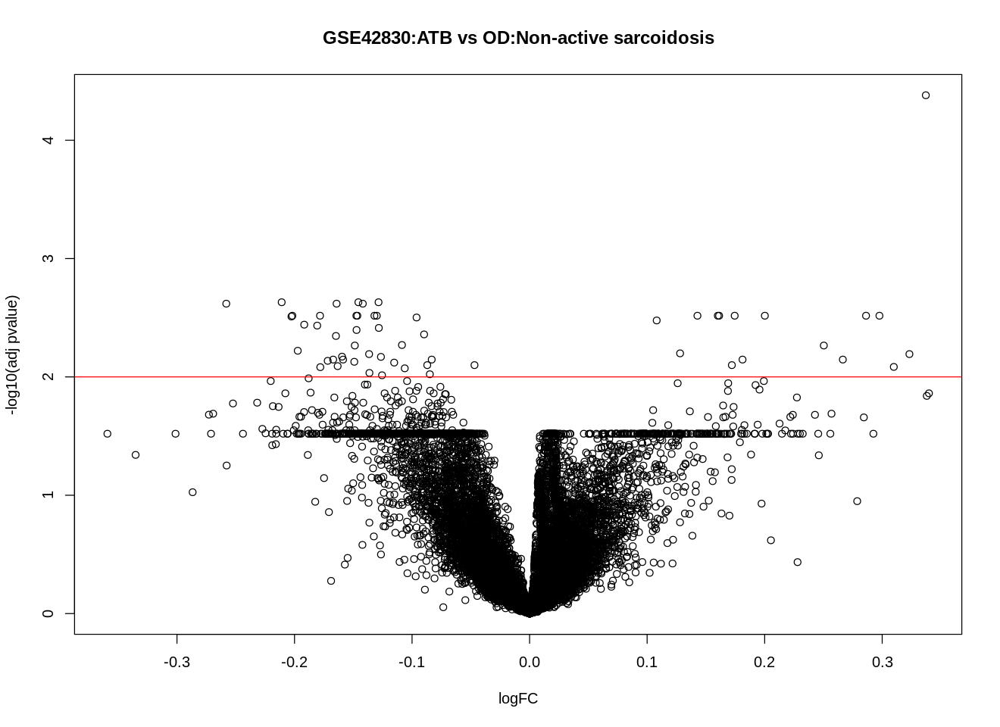

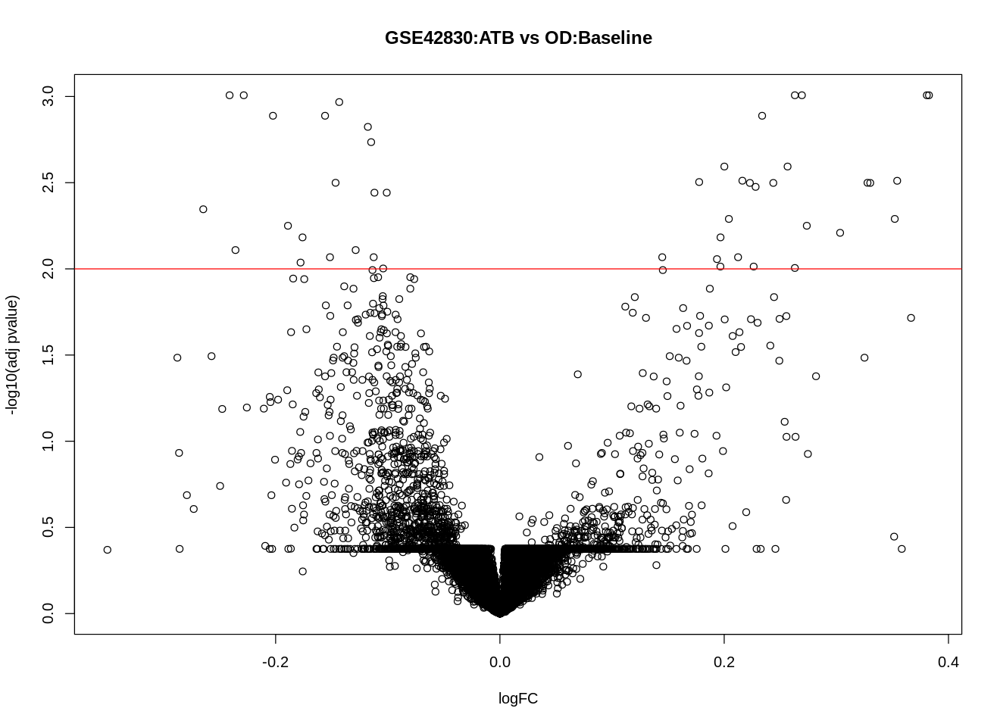

In [167]:
# Perform differential gene expression analysis
df <- diff_exp_array_analysis(GSE_ID, data, def, diff_exp_data, norm_exp_data)
dsets <- rbind(dsets,df$dsets)

##### Dataset 15 -- GSE50834: HIV and HIV/TB coninfection from South African cohort (microarray, GPL10558) (PBMC)
- Subjects: 44
- Disease status: HIV only(n=21), HIV/TB(n=23)
- Disease status definition: HIV, HIV/TB

Found 1 file(s)

GSE50834_series_matrix.txt.gz

Using locally cached version: /tmp/Rtmph8pCbI/GSE50834_series_matrix.txt.gz

Rows: 15529 Columns: 45

── Column specification ────────────────────────────────────────────────────────
Delimiter: "\t"
chr  (1): ID_REF
dbl (44): GSM1230902, GSM1230903, GSM1230904, GSM1230905, GSM1230906, GSM123...


ℹ Use `spec()` to retrieve the full column specification for this data.
ℹ Specify the column types or set `show_col_types = FALSE` to quiet this message.

Using locally cached version of GPL10558 found here:
/tmp/Rtmph8pCbI/GPL10558.soft 

Warning message:
“One or more parsing issues, see `problems()` for details”


         Length Class  Mode
GSE50834 1      -none- list
[1] "GSE50834_series_matrix.txt.gz"


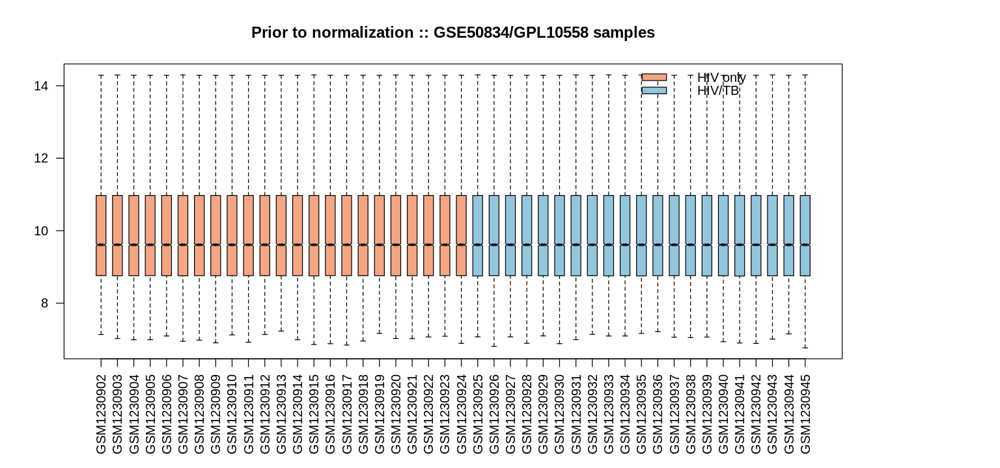

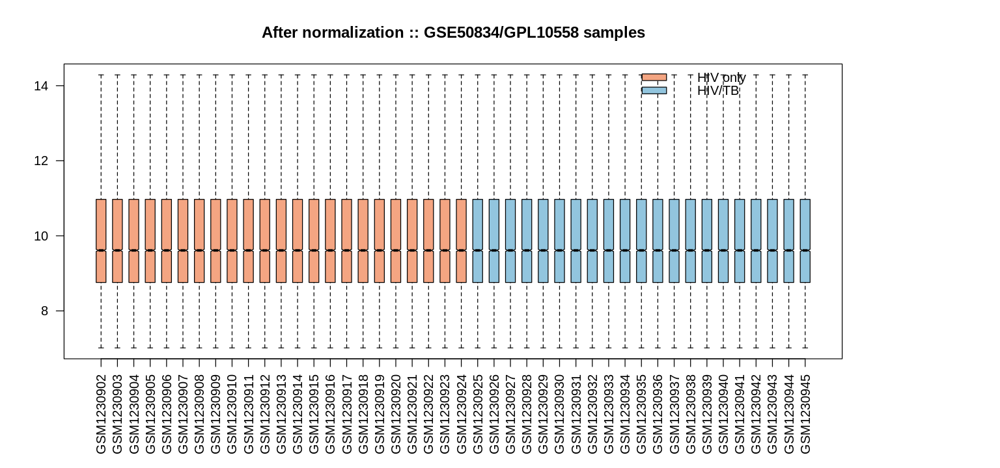

In [168]:
GSE_ID <- "GSE50834"
def <- dataset_info(GSE_ID)
#Fetch and process data
data <- array_process_qc(GSE_ID, def$stage, norm_exp_data, TRUE)

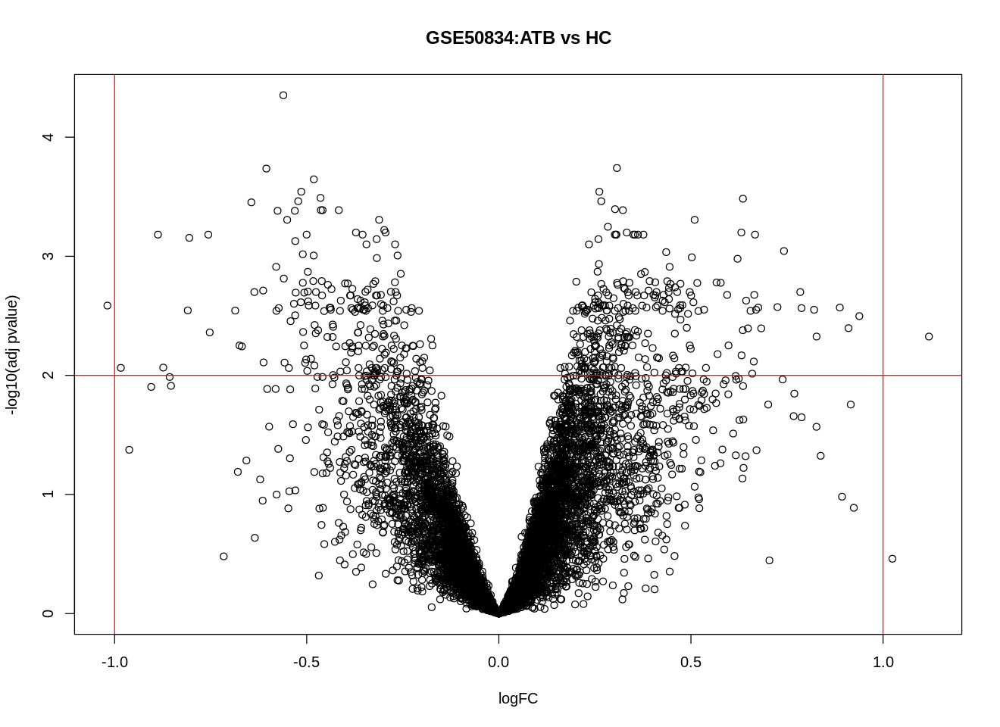

In [169]:
# Perform differential gene expression analysis
df <- diff_exp_array_analysis(GSE_ID, data, def, diff_exp_data, norm_exp_data)
dsets <- rbind(dsets,df$dsets)

##### Dataset 16 -- GSE56153 Indonesia (microarray, GPL6883)
- Subjects: 71
- Disease status: Active (n=18),Treatment (n=15),Recover (n=20) and Control (n=18)
- Disease status definition: Tuberculosis patients above 15 years of age were recruited from an outpatient tuberculosis clinic in central Jakarta (Indonesia). Randomly selected control subjects with the same sex and age (+/-10%) were recruited from neighboring households

Found 1 file(s)

GSE56153_series_matrix.txt.gz

Using locally cached version: /tmp/Rtmph8pCbI/GSE56153_series_matrix.txt.gz

Rows: 24526 Columns: 72

── Column specification ────────────────────────────────────────────────────────
Delimiter: "\t"
chr  (1): ID_REF
dbl (71): GSM1356732, GSM1356733, GSM1356734, GSM1356735, GSM1356736, GSM135...


ℹ Use `spec()` to retrieve the full column specification for this data.
ℹ Specify the column types or set `show_col_types = FALSE` to quiet this message.

Using locally cached version of GPL6883 found here:
/tmp/Rtmph8pCbI/GPL6883.soft 



         Length Class  Mode
GSE56153 1      -none- list
[1] "GSE56153_series_matrix.txt.gz"


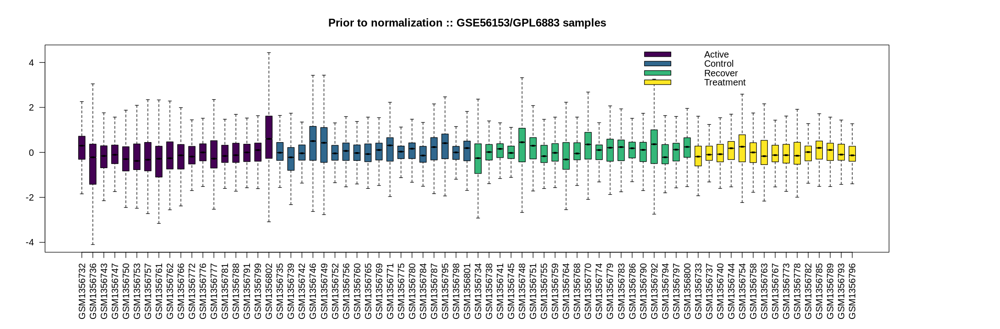

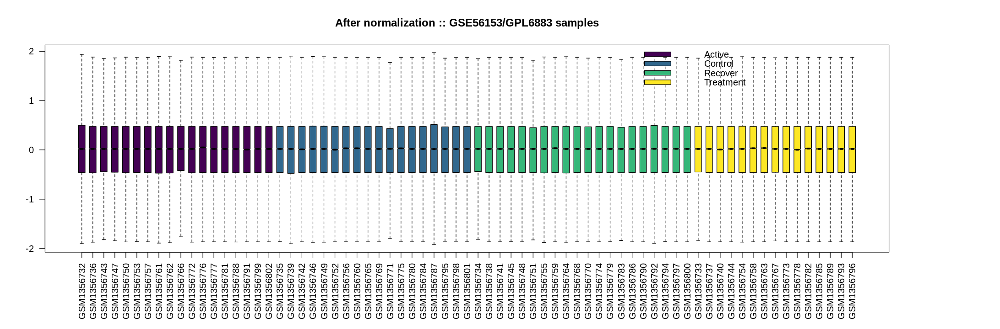

In [170]:
GSE_ID <- "GSE56153"
def <- dataset_info(GSE_ID)
#Fetch and process data
data <- array_process_qc(GSE_ID, def$stage, norm_exp_data, TRUE)

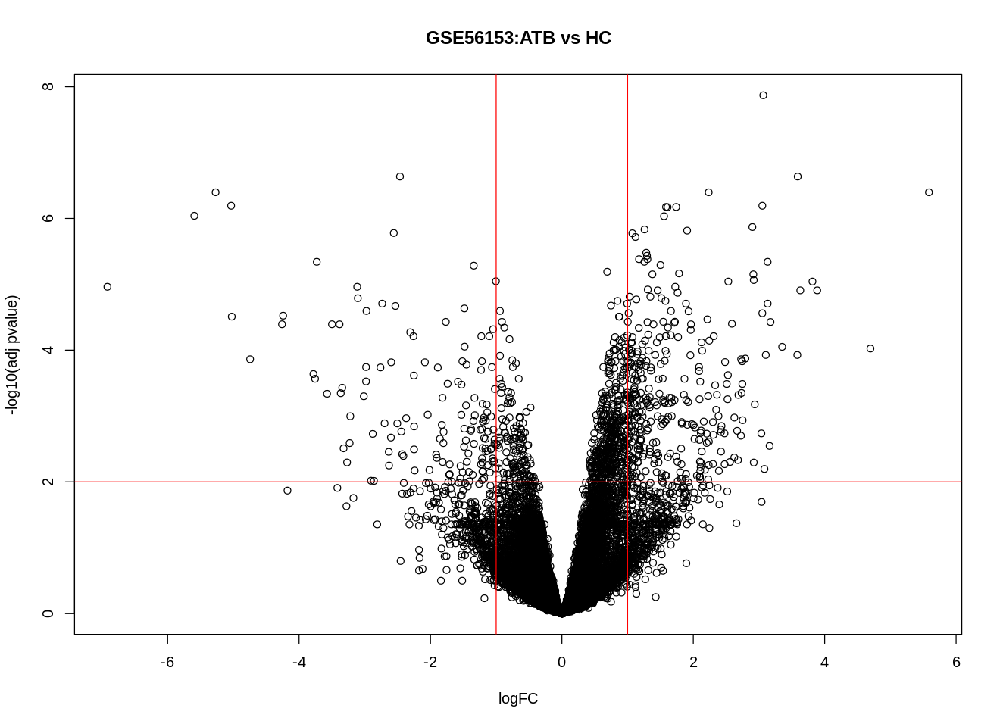

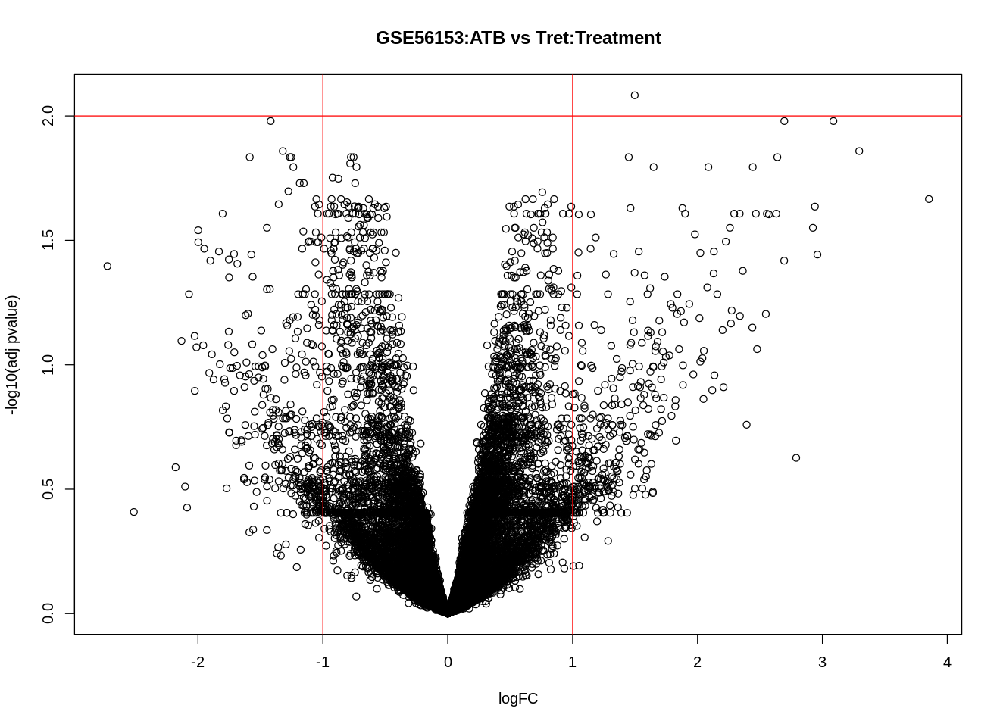

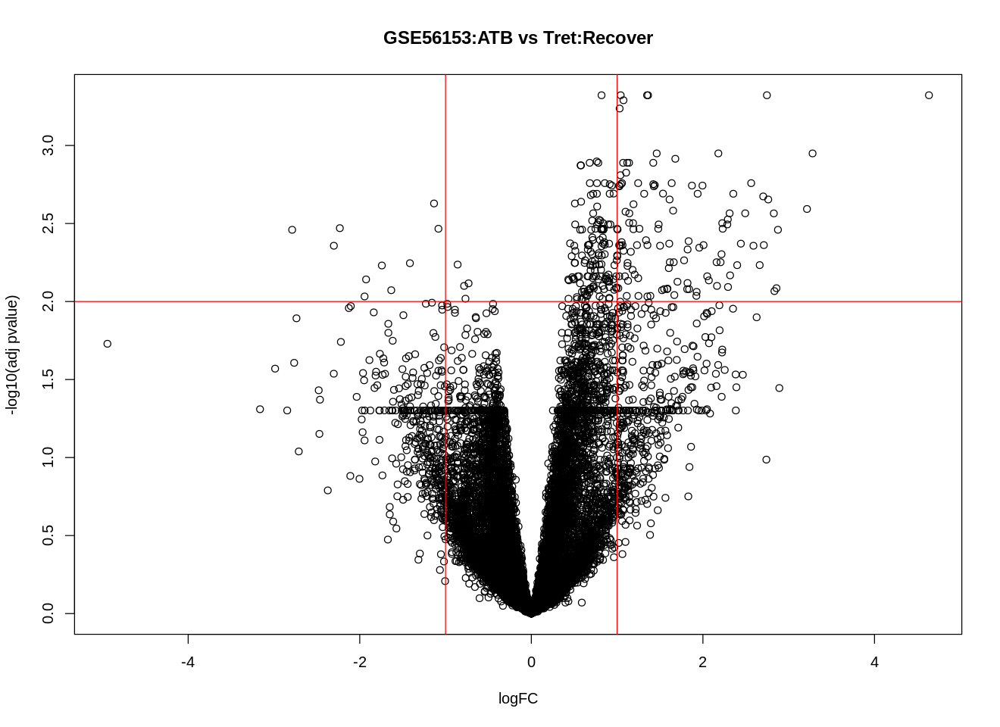

In [171]:
# Perform differential gene expression analysis
df <- diff_exp_array_analysis(GSE_ID, data, def, diff_exp_data, norm_exp_data)
dsets <- rbind(dsets,df$dsets)

##### Dataset 17 -- GSE54992: China (microarray, GPL570)
- Subjects: 39
- Disease status: tuberculosis (n=9), latent tuberculosis infection (n=6), TB patient after anti-tuberculosis treatment for 3 months (n=9), TB patient after anti-tuberculosis treatment for 6 months (n=9), and healthy donor (n=6)

Found 1 file(s)

GSE54992_series_matrix.txt.gz

Using locally cached version: /tmp/Rtmph8pCbI/GSE54992_series_matrix.txt.gz

Rows: 54675 Columns: 40

── Column specification ────────────────────────────────────────────────────────
Delimiter: "\t"
chr  (1): ID_REF
dbl (39): GSM1327526, GSM1327527, GSM1327528, GSM1327529, GSM1327530, GSM132...


ℹ Use `spec()` to retrieve the full column specification for this data.
ℹ Specify the column types or set `show_col_types = FALSE` to quiet this message.

Using locally cached version of GPL570 found here:
/tmp/Rtmph8pCbI/GPL570.soft 



         Length Class  Mode
GSE54992 1      -none- list
[1] "GSE54992_series_matrix.txt.gz"


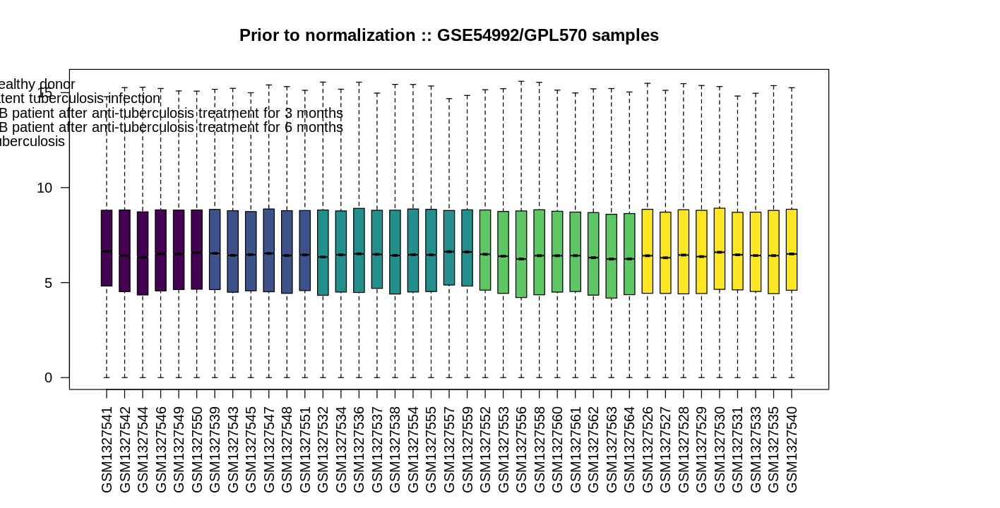

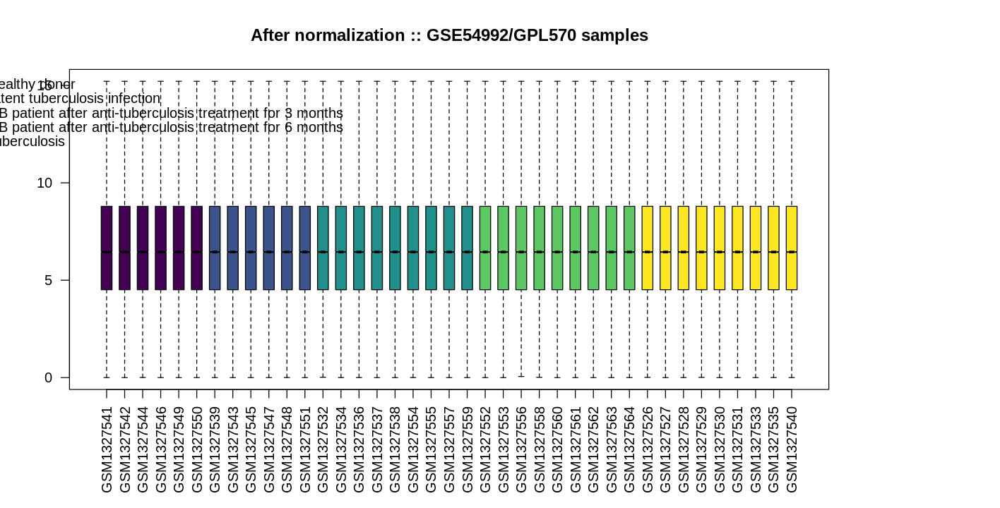

In [172]:
GSE_ID <- "GSE54992"
def <- dataset_info(GSE_ID)
#Fetch and process data
data <- array_process_qc(GSE_ID, def$stage, norm_exp_data, TRUE)

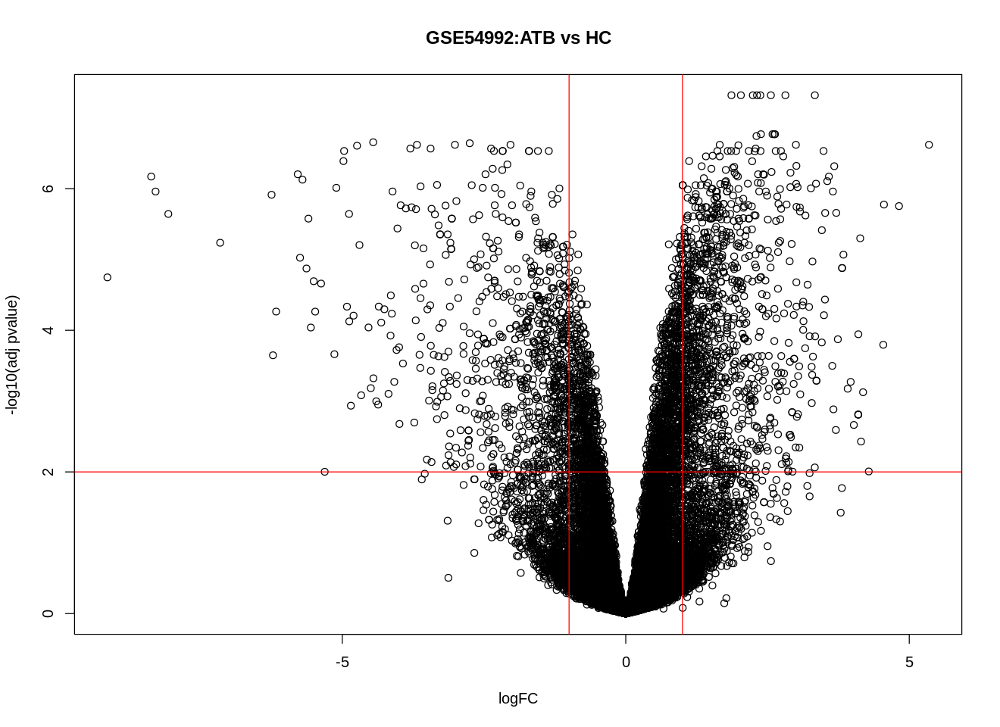

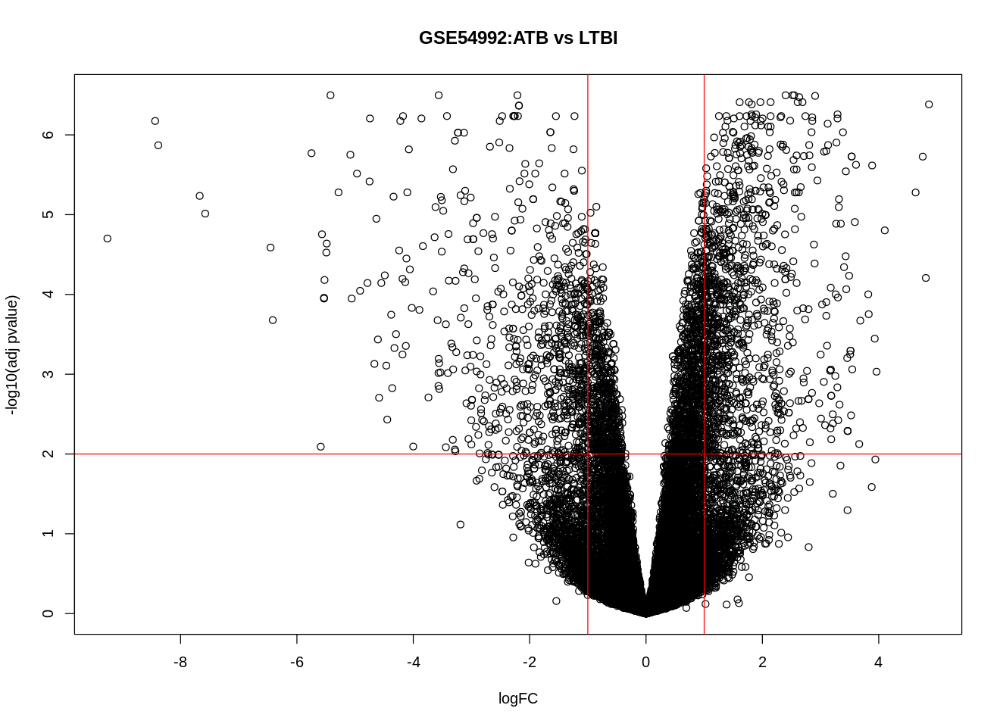

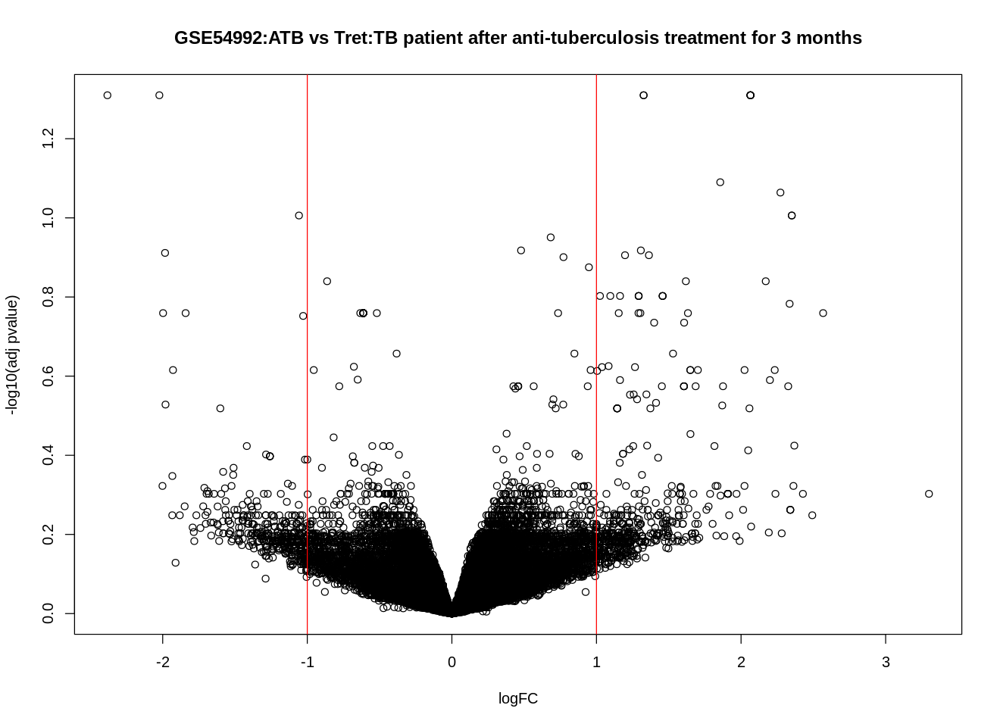

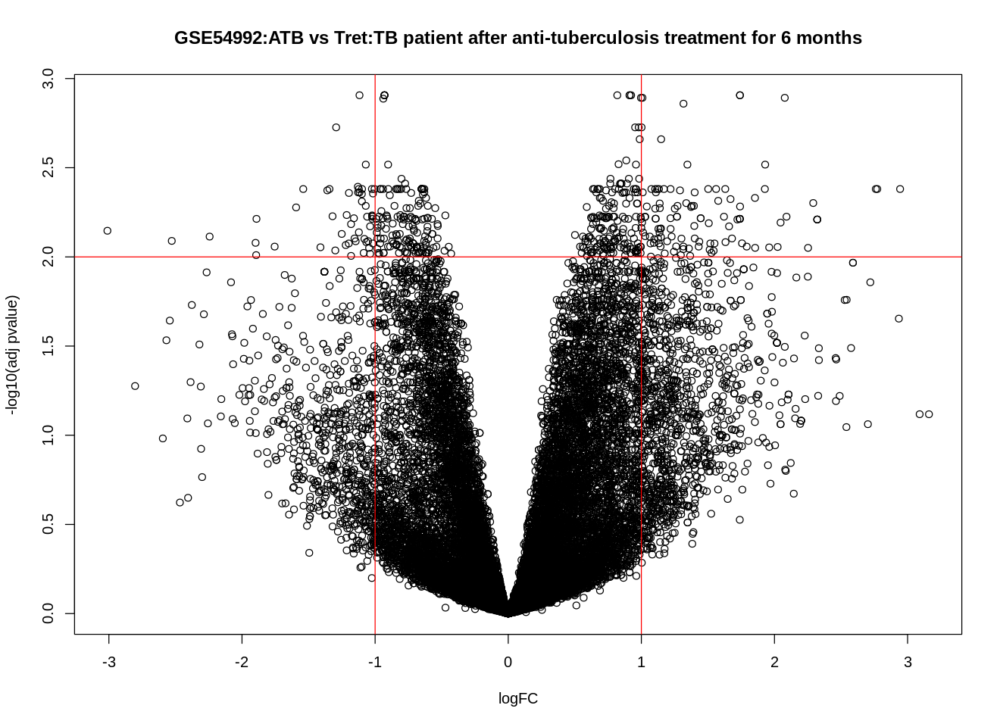

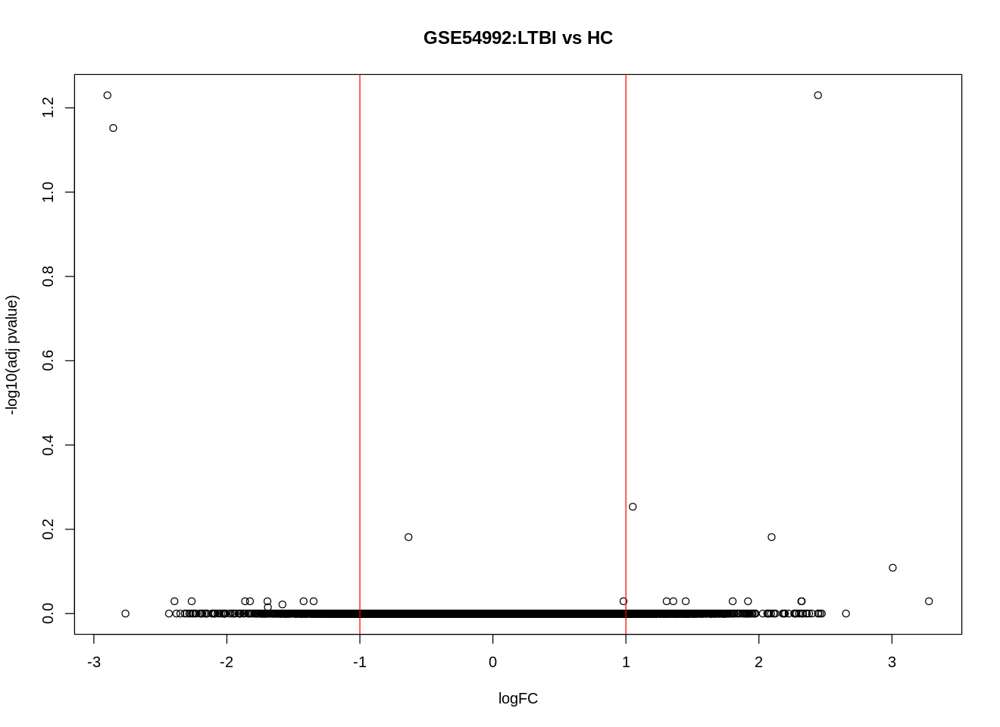

In [173]:
# Perform differential gene expression analysis
df <- diff_exp_array_analysis(GSE_ID, data, def, diff_exp_data, norm_exp_data)
dsets <- rbind(dsets,df$dsets)

##### Dataset 18 -- GSE62147:  Berlin M. tuberculosis and M. africanum patients under TB treatment (microarray, GPL6480)
- Subjects: 52
- Disease status: Peripheral blood Maf_post(n=12),Peripheral blood Maf_recruit(n=12), Peripheral blood Mtb_post(n=14) and Peripheral blood Mtb_recruit(n=14)
- Disease status definition: M. tuberculosis and M. africanum patients under TB treatment

Found 1 file(s)

GSE62147_series_matrix.txt.gz

Rows: 41091 Columns: 53

── Column specification ────────────────────────────────────────────────────────
Delimiter: "\t"
chr  (1): ID_REF
dbl (52): GSM1520356, GSM1520357, GSM1520358, GSM1520359, GSM1520360, GSM152...


ℹ Use `spec()` to retrieve the full column specification for this data.
ℹ Specify the column types or set `show_col_types = FALSE` to quiet this message.

File stored at: 

/tmp/Rtmpd2Px0H/GPL6480.soft

Warning message:
“One or more parsing issues, see `problems()` for details”


         Length Class  Mode
GSE62147 1      -none- list
[1] "GSE62147_series_matrix.txt.gz"


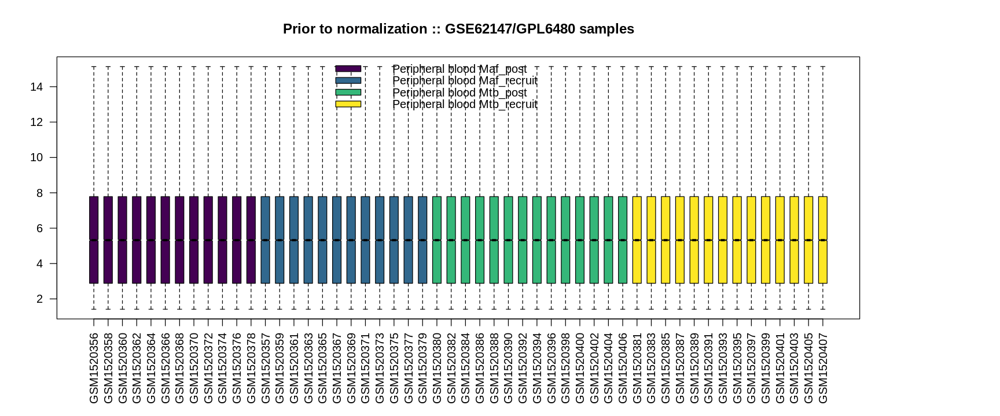

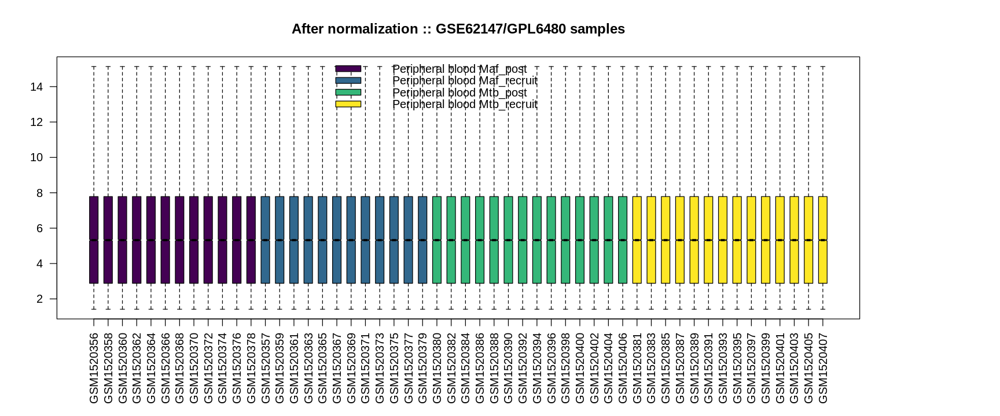

In [5]:
GSE_ID <- "GSE62147"
def <- dataset_info(GSE_ID)
#Fetch and process data
data <- array_process_qc(GSE_ID, def$stage, norm_exp_data, TRUE)

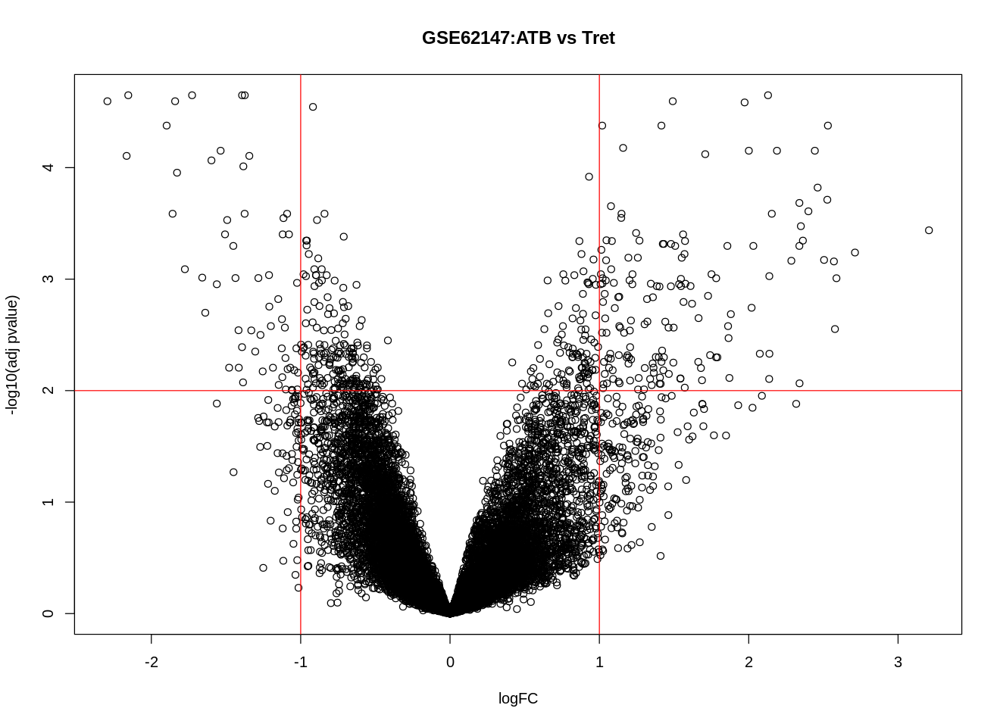

In [6]:
# Perform differential gene expression analysis
df <- diff_exp_array_analysis(GSE_ID, data, def, diff_exp_data, norm_exp_data)
dsets <- rbind(dsets,df$dsets)

##### Dataset 19 -- GSE62525: Taiwanese (microarray, GPL16951)
- Subjects: 42
- Two replicates included per subject 
- Disease status: active TB (n=14), latent TB infection (n=14), and healthy control (n=14)

Found 1 file(s)

GSE62525_series_matrix.txt.gz

Using locally cached version: /tmp/Rtmph8pCbI/GSE62525_series_matrix.txt.gz

Rows: 31741 Columns: 43

── Column specification ────────────────────────────────────────────────────────
Delimiter: "\t"
chr  (1): ID_REF
dbl (42): GSM1528336, GSM1528337, GSM1528338, GSM1528339, GSM1528340, GSM152...


ℹ Use `spec()` to retrieve the full column specification for this data.
ℹ Specify the column types or set `show_col_types = FALSE` to quiet this message.

Using locally cached version of GPL16951 found here:
/tmp/Rtmph8pCbI/GPL16951.soft 



         Length Class  Mode
GSE62525 1      -none- list
[1] "GSE62525_series_matrix.txt.gz"


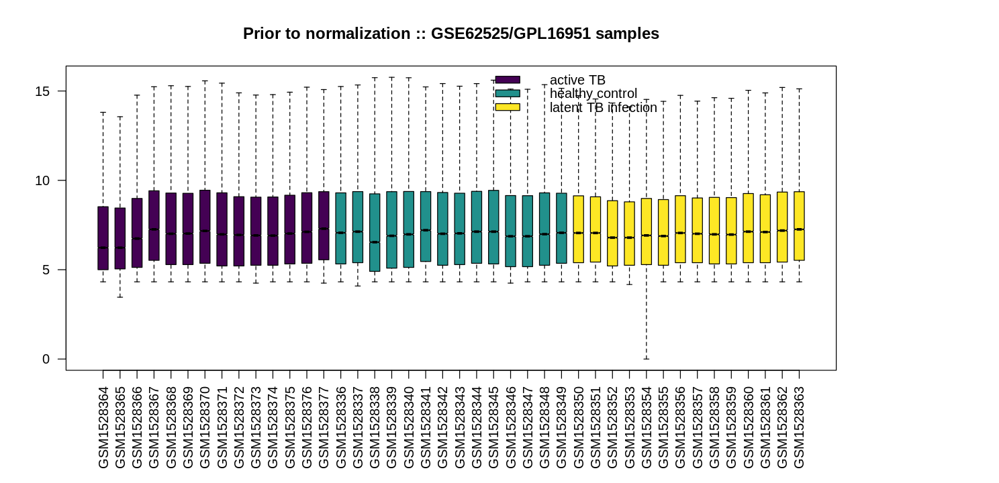

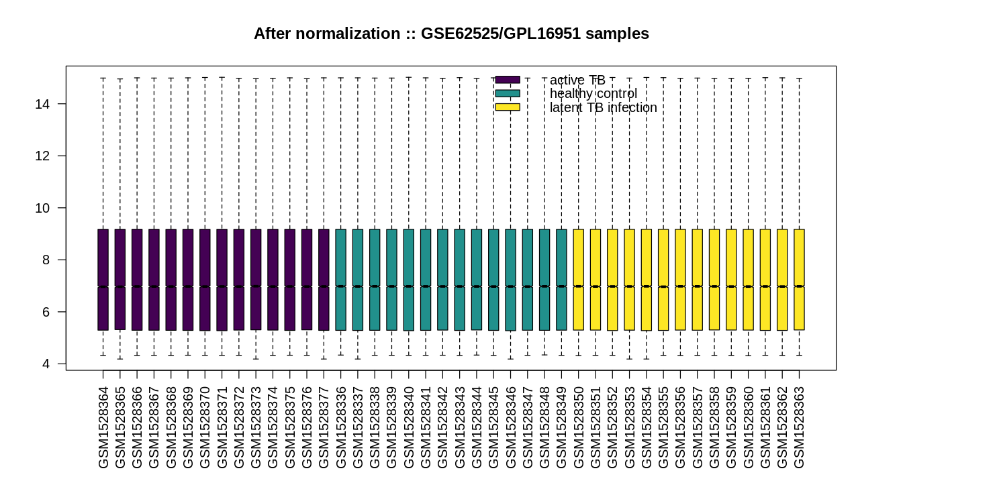

In [176]:
GSE_ID <- "GSE62525"
def <- dataset_info(GSE_ID)
#Fetch and process data
data <- array_process_qc(GSE_ID, def$stage, norm_exp_data, TRUE)

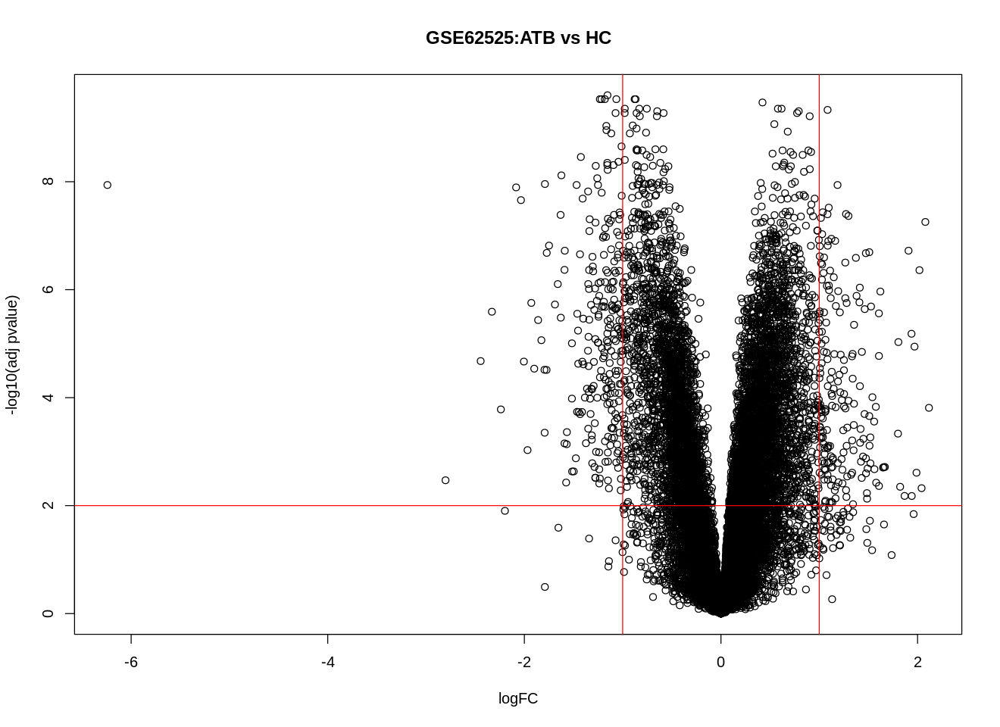

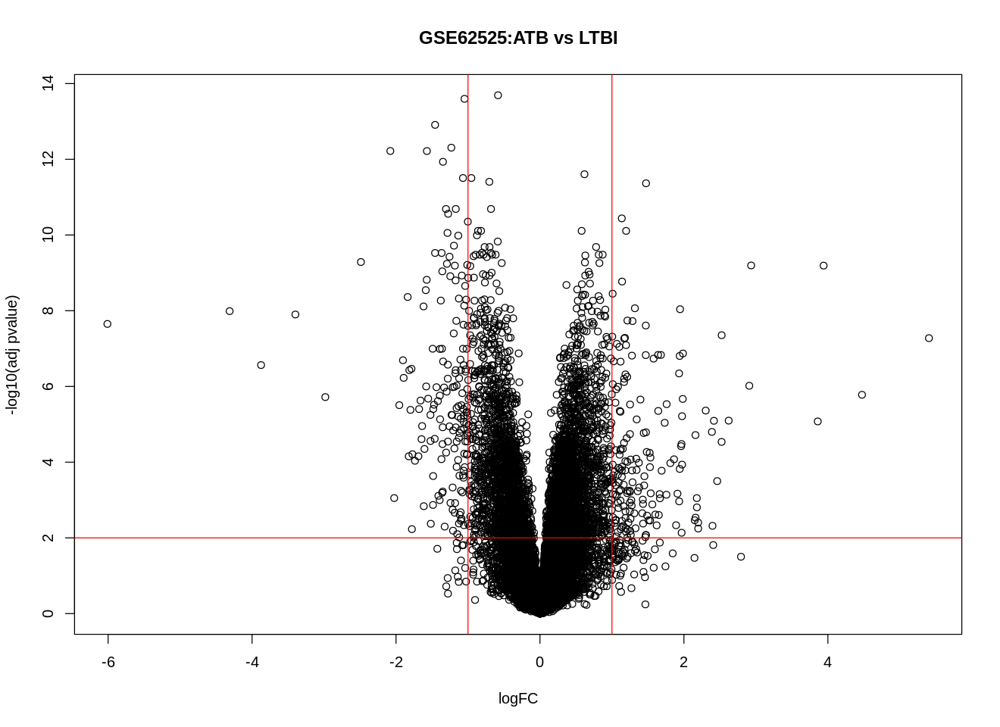

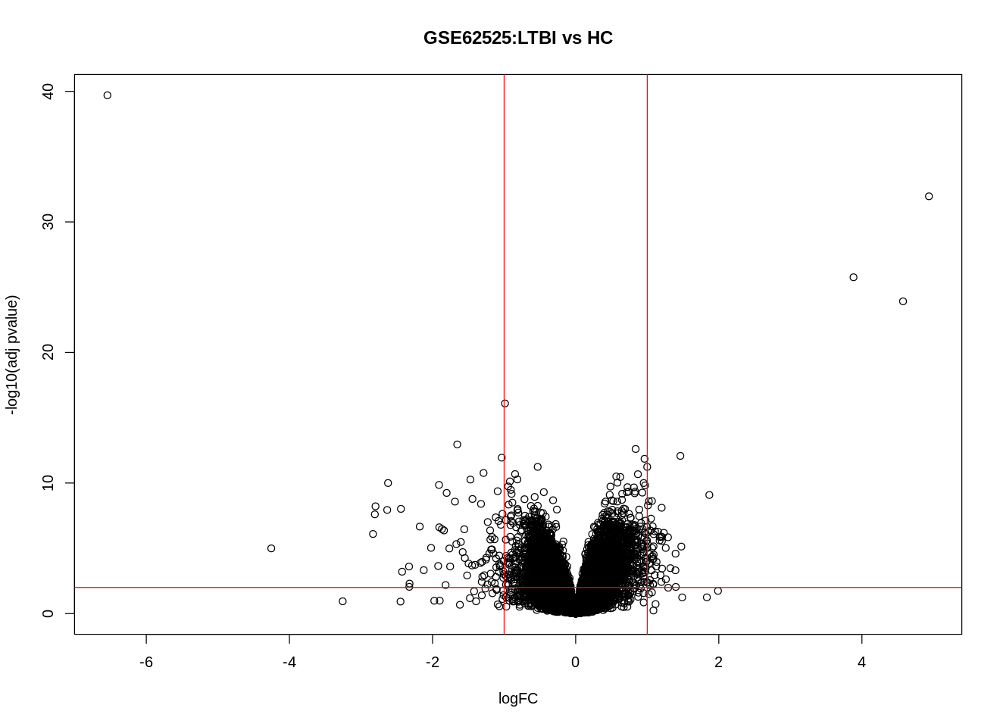

In [177]:
# Perform differential gene expression analysis
df <- diff_exp_array_analysis(GSE_ID, data, def, diff_exp_data, norm_exp_data)
dsets <- rbind(dsets,df$dsets)

##### Dataset 20 -- GSE69581:  South Africa HIV infected latent /active TB patients (microarray, GPL10558)
- Subjects: 50
- Disease status: Active(n=15),Latent(n=25), and Subclinical(n=10)
- Disease status definition: active: symptomatic microbiologically confirmed active pulmonary TB. Subclinical had pulmonary abnormalities consistent with subclinical disease and were significantly more likely to progress

Found 1 file(s)

GSE69581_series_matrix.txt.gz

Using locally cached version: /tmp/Rtmph8pCbI/GSE69581_series_matrix.txt.gz

Rows: 47231 Columns: 51

── Column specification ────────────────────────────────────────────────────────
Delimiter: "\t"
chr  (1): ID_REF
dbl (50): GSM1704154, GSM1704155, GSM1704156, GSM1704157, GSM1704158, GSM170...


ℹ Use `spec()` to retrieve the full column specification for this data.
ℹ Specify the column types or set `show_col_types = FALSE` to quiet this message.

Using locally cached version of GPL10558 found here:
/tmp/Rtmph8pCbI/GPL10558.soft 

Warning message:
“One or more parsing issues, see `problems()` for details”


         Length Class  Mode
GSE69581 1      -none- list
[1] "GSE69581_series_matrix.txt.gz"


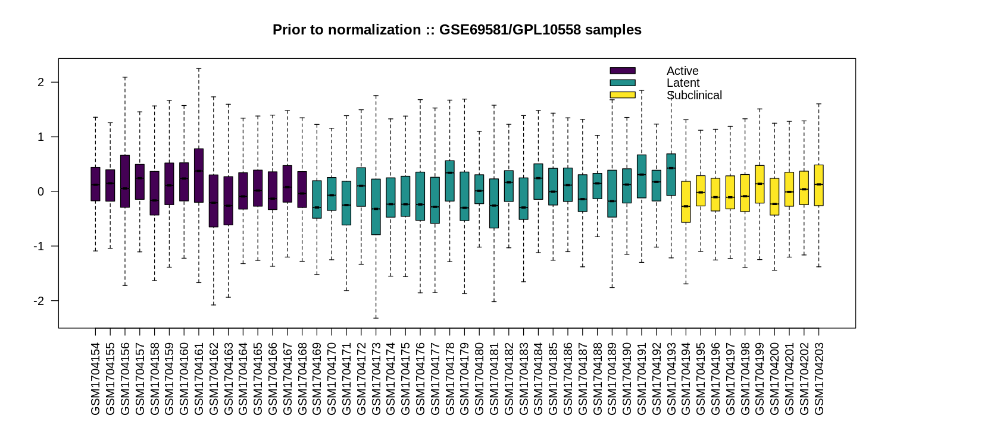

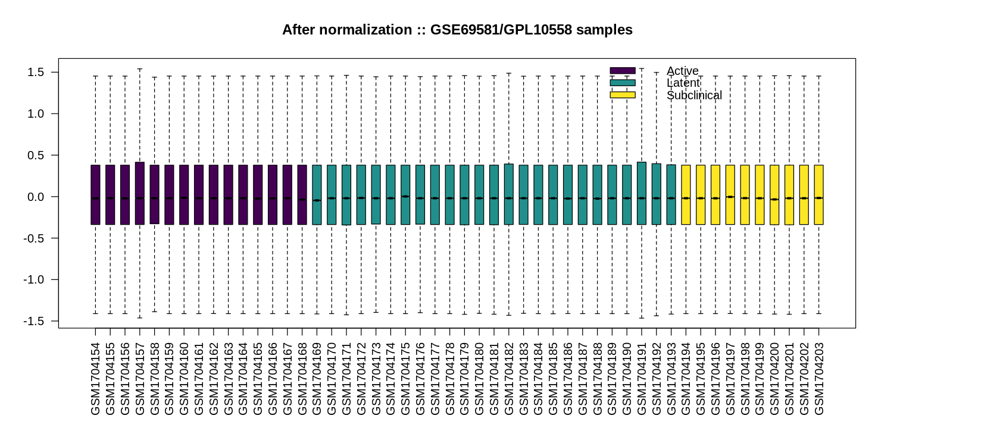

In [178]:
GSE_ID <- "GSE69581"
def <- dataset_info(GSE_ID)
#Fetch and process data
data <- array_process_qc(GSE_ID, def$stage, norm_exp_data, TRUE)

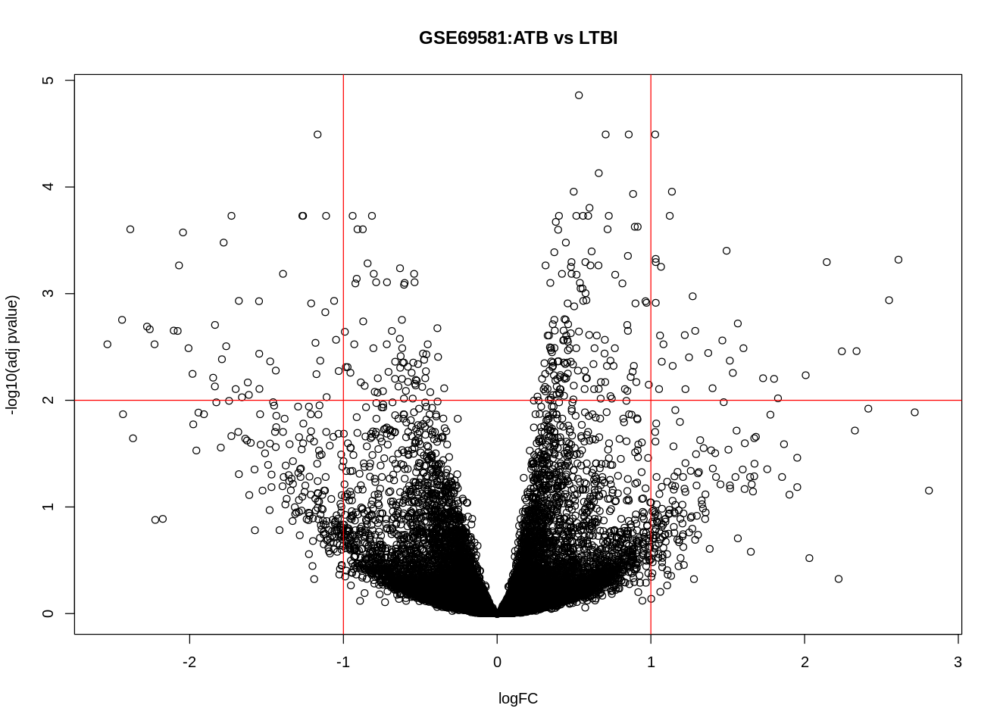

In [179]:
# Perform differential gene expression analysis
df <- diff_exp_array_analysis(GSE_ID, data, def, diff_exp_data, norm_exp_data)
dsets <- rbind(dsets,df$dsets)

##### Dataset 21 -- GSE73408:  US patients with TB and pneumonia  (microarray, GPL11532)
- Subjects: 109
- Disease status: TB(n=35),LTBI(n=35), and PNA(pneumonia)(n=39)
- Disease status definition: TB, LTBI, and PNA(pneumonia)

Found 1 file(s)

GSE73408_series_matrix.txt.gz

Using locally cached version: /tmp/Rtmph8pCbI/GSE73408_series_matrix.txt.gz

Rows: 21734 Columns: 110

── Column specification ────────────────────────────────────────────────────────
Delimiter: "\t"
dbl (110): ID_REF, GSM1892913, GSM1892914, GSM1892915, GSM1892916, GSM189291...


ℹ Use `spec()` to retrieve the full column specification for this data.
ℹ Specify the column types or set `show_col_types = FALSE` to quiet this message.

Using locally cached version of GPL11532 found here:
/tmp/Rtmph8pCbI/GPL11532.soft 



         Length Class  Mode
GSE73408 1      -none- list
[1] "GSE73408_series_matrix.txt.gz"


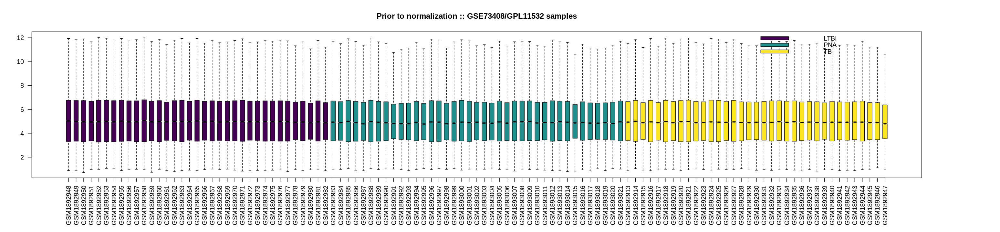

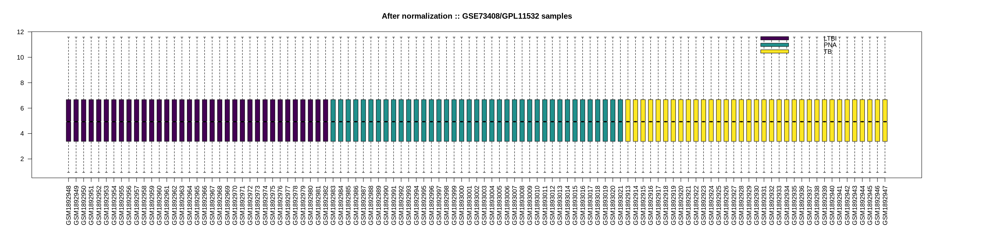

In [180]:
GSE_ID <- "GSE73408"
def <- dataset_info(GSE_ID)
#Fetch and process data
data <- array_process_qc(GSE_ID, def$stage, norm_exp_data, TRUE)

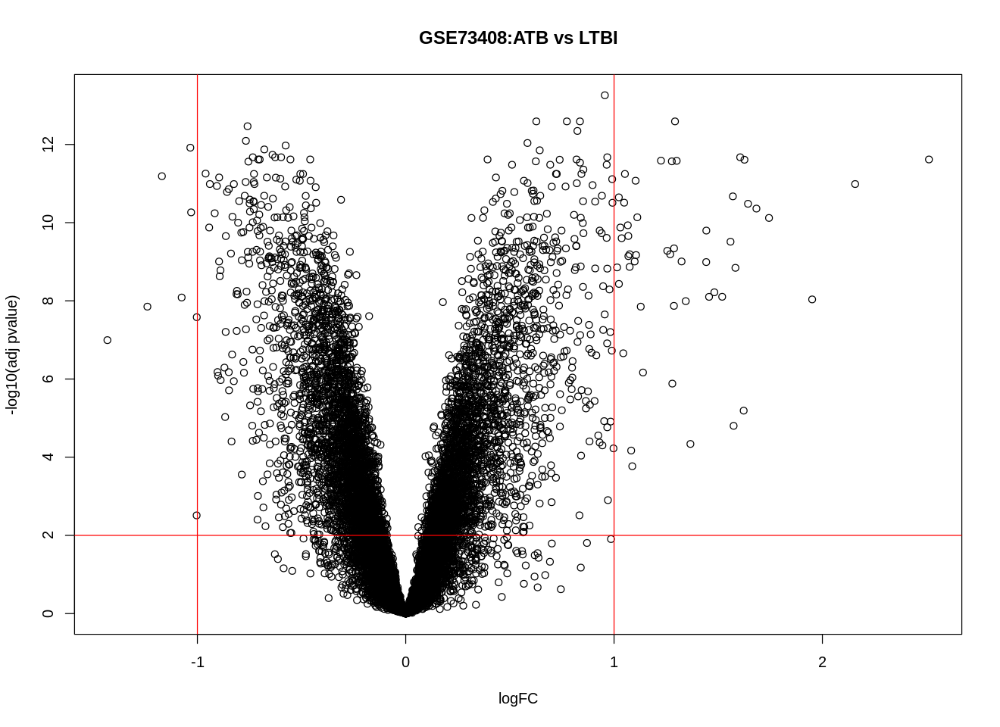

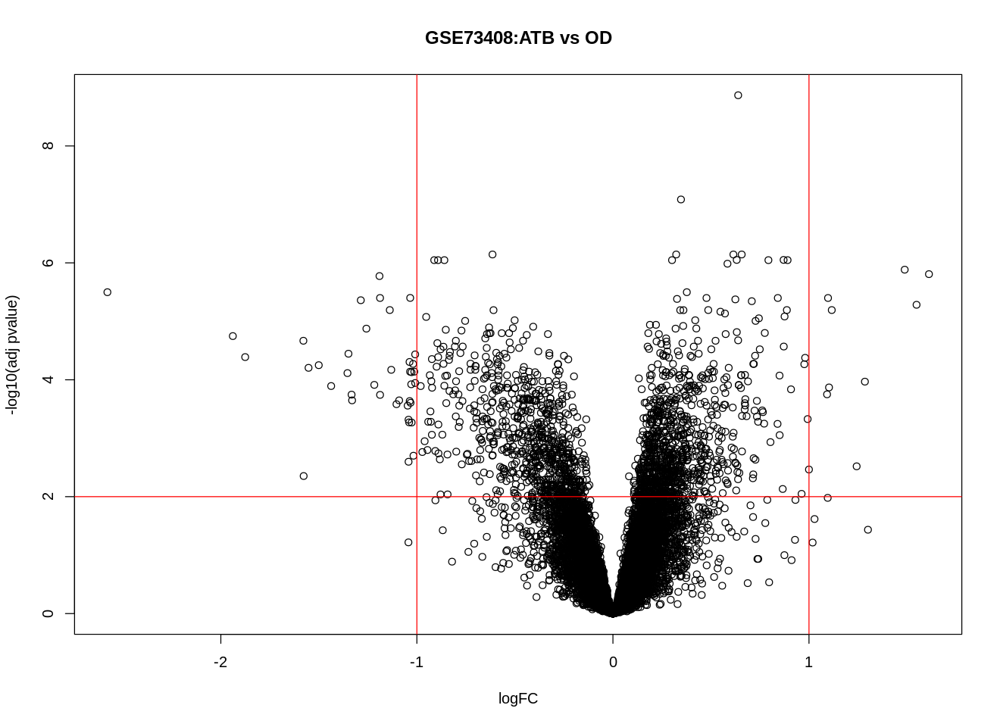

In [181]:
# Perform differential gene expression analysis
df <- diff_exp_array_analysis(GSE_ID, data, def, diff_exp_data, norm_exp_data)
dsets <- rbind(dsets,df$dsets)

##### Dataset 22 -- GSE83456:  UK  (microarray, GPL10558)
- Subjects: 202
- Disease status: EPTB (n=47), PTB (n=45), HC (n=61) and Sarcoid (n=49)
- Disease status definition: 61 healthy human controls, 47 human with EPTB (extra-pulmonary TB), 45 human with PTB (pulmonary TB), 49 human with Sarcoid

Found 1 file(s)

GSE83456_series_matrix.txt.gz

Using locally cached version: /tmp/Rtmph8pCbI/GSE83456_series_matrix.txt.gz

Rows: 47231 Columns: 203

── Column specification ────────────────────────────────────────────────────────
Delimiter: "\t"
chr   (1): ID_REF
dbl (202): GSM2203540, GSM2203541, GSM2203542, GSM2203543, GSM2203544, GSM22...


ℹ Use `spec()` to retrieve the full column specification for this data.
ℹ Specify the column types or set `show_col_types = FALSE` to quiet this message.

Using locally cached version of GPL10558 found here:
/tmp/Rtmph8pCbI/GPL10558.soft 

Warning message:
“One or more parsing issues, see `problems()` for details”


         Length Class  Mode
GSE83456 1      -none- list
[1] "GSE83456_series_matrix.txt.gz"


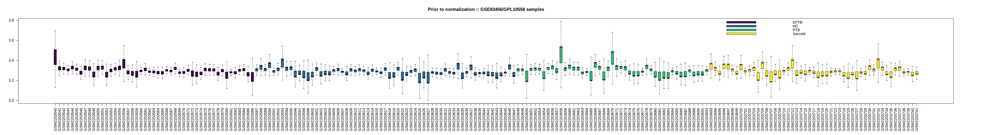

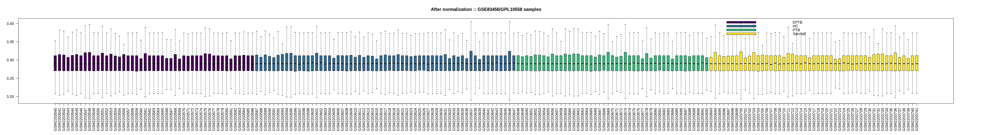

In [182]:
GSE_ID <- "GSE83456"
def <- dataset_info(GSE_ID)
#Fetch and process data
data <- array_process_qc(GSE_ID, def$stage, norm_exp_data, TRUE)

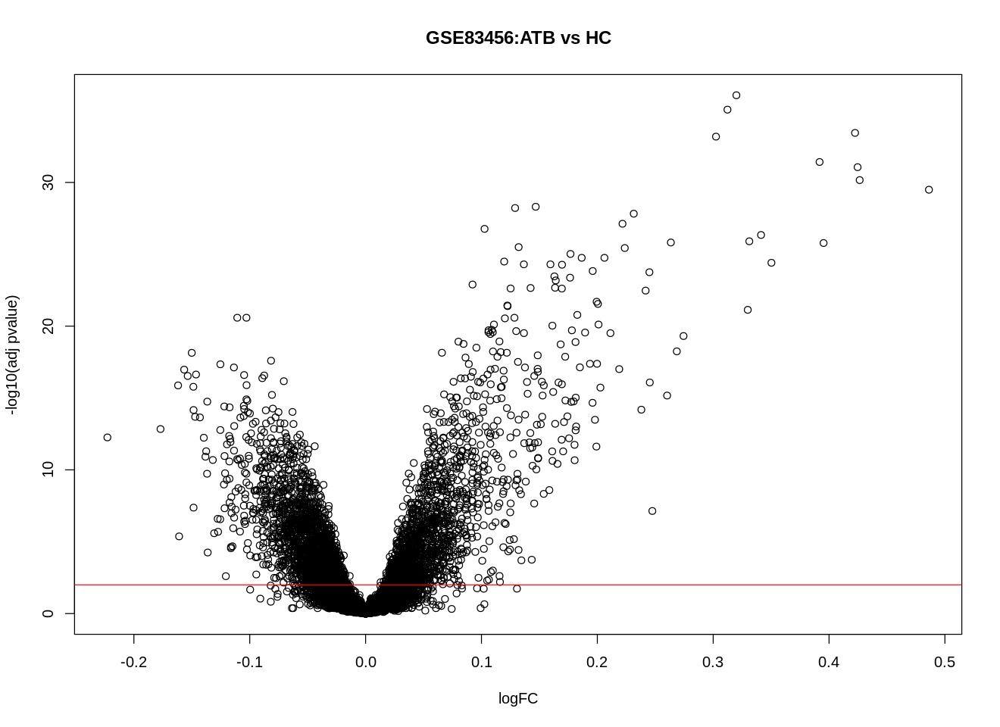

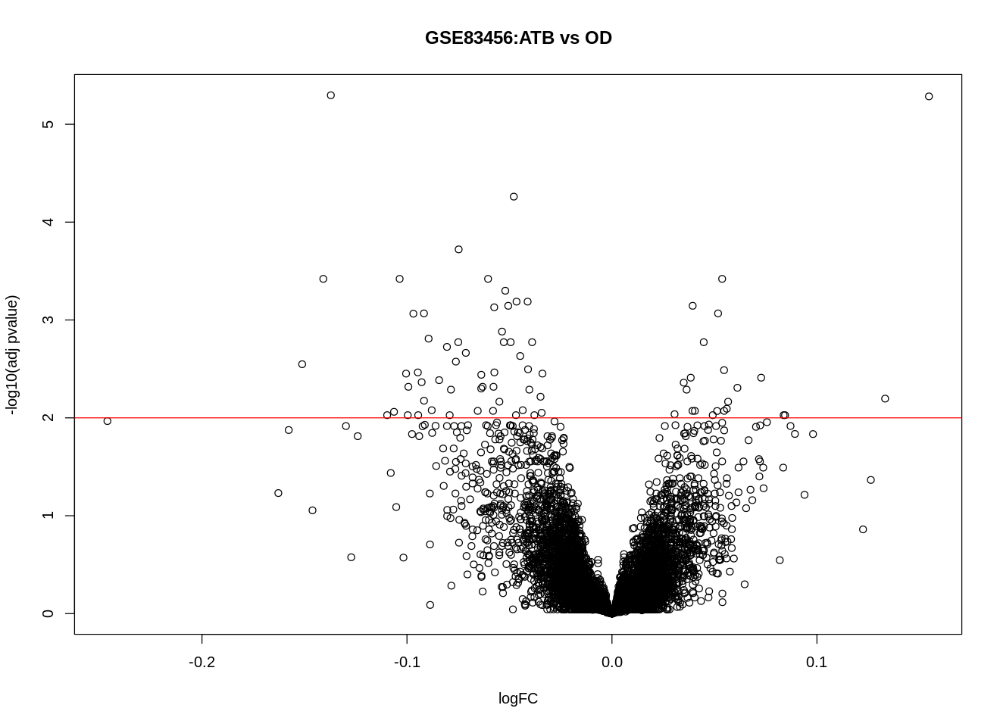

In [183]:
# Perform differential gene expression analysis
df <- diff_exp_array_analysis(GSE_ID, data, def, diff_exp_data, norm_exp_data)
dsets <- rbind(dsets,df$dsets)

##### Dataset 23 -- GSE40553:  UK and south african treatment data  (microarray, GPL10558)
- Subjects: 29
- Disease status: 
- Disease status definition: before treatment to indentify changes that occur during (2 weeks, 2 months), at the end of treatment (6 months) and after treatment (12 months)

Found 1 file(s)

GSE40553_series_matrix.txt.gz

Using locally cached version: /tmp/Rtmph8pCbI/GSE40553_series_matrix.txt.gz

Rows: 47323 Columns: 205

── Column specification ────────────────────────────────────────────────────────
Delimiter: "\t"
chr   (1): ID_REF
dbl (204): GSM996267, GSM996268, GSM996269, GSM996270, GSM996271, GSM996272,...


ℹ Use `spec()` to retrieve the full column specification for this data.
ℹ Specify the column types or set `show_col_types = FALSE` to quiet this message.

Warning message:
“One or more parsing issues, see `problems()` for details”
Using locally cached version of GPL10558 found here:
/tmp/Rtmph8pCbI/GPL10558.soft 

Warning message:
“One or more parsing issues, see `problems()` for details”


         Length Class  Mode
GSE40553 1      -none- list
[1] "GSE40553_series_matrix.txt.gz"


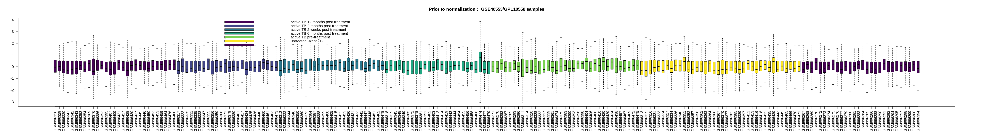

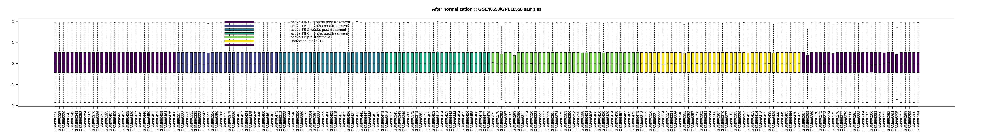

In [184]:
GSE_ID <- "GSE40553"
def <- dataset_info(GSE_ID)
#Fetch and process data
data <- array_process_qc(GSE_ID, def$stage, norm_exp_data, TRUE)

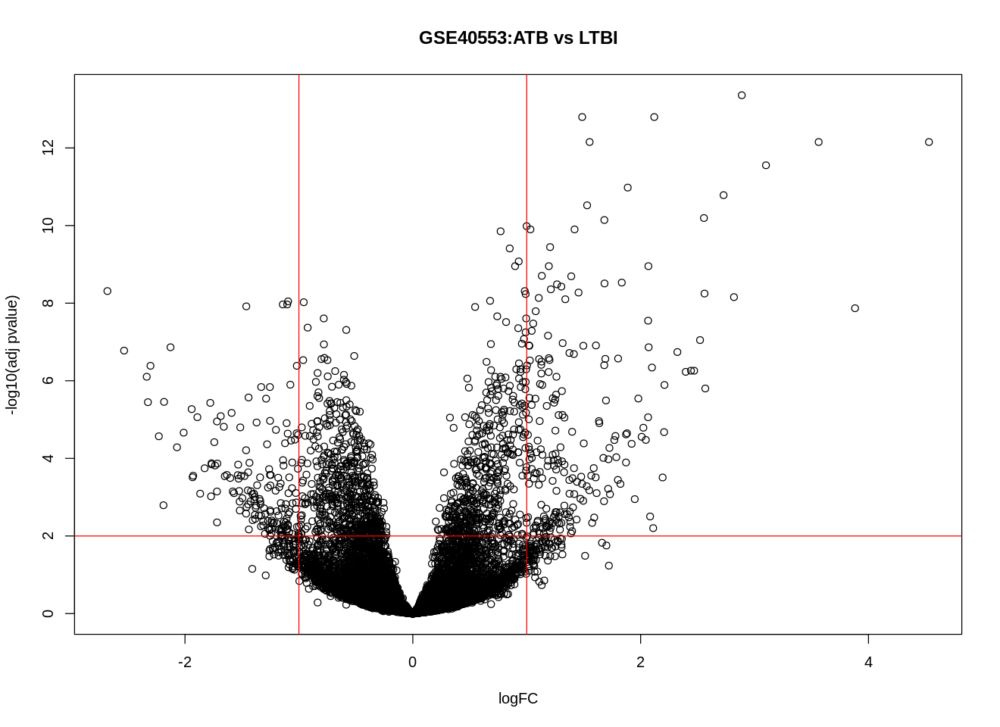

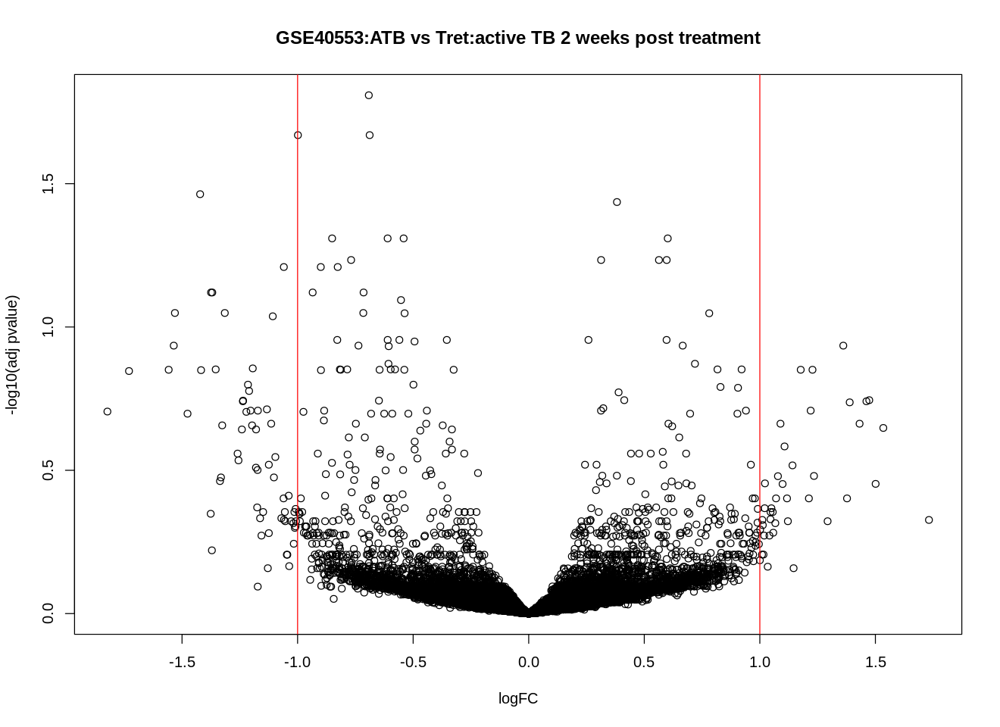

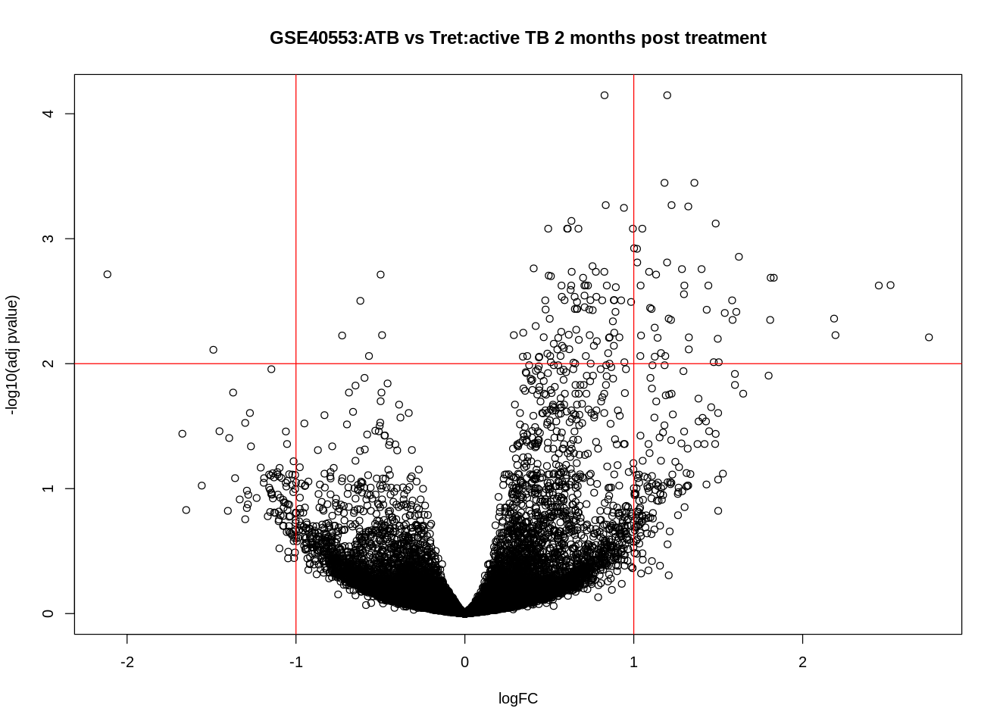

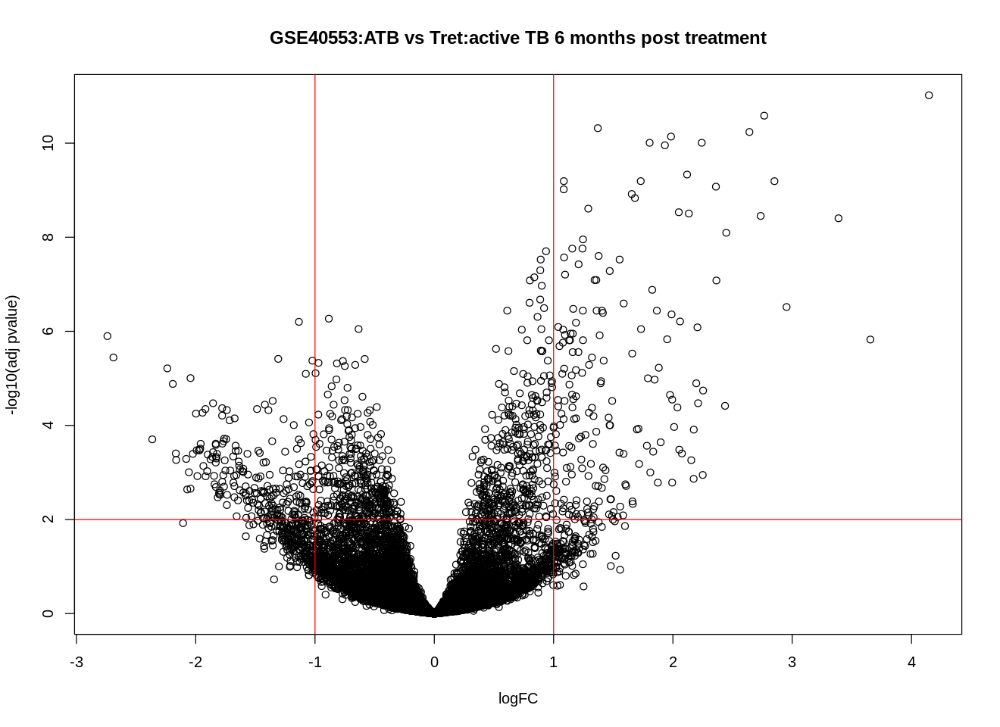

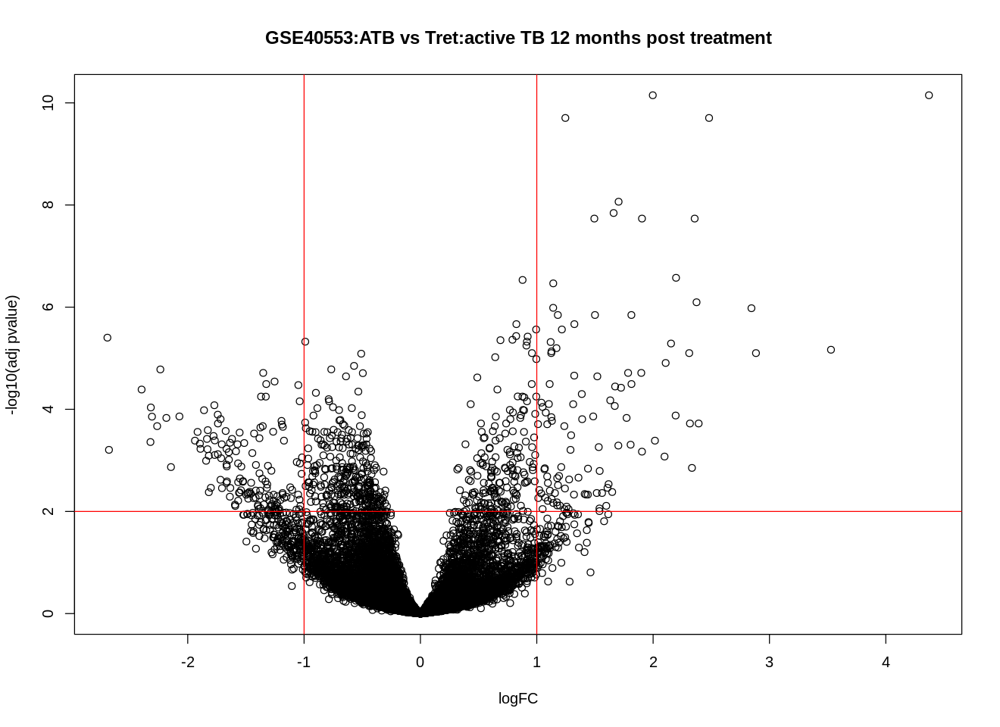

In [185]:
# Perform differential gene expression analysis
df <- diff_exp_array_analysis(GSE_ID, data, def, diff_exp_data, norm_exp_data)
dsets <- rbind(dsets,df$dsets)

##### Dataset 24 -- GSE31348 & GSE36238:  (microarray, GPL570)
- Subjects: 36
- Disease status: 
- Disease status definition: smear-positive patients, 18–65 years of age, infected with isoniazid- and rifampicin-sensitive bacilli, characterized as moderate or severe disease by chest X ray. Ex vivo blood samples analysed for 27 first episode pulmonary TB patients, at diagnosis and after 1, 2, 4 and 26 weeks of treatment. In addition, these samples are from 9 successfully cured patients at diagnosis and end-of-treatment at 26 weeks

Found 1 file(s)

GSE31348_series_matrix.txt.gz

Using locally cached version: /tmp/Rtmph8pCbI/GSE31348_series_matrix.txt.gz

Rows: 54675 Columns: 136

── Column specification ────────────────────────────────────────────────────────
Delimiter: "\t"
chr   (1): ID_REF
dbl (135): GSM777339, GSM777340, GSM777341, GSM777342, GSM777343, GSM777344,...


ℹ Use `spec()` to retrieve the full column specification for this data.
ℹ Specify the column types or set `show_col_types = FALSE` to quiet this message.

Using locally cached version of GPL570 found here:
/tmp/Rtmph8pCbI/GPL570.soft 

Found 1 file(s)

GSE36238_series_matrix.txt.gz

Using locally cached version: /tmp/Rtmph8pCbI/GSE36238_series_matrix.txt.gz

Rows: 54675 Columns: 19

── Column specification ────────────────────────────────────────────────────────
Delimiter: "\t"
chr  (1): ID_REF
dbl (18): GSM884938, GSM884939, GSM884940, GSM884941, GSM884942, GSM884943, ...


ℹ Use `spec()` to retrieve the full column specification for this data

         Length Class  Mode
GSE31348 1      -none- list
GSE36238 1      -none- list
[1] "GSE31348_series_matrix.txt.gz"
[1] "GSE36238_series_matrix.txt.gz"


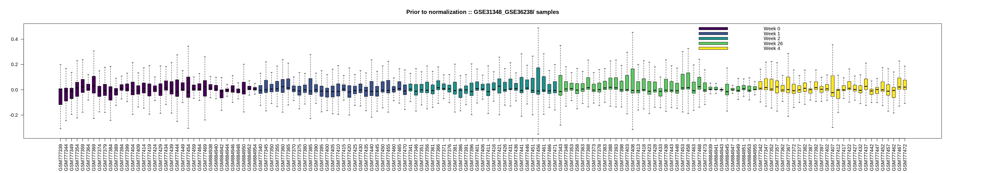

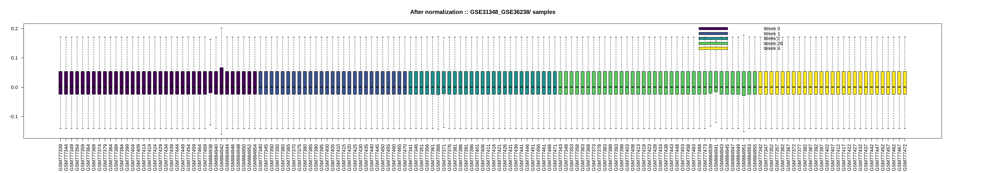

In [186]:
GSE_ID <- "GSE31348_GSE36238"
def <- dataset_info(GSE_ID)
#Fetch and process data
data <- array_process_qc(GSE_ID, def$stage, norm_exp_data, TRUE)

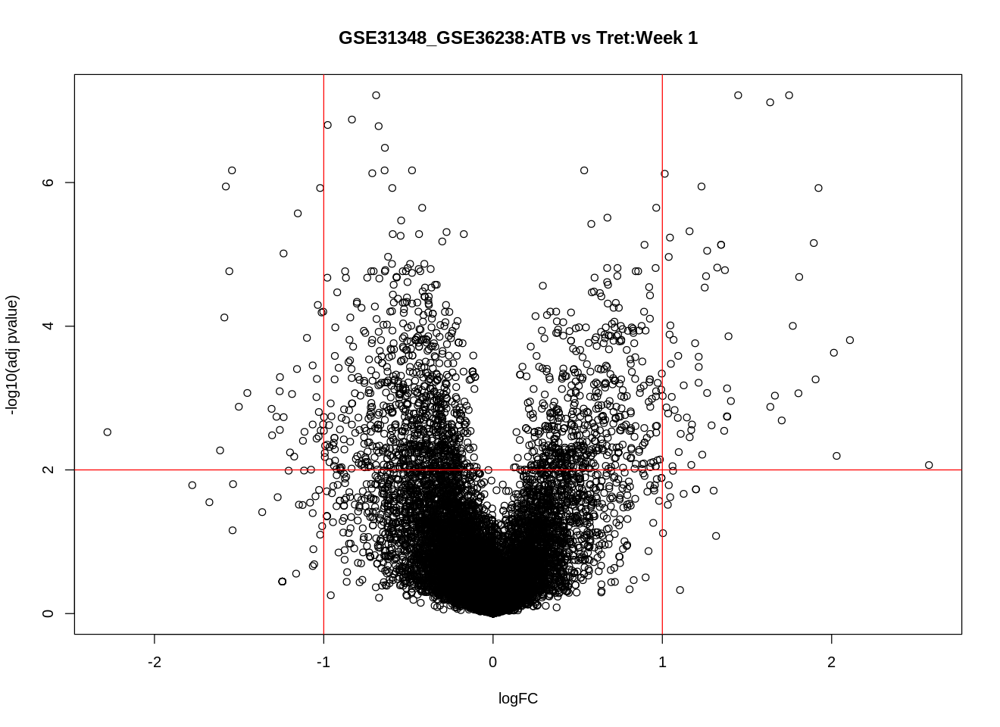

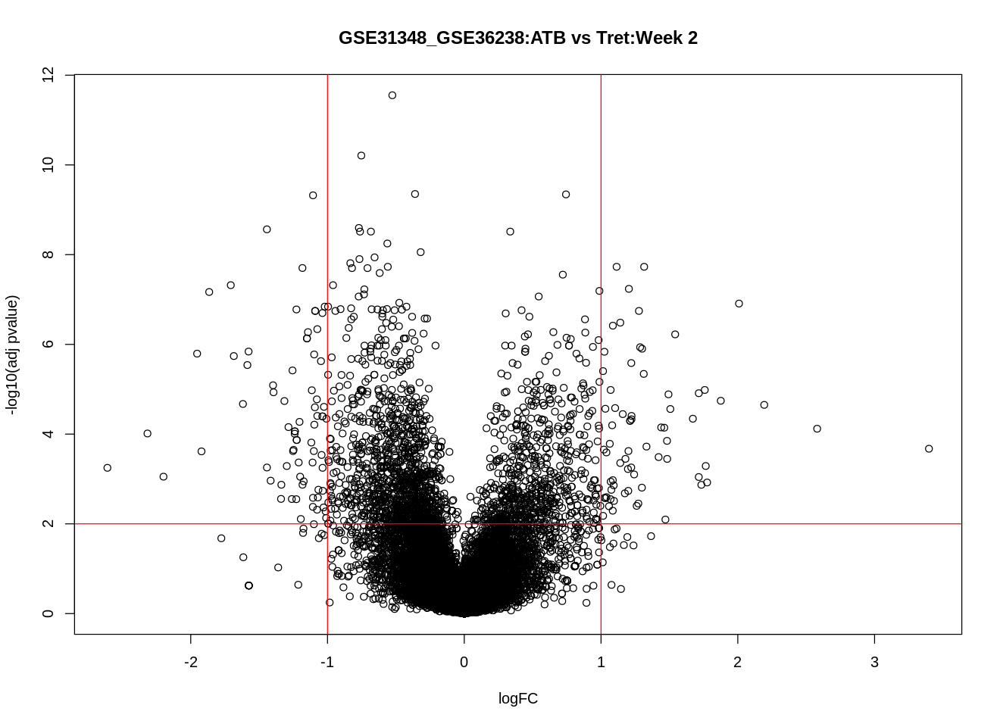

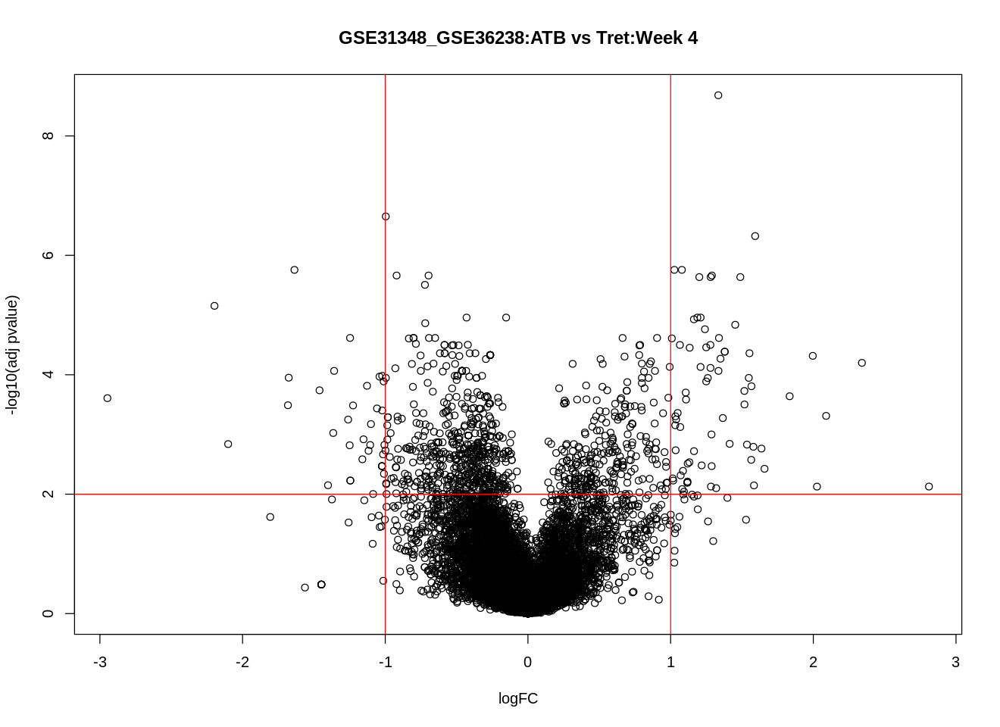

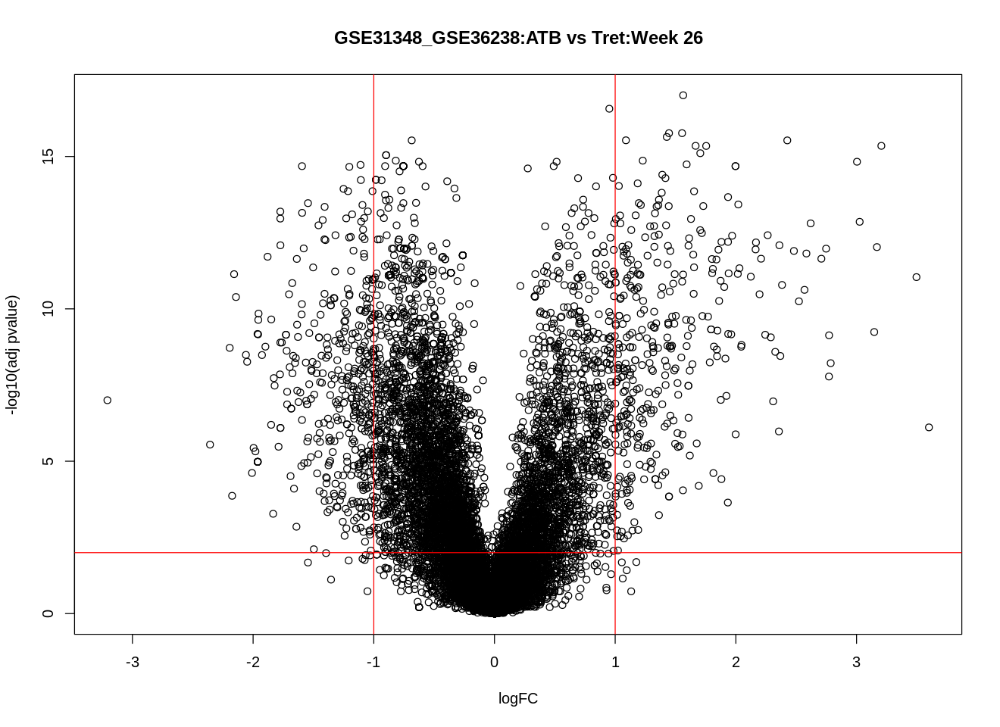

In [187]:
# Perform differential gene expression analysis
df <- diff_exp_array_analysis(GSE_ID, data, def, diff_exp_data, norm_exp_data)
dsets <- rbind(dsets,df$dsets)

## [2] **RNA-seq Data**

##### Dataset 25 -- GSE84076: Brazil, >18 year-old  (Sequencing, GPL16791)
- Subjects: 36
- Disease status: Active Tuberculosis (n=6), Treated Active Tuberculosis (n=2), Latent Tuberculosis - BCG - Unvaccinated/vaccinated (n=16) and Control - BCG - Unvaccinated/vaccinated (n=12)
- Disease status definition: using Cufflinks for normalization
- rawcount = *no*

Found 1 file(s)

GSE84076_series_matrix.txt.gz

Using locally cached version: /tmp/Rtmph8pCbI/GSE84076_series_matrix.txt.gz

Rows: 0 Columns: 37

── Column specification ────────────────────────────────────────────────────────
Delimiter: "\t"
chr (37): ID_REF, GSM2226808, GSM2226809, GSM2226810, GSM2226811, GSM2226812...


ℹ Use `spec()` to retrieve the full column specification for this data.
ℹ Specify the column types or set `show_col_types = FALSE` to quiet this message.

Using locally cached version of GPL16791 found here:
/tmp/Rtmph8pCbI/GPL16791.soft 



         Length Class  Mode
GSE84076 1      -none- list
[1] "GSE84076_series_matrix.txt.gz"



Batch submitting query [===>---------------------------]  14% eta:  4s

Batch submitting query [========>----------------------]  29% eta:  4s

Batch submitting query [============>------------------]  43% eta:  5s

Batch submitting query [=================>-------------]  57% eta:  4s

Batch submitting query [=====================>---------]  71% eta:  3s

Batch submitting query [==========================>----]  86% eta:  3s
                                                                      

Warning message in bxp(list(stats = structure(c(0, 0, 0, 7.3037807481771, 17.5150257040514, :
“some notches went outside hinges ('box'): maybe set notch=FALSE”


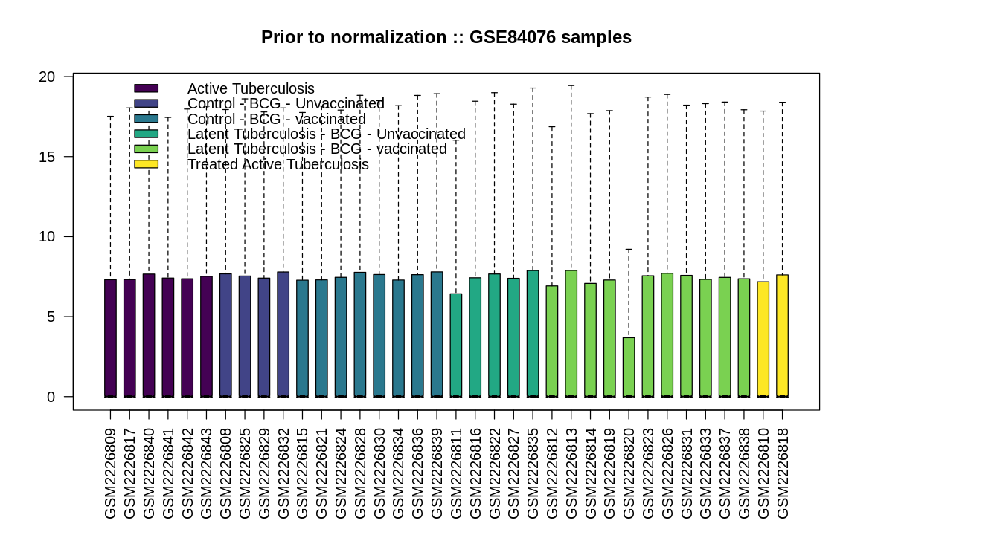

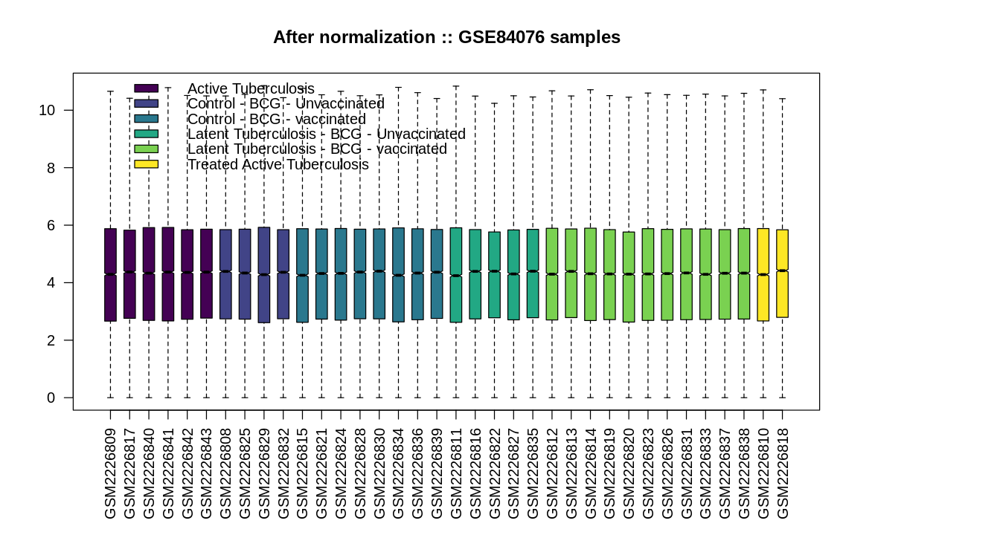

In [214]:
GSE_ID = "GSE84076"
def <- dataset_info(GSE_ID)
data <- seq_process_qc(GSE_ID,def$stage,rnaseq_data,norm_exp_data)

[1] "Diff expression analysis in HC-ATB"


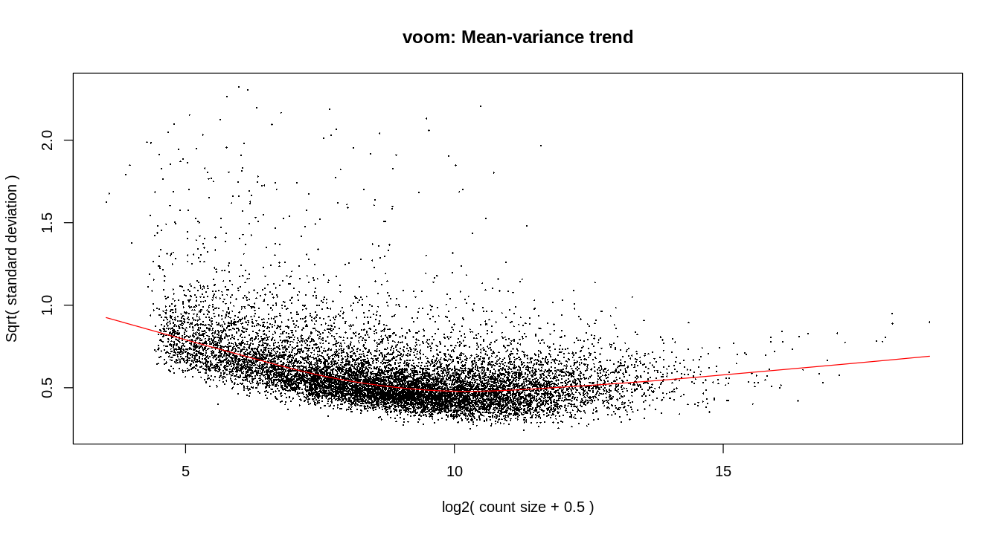

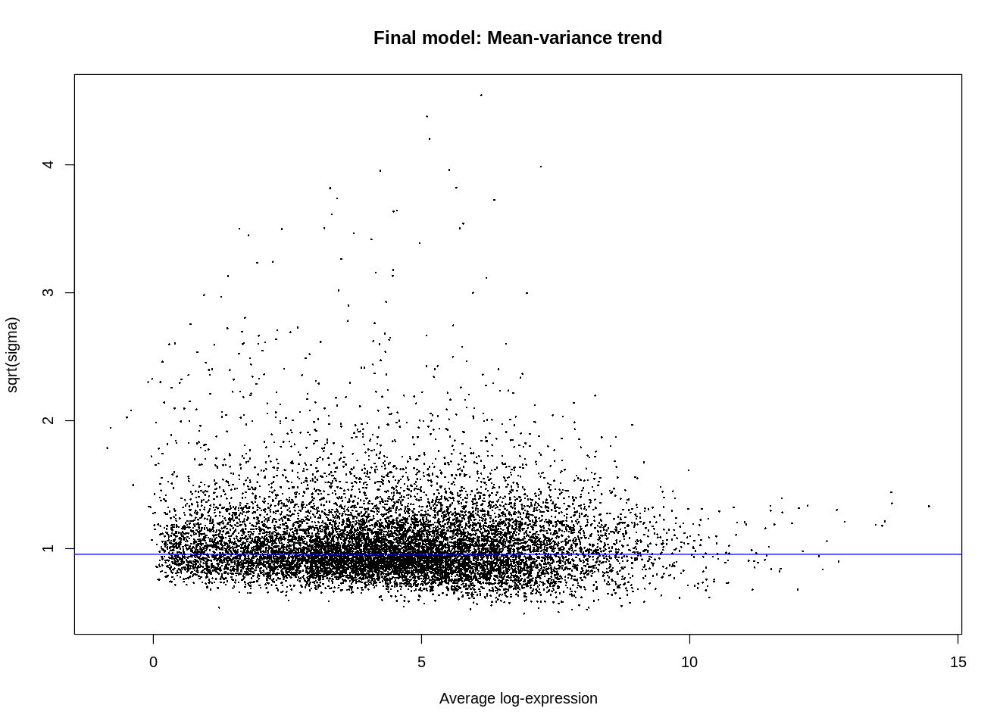

[1] "Diff expression analysis in LTBI-ATB"


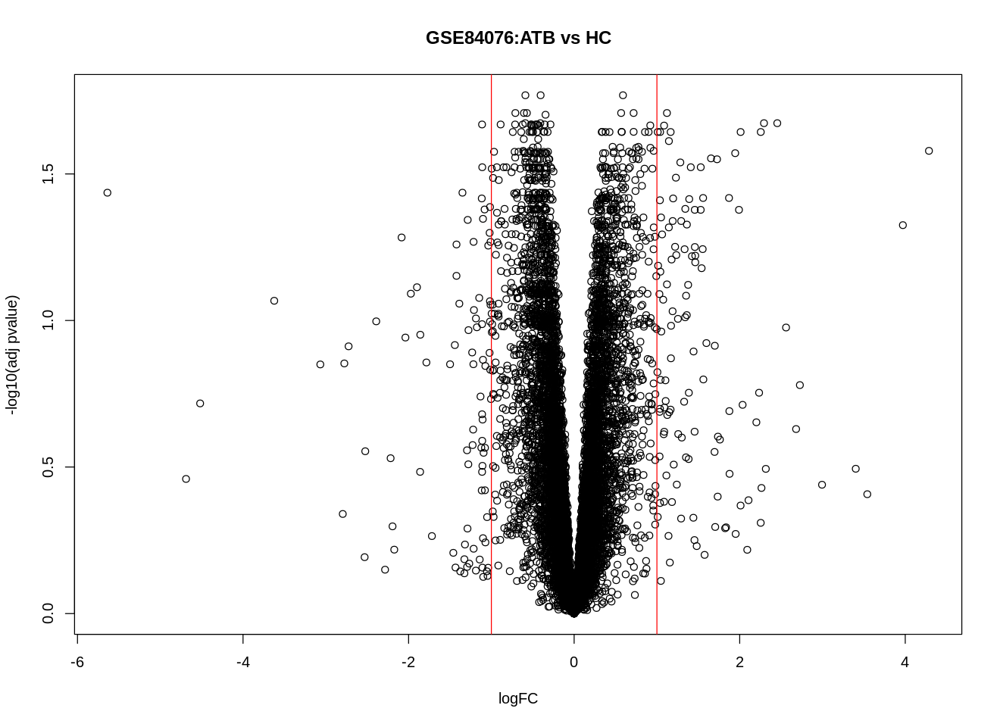

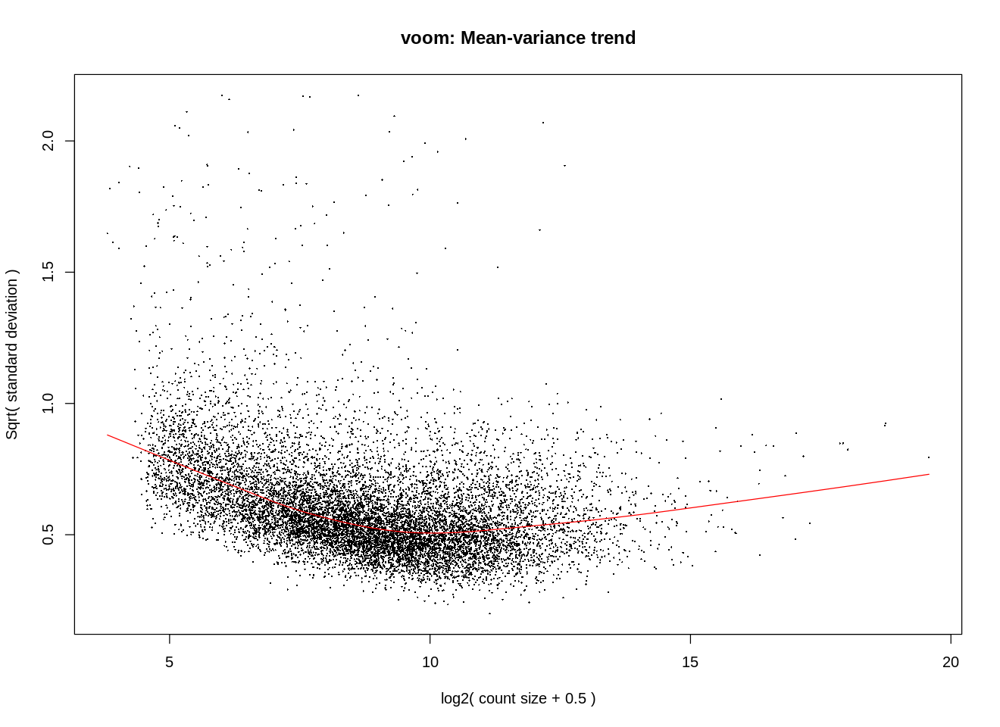

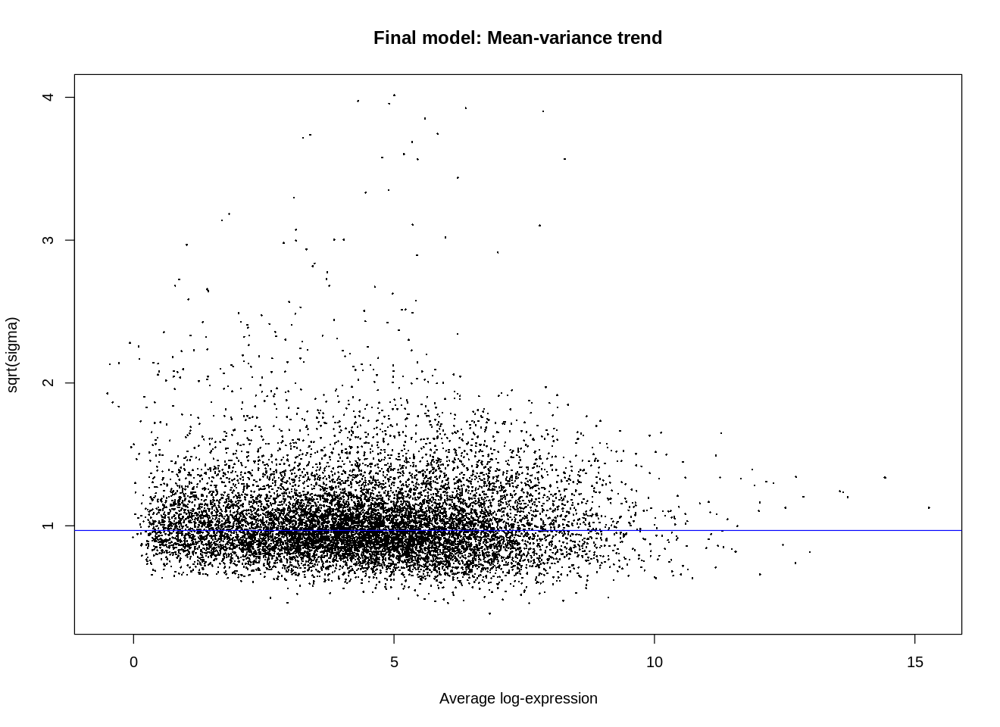

[1] "Diff expression analysis in HC-LTBI"


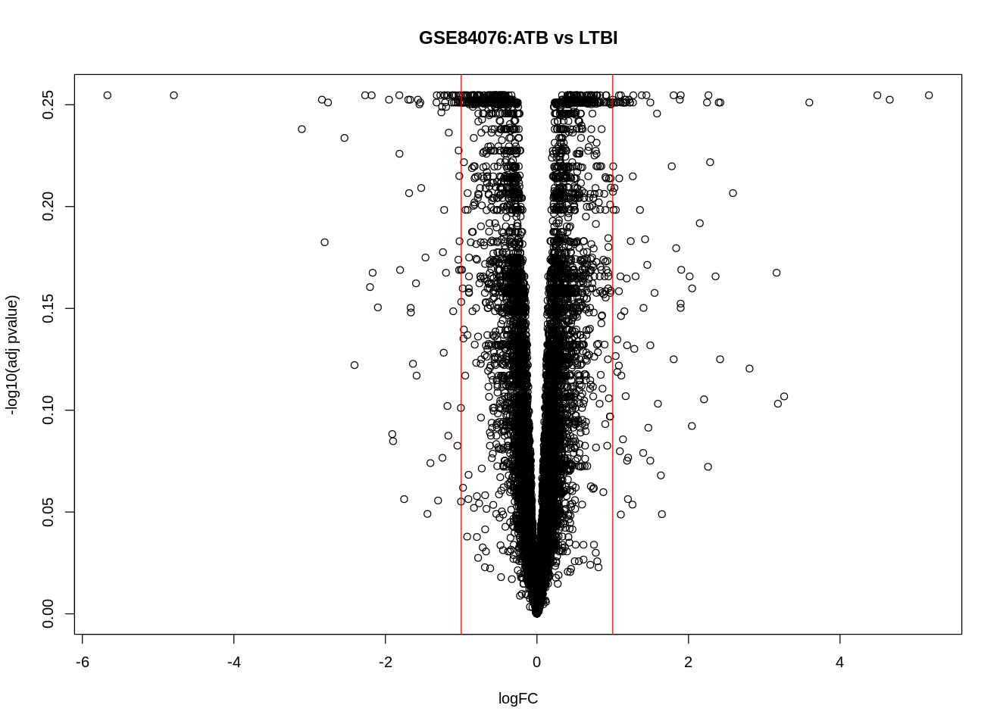

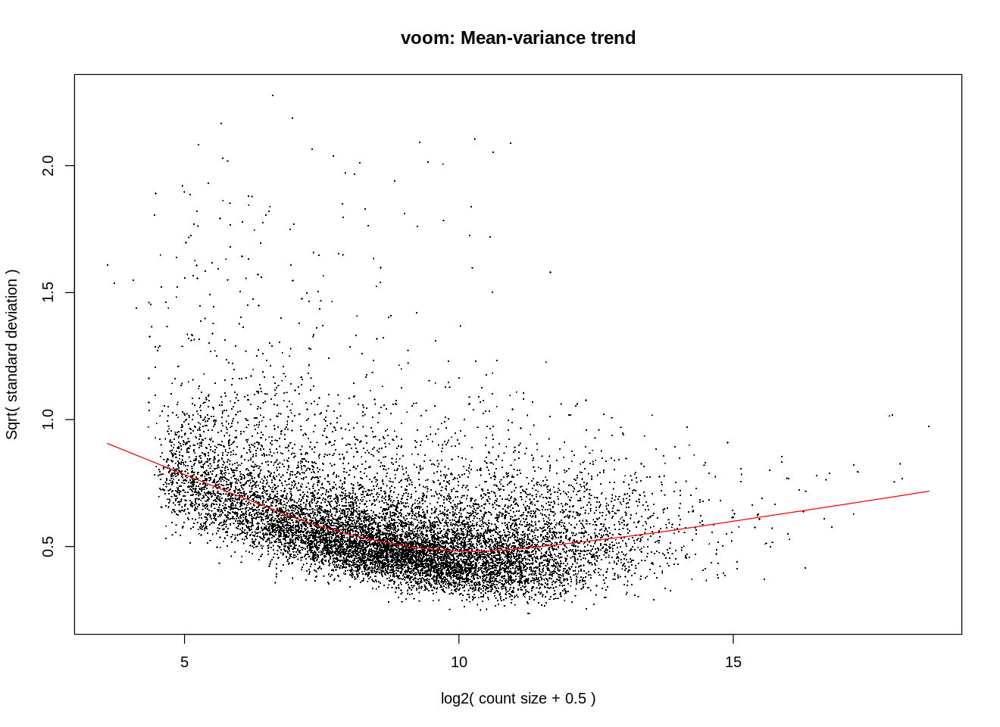

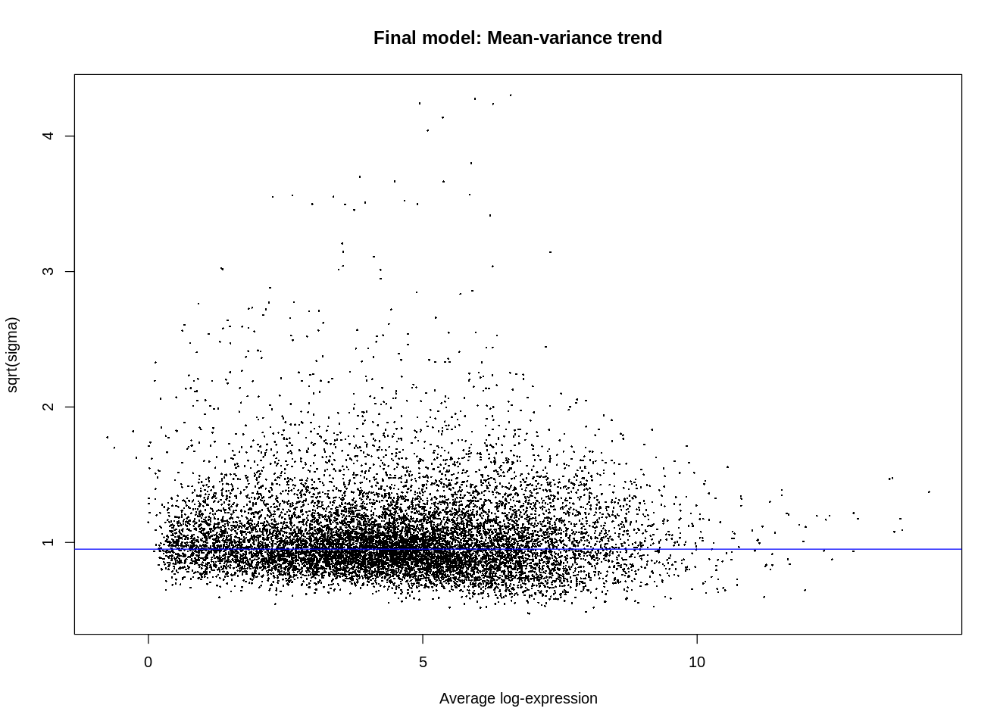

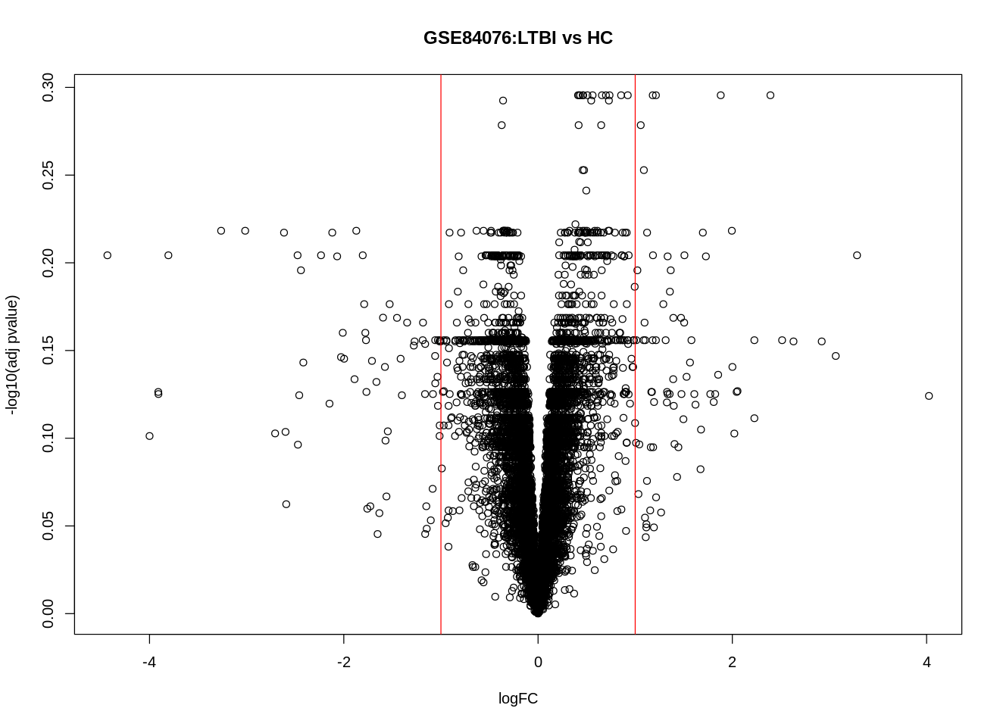

In [215]:
df <- diff_exp_seq_analysis(GSE_ID, data, def, diff_exp_data, norm_exp_data)
dsets <- rbind(dsets,df$dsets)

##### Dataset 26 -- GSE101705:  South Indian cohort  (Sequencing, GPL18573)
- Subjects: 44
- Disease status: TB(n=28),latent TB infection(n=16)
- Disease status definition: DEseq2 normalization

Found 1 file(s)

GSE101705_series_matrix.txt.gz

Using locally cached version: /tmp/Rtmph8pCbI/GSE101705_series_matrix.txt.gz

Rows: 0 Columns: 45

── Column specification ────────────────────────────────────────────────────────
Delimiter: "\t"
chr (45): ID_REF, GSM2712676, GSM2712677, GSM2712678, GSM2712679, GSM2712680...


ℹ Use `spec()` to retrieve the full column specification for this data.
ℹ Specify the column types or set `show_col_types = FALSE` to quiet this message.

Using locally cached version of GPL18573 found here:
/tmp/Rtmph8pCbI/GPL18573.soft 



          Length Class  Mode
GSE101705 1      -none- list
[1] "GSE101705_series_matrix.txt.gz"



Batch submitting query [===>---------------------------]  14% eta: 19s

Batch submitting query [========>----------------------]  29% eta: 11s

Batch submitting query [============>------------------]  43% eta:  8s

Batch submitting query [=================>-------------]  57% eta:  5s

Batch submitting query [=====================>---------]  71% eta:  3s

Batch submitting query [==========================>----]  86% eta:  1s
                                                                      

Warning message in bxp(list(stats = structure(c(0, 0, 1, 8.64024493622235, 19.5724766030445, :
“some notches went outside hinges ('box'): maybe set notch=FALSE”


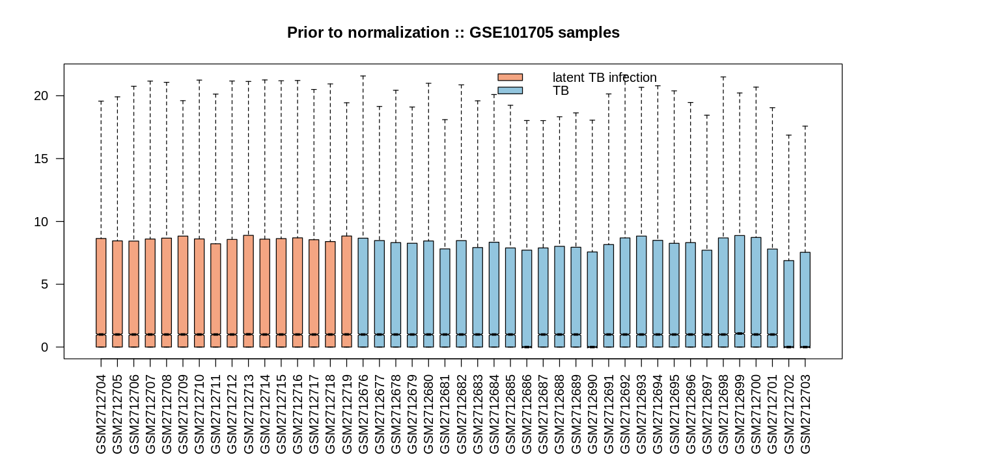

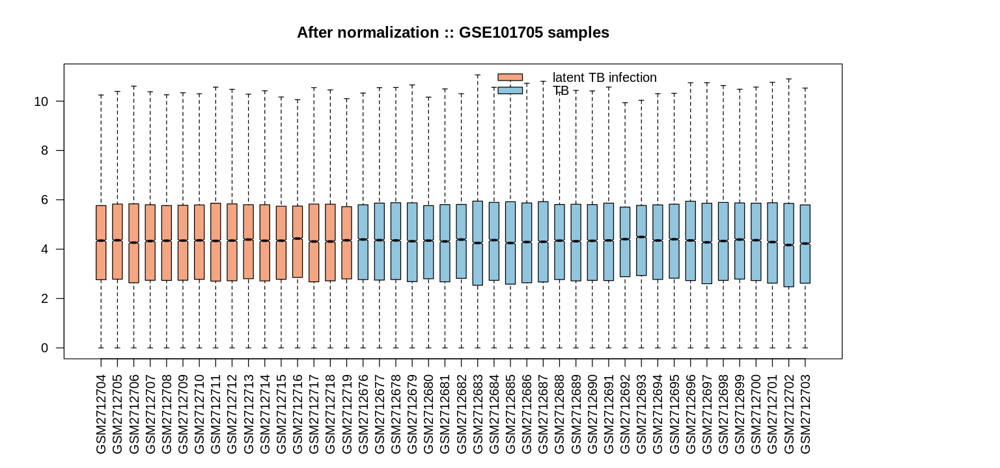

In [216]:
GSE_ID = "GSE101705"
def <- dataset_info(GSE_ID)
data <- seq_process_qc(GSE_ID,def$stage,rnaseq_data,norm_exp_data)

[1] "Diff expression analysis in LTBI-ATB"


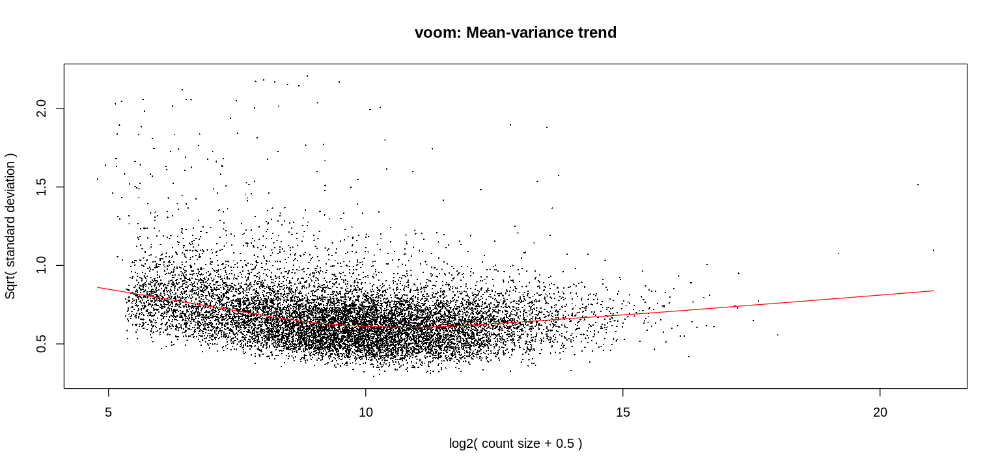

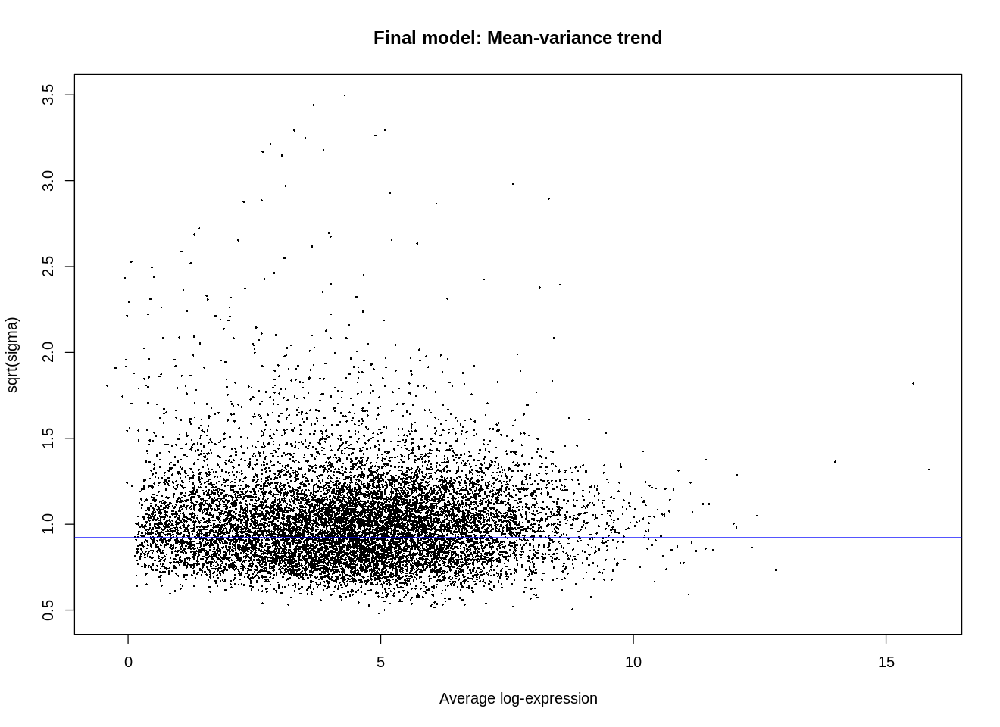

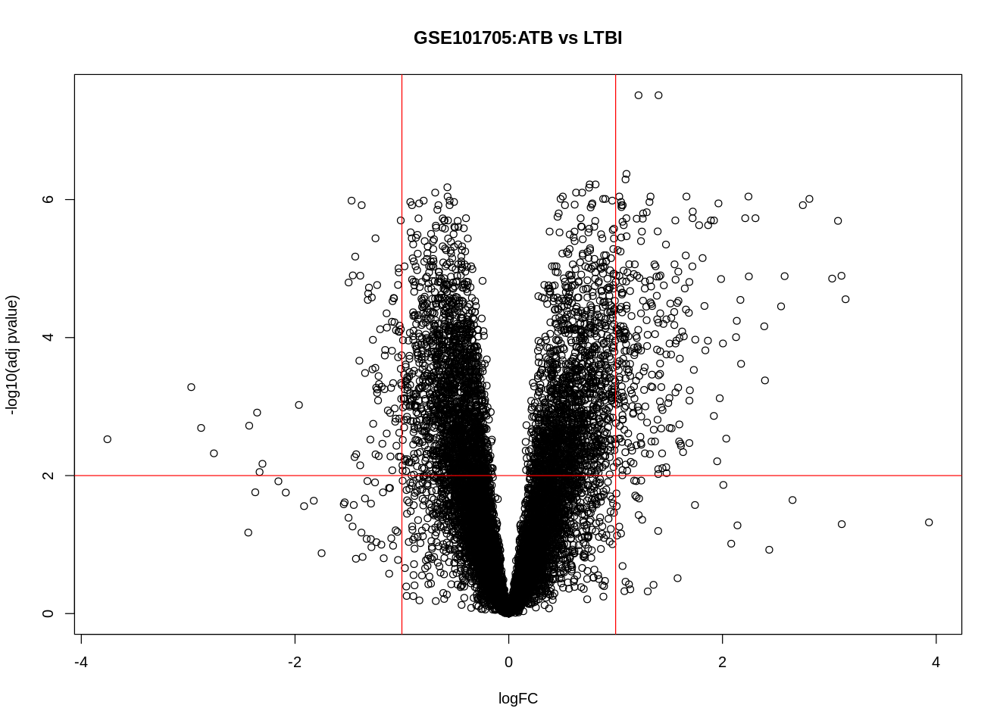

In [217]:
df <- diff_exp_seq_analysis(GSE_ID, data, def, diff_exp_data, norm_exp_data)
dsets <- rbind(dsets,df$dsets)

##### Dataset 27 -- GSE107993:  Leicester cohort - non-progressor individuals (Sequencing, GPL20301) [Combine two datasets together]
- Subjects: 138
- Disease status:  Control(n=69), LTBI(n=69)
- Disease status definition: 

Found 1 file(s)

GSE107993_series_matrix.txt.gz

Using locally cached version: /tmp/Rtmph8pCbI/GSE107993_series_matrix.txt.gz

Rows: 0 Columns: 139

── Column specification ────────────────────────────────────────────────────────
Delimiter: "\t"
chr (139): ID_REF, GSM2886136, GSM2886137, GSM2886138, GSM2886139, GSM288614...


ℹ Use `spec()` to retrieve the full column specification for this data.
ℹ Specify the column types or set `show_col_types = FALSE` to quiet this message.

Using locally cached version of GPL20301 found here:
/tmp/Rtmph8pCbI/GPL20301.soft 



          Length Class  Mode
GSE107993 1      -none- list
[1] "GSE107993_series_matrix.txt.gz"



Batch submitting query [===>---------------------------]  14% eta: 11s

Batch submitting query [========>----------------------]  29% eta: 10s

Batch submitting query [============>------------------]  43% eta:  6s

Batch submitting query [=================>-------------]  57% eta:  4s

Batch submitting query [=====================>---------]  71% eta:  3s

Batch submitting query [==========================>----]  86% eta:  1s
                                                                      

Warning message in bxp(list(stats = structure(c(0, 0, 0, 7.60564212127547, 17.8952667834023, :
“some notches went outside hinges ('box'): maybe set notch=FALSE”


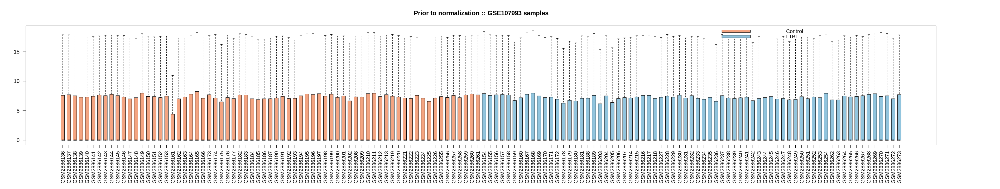

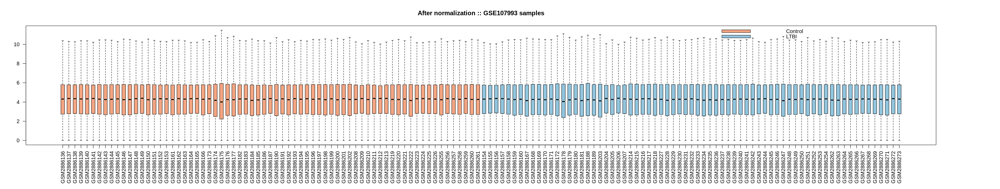

In [218]:
GSE_ID = "GSE107993"
def <- dataset_info(GSE_ID)
data <- seq_process_qc(GSE_ID,def$stage,rnaseq_data,norm_exp_data)

[1] "Diff expression analysis in HC-LTBI"


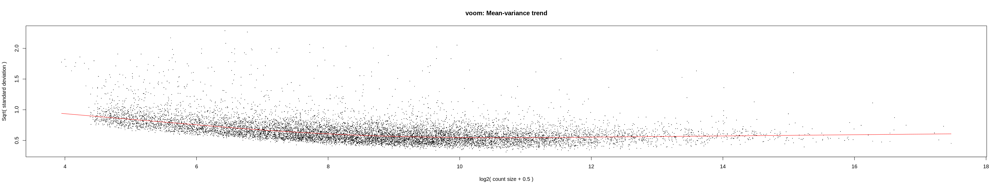

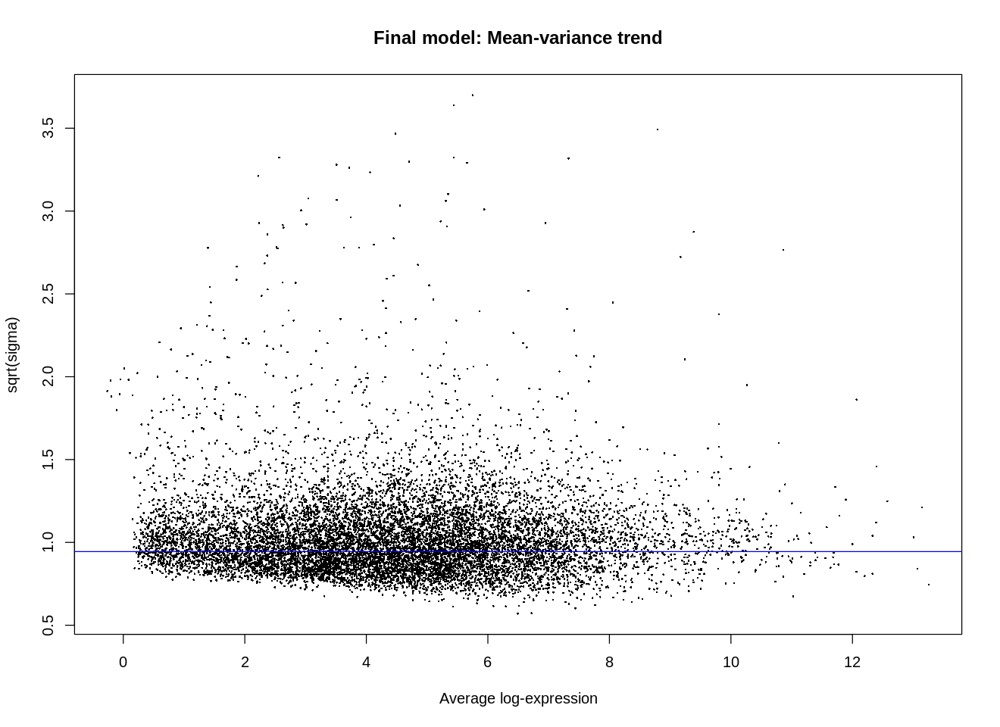

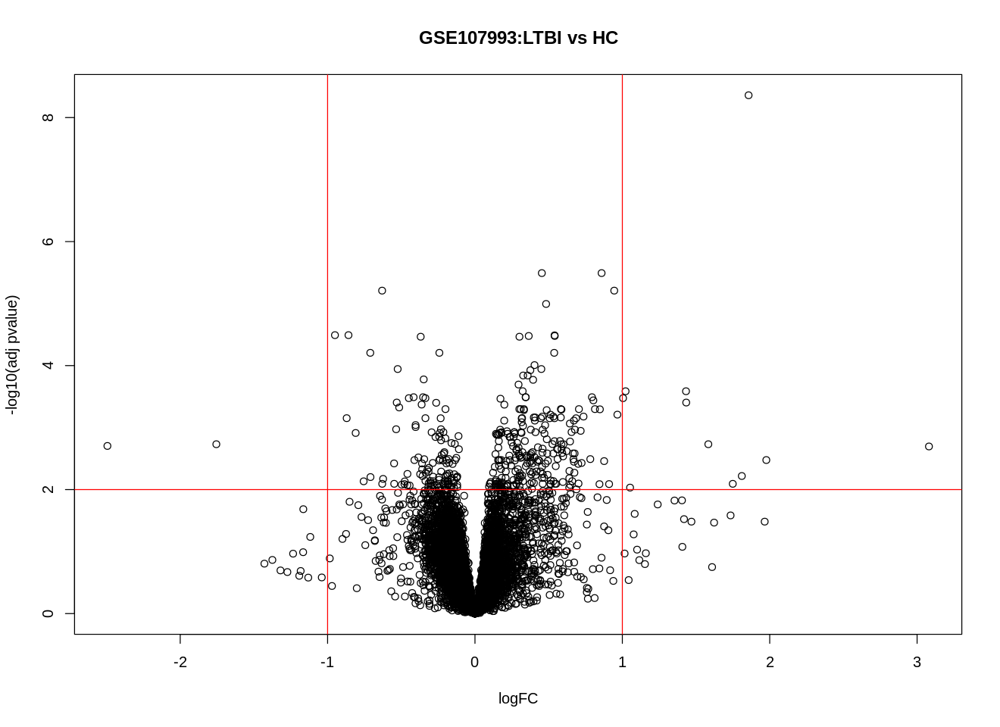

In [219]:
df <- diff_exp_seq_analysis(GSE_ID, data, def, diff_exp_data, norm_exp_data)
dsets <- rbind(dsets,df$dsets)

##### Dataset 28 -- GSE107994  Leicester cohort - progressor individuals (Sequencing, GPL20301)
- Subjects: 175
- Disease status:  Active_TB (n=53), LTBI_Progressor (n=23), Control (n=50), LTBI (n=49)
- Disease status definition: edgeR normalization
- Disease status definition: LTBI_Progressor samples is longitudnal datasets ranged from baseline (latent infection) to active TB diagnosed. Longitudinal data is in a low TB incidence setting.
- rawcount = *no*

Found 1 file(s)

GSE107994_series_matrix.txt.gz

Using locally cached version: /tmp/Rtmph8pCbI/GSE107994_series_matrix.txt.gz

Rows: 0 Columns: 176

── Column specification ────────────────────────────────────────────────────────
Delimiter: "\t"
chr (176): ID_REF, GSM2886274, GSM2886275, GSM2886276, GSM2886277, GSM288627...


ℹ Use `spec()` to retrieve the full column specification for this data.
ℹ Specify the column types or set `show_col_types = FALSE` to quiet this message.

Using locally cached version of GPL20301 found here:
/tmp/Rtmph8pCbI/GPL20301.soft 



          Length Class  Mode
GSE107994 1      -none- list
[1] "GSE107994_series_matrix.txt.gz"



Batch submitting query [===>---------------------------]  14% eta:  5s

Batch submitting query [========>----------------------]  29% eta:  4s

Batch submitting query [============>------------------]  43% eta:  4s

Batch submitting query [=================>-------------]  57% eta:  4s

Batch submitting query [=====================>---------]  71% eta:  3s

Batch submitting query [==========================>----]  86% eta:  2s
                                                                      

Warning message in bxp(list(stats = structure(c(0, 0, 0, 6.62935662007961, 16.4647733390933, :
“some notches went outside hinges ('box'): maybe set notch=FALSE”


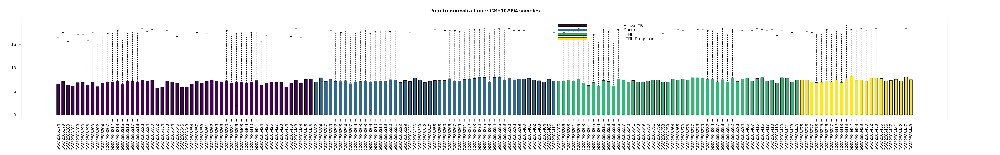

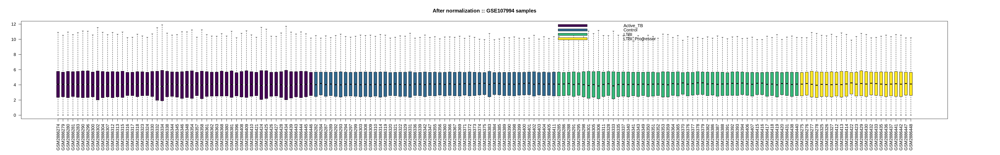

In [220]:
GSE_ID = "GSE107994"
def <- dataset_info(GSE_ID)
data <- seq_process_qc(GSE_ID,def$stage,rnaseq_data,norm_exp_data)

[1] "Diff expression analysis in HC-ATB"


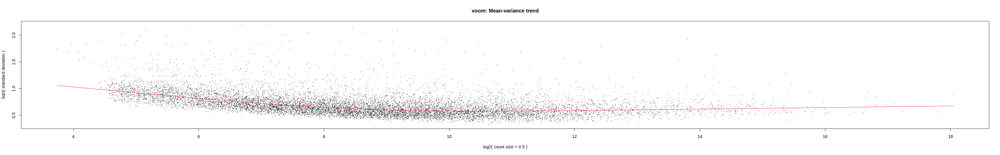

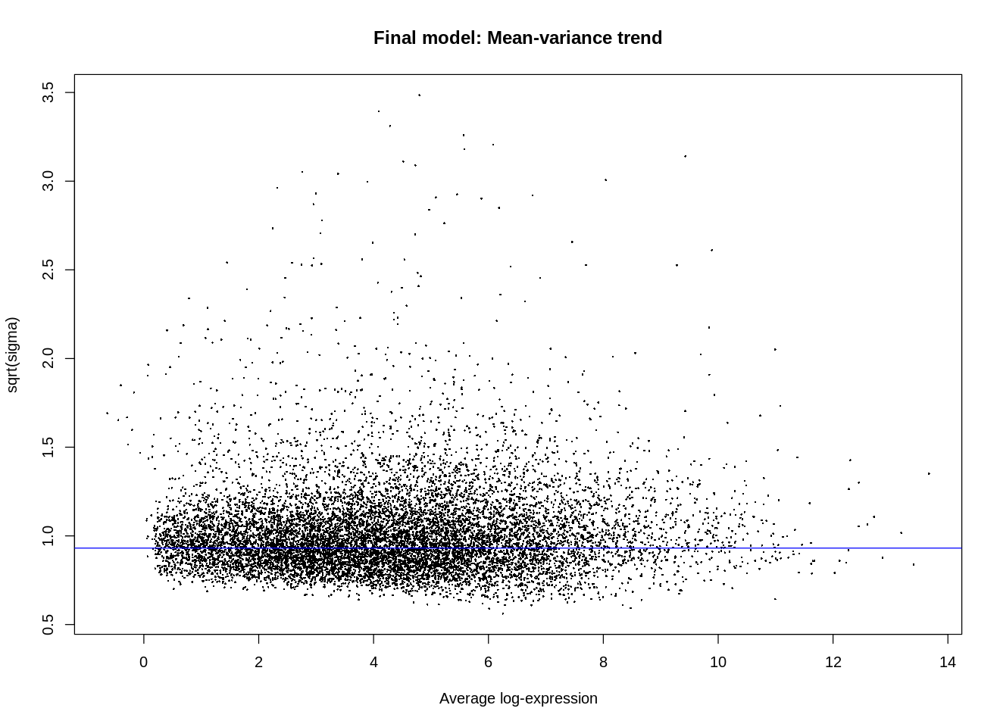

[1] "Diff expression analysis in LTBI-ATB"


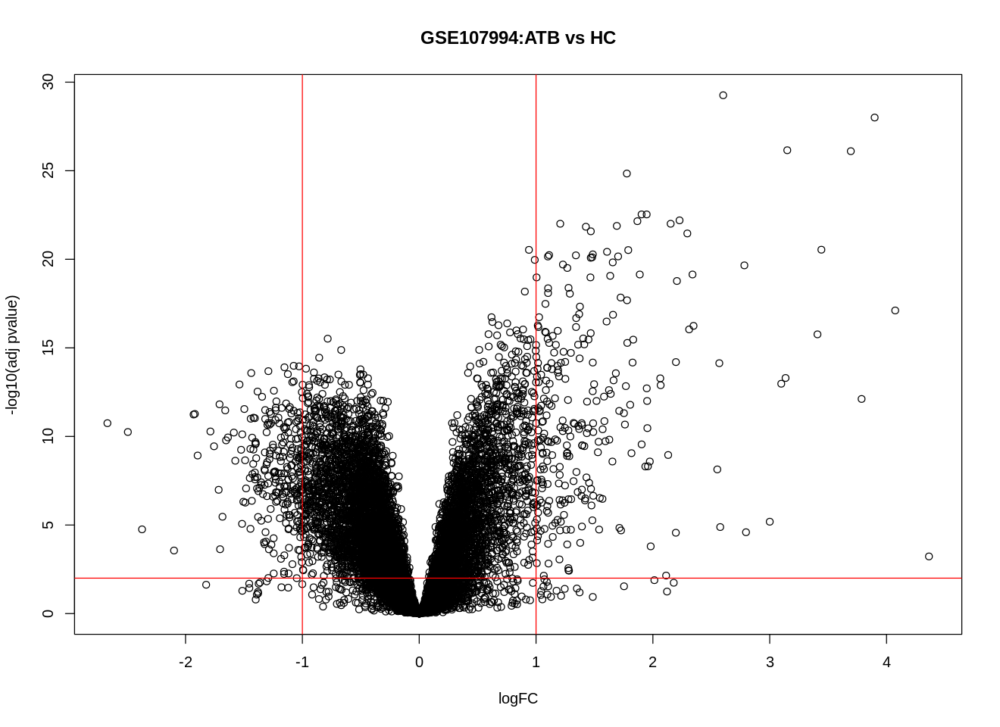

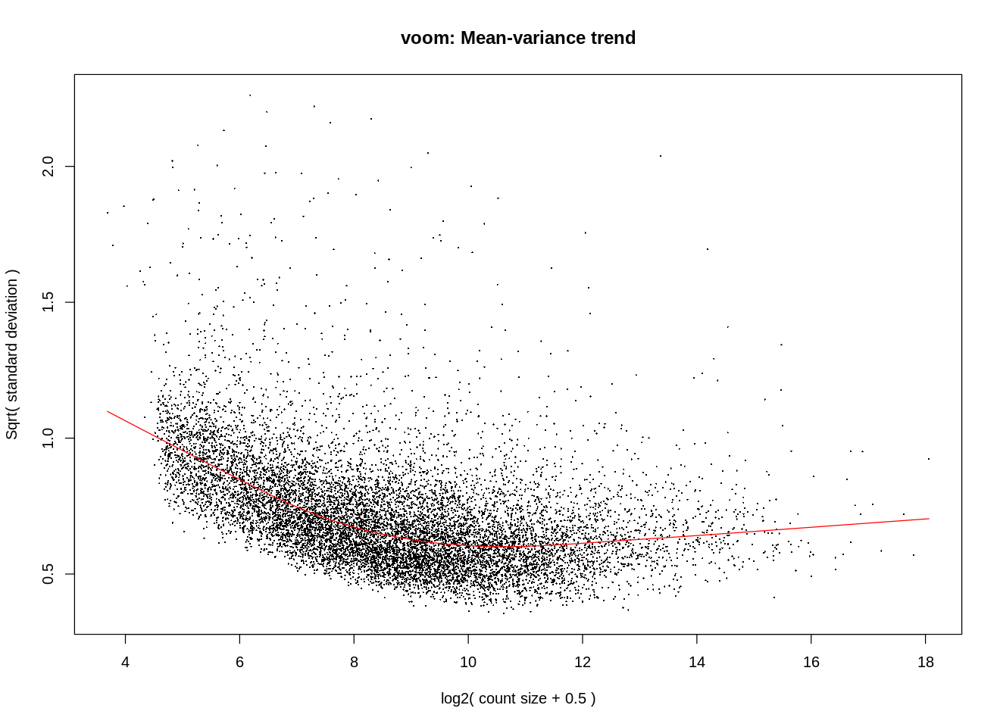

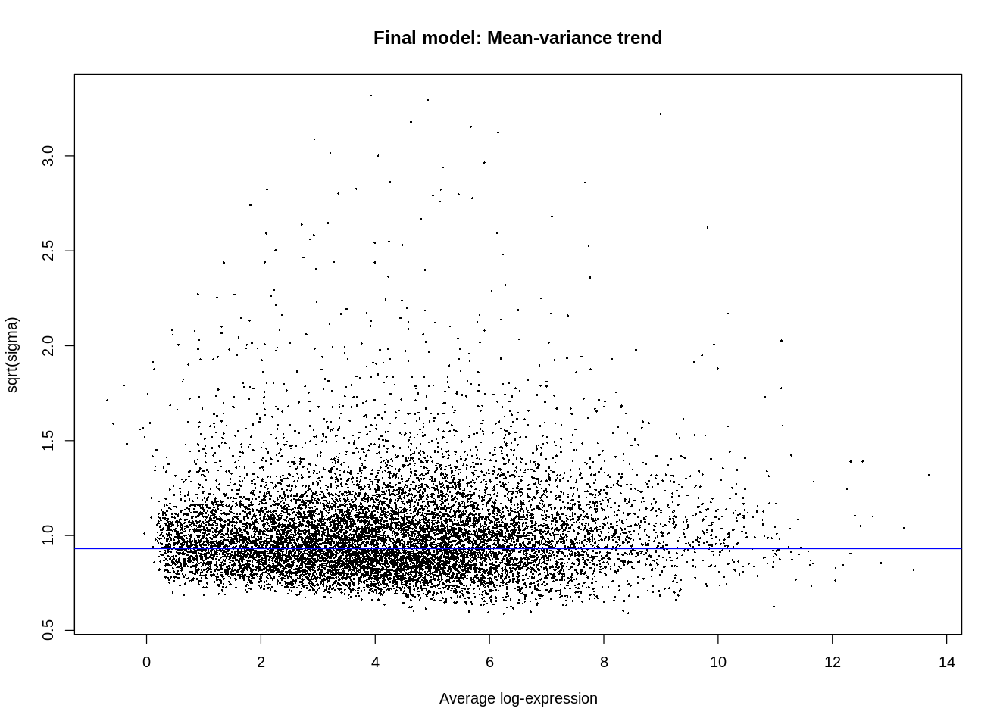

[1] "Diff expression analysis in HC-LTBI"


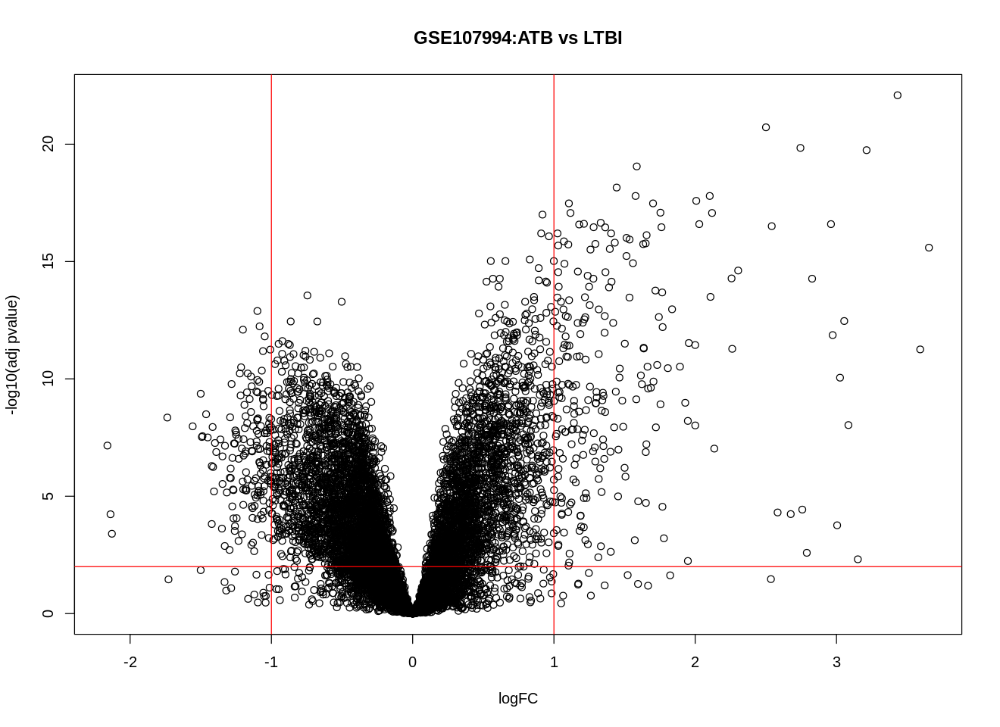

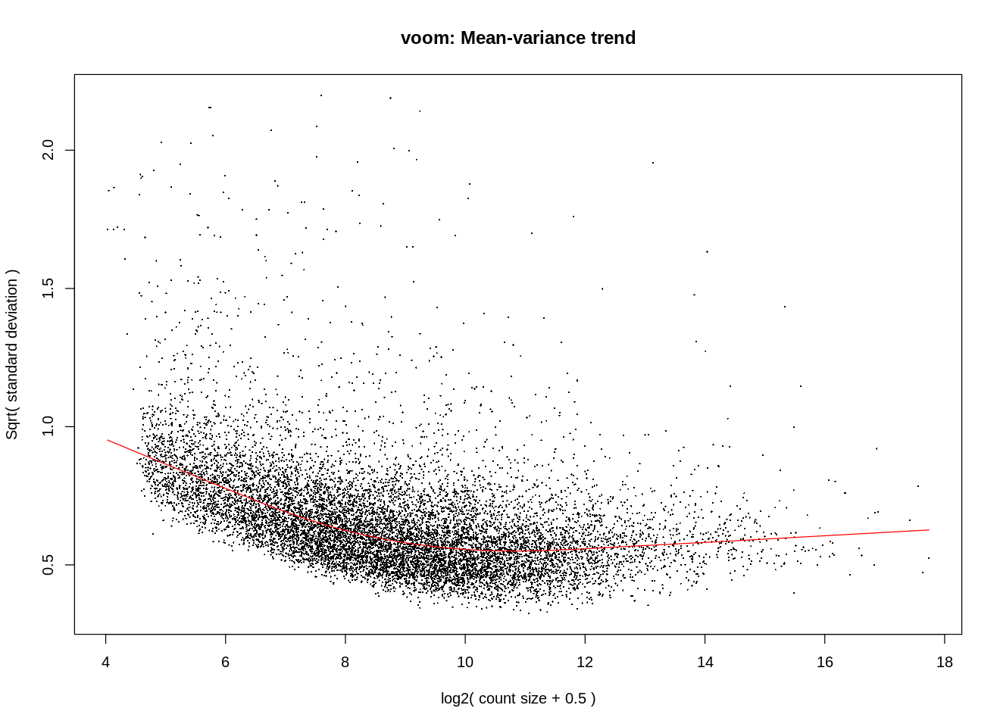

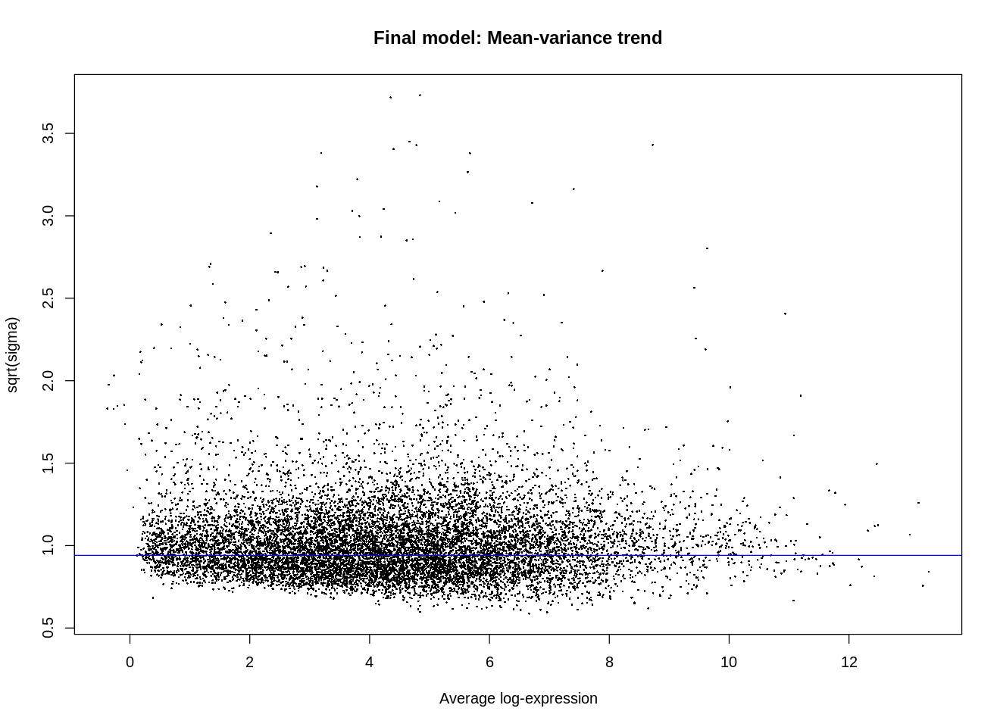

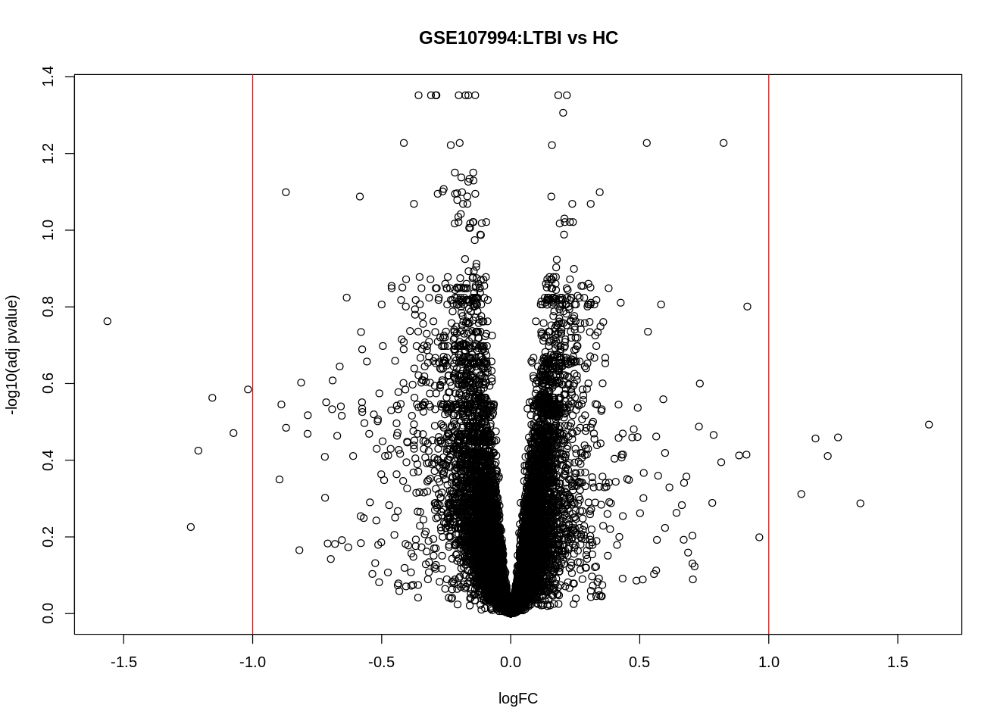

In [221]:
df <- diff_exp_seq_analysis(GSE_ID, data, def, diff_exp_data, norm_exp_data)
dsets <- rbind(dsets,df$dsets)

In [196]:
#Save the data list 
colnames(dsets) <- c('Compare','GSEID','Condition1','Condition2','Type','DF files')
write.csv(dsets, 'mega-data-list-model-building.csv')